In [739]:
import glob
import os
import time

import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch

from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.datasets import AirPassengersDataset, IceCreamHeaterDataset
from darts.metrics import mape
from darts.models import TFTModel
from darts.utils.likelihood_models import QuantileRegression
from darts.utils.statistics import check_seasonality, plot_acf
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from pytorch_lightning.utilities.model_summary import summarize


from sklearn.preprocessing import StandardScaler
from tqdm.auto import tqdm
from itertools import product
from typing import Optional


from darts import TimeSeries
from darts.dataprocessing.transformers import Scaler
from darts.metrics import mae, mase, rmse
from darts.models import (
    ARIMA,
    ExponentialSmoothing,
    KalmanForecaster,
    LightGBMModel,
    LinearRegressionModel,
    NaiveSeasonal,
    NBEATSModel,
    RandomForest,
    TransformerModel,
    RNNModel
)
from darts.utils.losses import SmapeLoss, MAELoss

warnings.filterwarnings("ignore")
import logging

logging.disable(logging.CRITICAL)

In [572]:
HORIZON = 12

In [573]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load and Preprocess data

In [574]:
folder_path = "results/2025-03-29_17-22-25/processed/"
csv_files = glob.glob(os.path.join(folder_path, '*.csv'))


In [575]:
def read_data(folder_path: str) -> list:
    csv_files = glob.glob(os.path.join(folder_path, '*.csv'))
    series = []
    count = 0
    for csv in csv_files:
        data = pd.read_csv(csv)
        data["Time"] = pd.to_datetime(data["Time"])
        data["time_idx"] = (data["Time"].astype(int) // 10**9) // 300
        data["time_idx"] -= data["time_idx"].min()
        data["hour"] = data["Time"].dt.hour
        data = data.drop(columns=["Time"])
        print(csv)
        print(count)
        count += 1
        series.append(TimeSeries.from_dataframe(data, time_col="time_idx"))
    return series

In [576]:
def train_val_split(series: list[TimeSeries], training_cutoff: float=0.8) -> list:
    ls_train = []
    ls_val = []
    for ts in series:
        train, val = ts.split_before(training_cutoff)
        ls_train.append(train)
        ls_val.append(val)
        

    return ls_train, ls_val 

In [577]:
def create_future_covariates(ts: TimeSeries):
    basal_insulin = ts['basal_insulin']
    hour = ts['hour']
    covariates = basal_insulin.stack(hour)
    return covariates

In [578]:
def create_past_covariates(ts: TimeSeries):
    bolus_insulin = ts["bolus_insulin"]
    cho = ts["CHO"]
    covariates = bolus_insulin.stack(cho)
    return covariates
    

In [579]:
series = read_data(folder_path)

results/2025-03-29_17-22-25/processed/child#004.csv
0
results/2025-03-29_17-22-25/processed/child#010.csv
1
results/2025-03-29_17-22-25/processed/adolescent#009.csv
2
results/2025-03-29_17-22-25/processed/adult#008.csv
3
results/2025-03-29_17-22-25/processed/child#005.csv
4
results/2025-03-29_17-22-25/processed/adult#002.csv
5
results/2025-03-29_17-22-25/processed/adolescent#004.csv
6
results/2025-03-29_17-22-25/processed/adolescent#006.csv
7
results/2025-03-29_17-22-25/processed/adult#009.csv
8
results/2025-03-29_17-22-25/processed/adult#007.csv
9
results/2025-03-29_17-22-25/processed/adolescent#003.csv
10
results/2025-03-29_17-22-25/processed/adult#001.csv
11
results/2025-03-29_17-22-25/processed/adolescent#001.csv
12
results/2025-03-29_17-22-25/processed/adolescent#010.csv
13
results/2025-03-29_17-22-25/processed/adult#006.csv
14
results/2025-03-29_17-22-25/processed/adult#005.csv
15
results/2025-03-29_17-22-25/processed/adult#010.csv
16
results/2025-03-29_17-22-25/processed/adolesc

In [580]:
future_covariates = [create_future_covariates(ts).astype(np.float32) for ts in series]
past_covariates = [create_past_covariates(ts).astype(np.float32) for ts in series]

In [582]:
max(cgm_series[1].values())

array([355.28135744])

## Train Test split

In [581]:
cgm_series = [ts["CGM"] for ts in series]
cgm_train, cgm_val = train_val_split(series=cgm_series, training_cutoff=0.9)
cgm_val = [ts[:-12] for ts in cgm_val]
future_cov_train, future_cov_val = train_val_split(series=future_covariates, training_cutoff=0.9)
past_cov_train , past_cov_val = train_val_split(series=past_covariates, training_cutoff=0.9)

In [610]:
last_train_time = future_cov_train[0].end_time()

# Ensure future_cov_train ends at last_train_time + HORIZON
for i in range(len(future_cov_train)):
    required_end = last_train_time + HORIZON
    current_end = future_cov_train[i].end_time()

    extension = future_cov_val[i].slice(
        start_ts=current_end + 1,
        end_ts=required_end 
    )
    future_cov_train[i] = future_cov_train[i].append(extension)


In [637]:
target_scaler = Scaler(global_fit=True)

In [638]:
cgm_train_transformed = target_scaler.fit_transform(cgm_train)
cgm_val_transformed = target_scaler.transform(cgm_val)
# cgm_series_transformerd = target_scaler.transform(cgm_series)

In [624]:
def scale_covariates(covariates: list):
    scaler = Scaler(StandardScaler())
    scaler.fit(covariates)
    return scaler.transform(covariates)

In [625]:
future_covariates_transformed_train = scale_covariates(future_cov_train)
future_covariates_transformed_val = scale_covariates(future_cov_val)

past_covariates_transformed_train = scale_covariates(past_cov_train)
past_covariates_transformed_val = scale_covariates(past_cov_val)

0
5
10
15
20
27


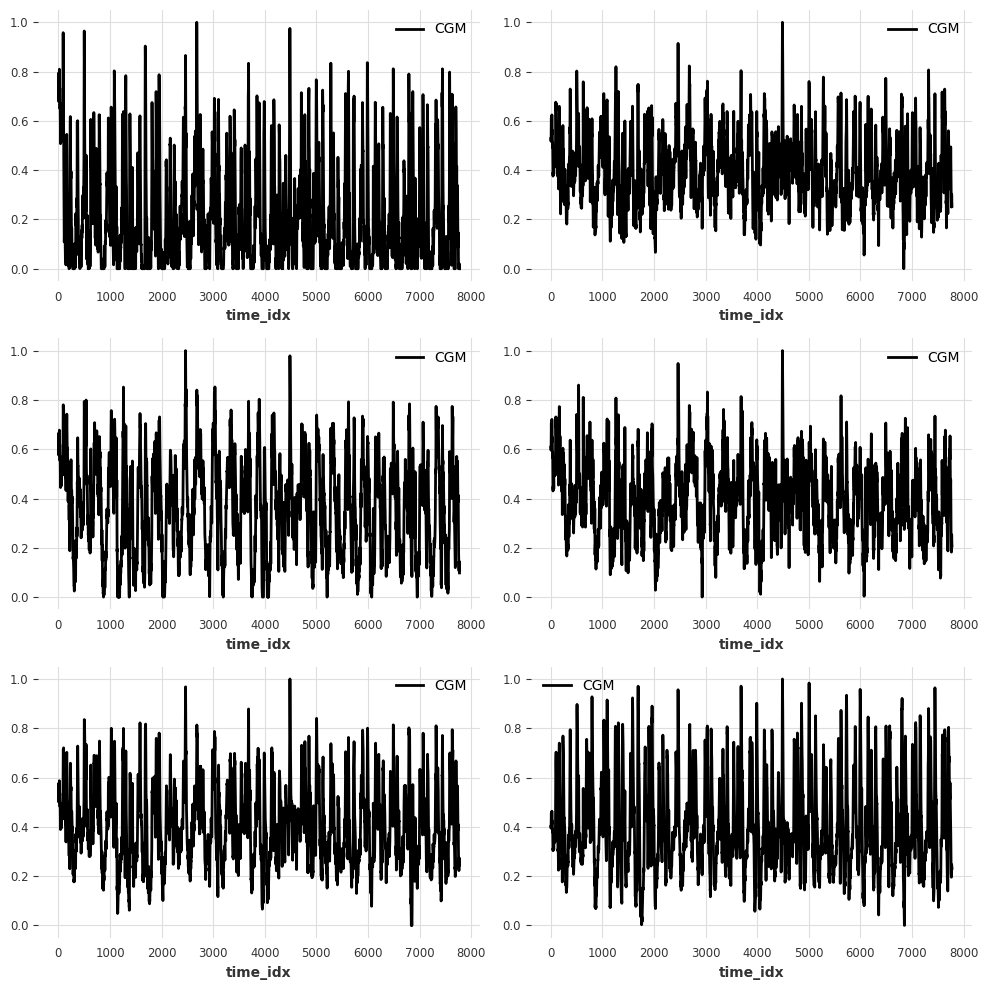

In [626]:
figure, ax = plt.subplots(3, 2, figsize=(10, 10), dpi=100)

for i, idx in enumerate([0, 5, 10, 15, 20, 27]):
    axis = ax[i % 3, i % 2]
    print(idx)
    cgm_train_transformed[idx].plot(ax=axis)
    axis.legend(cgm_train_transformed[idx].components)
    axis.set_title("")
plt.tight_layout()

# Model Evaluation

In [701]:
def clarke_error_grid(ref_values, pred_values, title_string):

    #Checking to see if the lengths of the reference and prediction arrays are the same
    assert (len(ref_values) == len(pred_values)), "Unequal number of values (reference : {}) (prediction : {}).".format(len(ref_values), len(pred_values))

    #Checks to see if the values are within the normal physiological range, otherwise it gives a warning
    if max(ref_values) > 400 or max(pred_values) > 400:
        print("Input Warning: the maximum reference value {} or the maximum prediction value {} exceeds the normal physiological range of glucose (<400 mg/dl).".format(max(ref_values), max(pred_values)))
    if min(ref_values) < 0 or min(pred_values) < 0:
        print("Input Warning: the minimum reference value {} or the minimum prediction value {} is less than 0 mg/dl.".format(min(ref_values),  min(pred_values)))

    #Clear plot
    plt.clf()

    #Set up plot
    plt.scatter(ref_values, pred_values, marker='o', color='black', s=8)
    plt.title(title_string + " Clarke Error Grid")
    plt.xlabel("Reference Concentration (mg/dl)")
    plt.ylabel("Prediction Concentration (mg/dl)")
    plt.xticks([0, 50, 100, 150, 200, 250, 300, 350, 400])
    plt.yticks([0, 50, 100, 150, 200, 250, 300, 350, 400])
    plt.gca().set_facecolor('white')

    #Set axes lengths
    plt.gca().set_xlim([0, 400])
    plt.gca().set_ylim([0, 400])
    plt.gca().set_aspect((400)/(400))

    #Plot zone lines
    plt.plot([0,400], [0,400], ':', c='black')                      #Theoretical 45 regression line
    plt.plot([0, 175/3], [70, 70], '-', c='black')
    #plt.plot([175/3, 320], [70, 400], '-', c='black')
    plt.plot([175/3, 400/1.2], [70, 400], '-', c='black')           #Replace 320 with 400/1.2 because 100*(400 - 400/1.2)/(400/1.2) =  20% error
    plt.plot([70, 70], [84, 400],'-', c='black')
    plt.plot([0, 70], [180, 180], '-', c='black')
    plt.plot([70, 290],[180, 400],'-', c='black')
    # plt.plot([70, 70], [0, 175/3], '-', c='black')
    plt.plot([70, 70], [0, 56], '-', c='black')                     #Replace 175.3 with 56 because 100*abs(56-70)/70) = 20% error
    # plt.plot([70, 400],[175/3, 320],'-', c='black')
    plt.plot([70, 400], [56, 320],'-', c='black')
    plt.plot([180, 180], [0, 70], '-', c='black')
    plt.plot([180, 400], [70, 70], '-', c='black')
    plt.plot([240, 240], [70, 180],'-', c='black')
    plt.plot([240, 400], [180, 180], '-', c='black')
    plt.plot([130, 180], [0, 70], '-', c='black')

    #Add zone titles
    plt.text(30, 15, "A", fontsize=15)
    plt.text(370, 260, "B", fontsize=15)
    plt.text(280, 370, "B", fontsize=15)
    plt.text(160, 370, "C", fontsize=15)
    plt.text(160, 15, "C", fontsize=15)
    plt.text(30, 140, "D", fontsize=15)
    plt.text(370, 120, "D", fontsize=15)
    plt.text(30, 370, "E", fontsize=15)
    plt.text(370, 15, "E", fontsize=15)

    #Statistics from the data
    zone = [0] * 5
    for i in range(len(ref_values)):
        if (ref_values[i] <= 70 and pred_values[i] <= 70) or (pred_values[i] <= 1.2*ref_values[i] and pred_values[i] >= 0.8*ref_values[i]):
            zone[0] += 1    #Zone A

        elif (ref_values[i] >= 180 and pred_values[i] <= 70) or (ref_values[i] <= 70 and pred_values[i] >= 180):
            zone[4] += 1    #Zone E

        elif ((ref_values[i] >= 70 and ref_values[i] <= 290) and pred_values[i] >= ref_values[i] + 110) or ((ref_values[i] >= 130 and ref_values[i] <= 180) and (pred_values[i] <= (7/5)*ref_values[i] - 182)):
            zone[2] += 1    #Zone C
        elif (ref_values[i] >= 240 and (pred_values[i] >= 70 and pred_values[i] <= 180)) or (ref_values[i] <= 175/3 and pred_values[i] <= 180 and pred_values[i] >= 70) or ((ref_values[i] >= 175/3 and ref_values[i] <= 70) and pred_values[i] >= (6/5)*ref_values[i]):
            zone[3] += 1    #Zone D
        else:
            zone[1] += 1    #Zone B

    return plt, zone


def evaluate_clarke_error(predictions, actuals, scaler, model_name="model", save_file=None):
    all_predicted = []
    all_actual = []

    for pred_series, actual_series in zip(predictions, actuals):
        # actual_matched = actual_series[:len(pred_series)]
        actual_matched = actual_series.slice_intersect(pred_series)
        
        pred_unscaled = scaler.inverse_transform(pred_series)
        actual_unscaled = scaler.inverse_transform(actual_matched)
        
        all_predicted.extend(pred_unscaled.values().flatten())
        all_actual.extend(actual_unscaled.values().flatten())

    all_actual = np.array(all_actual)
    all_predicted = np.array(all_predicted)

    # clarke_zones = zone_accuracy(all_actual, all_predicted, mode='clarke')
    # zone_names = ['A', 'B', 'C', 'D', 'E']

    print(f"\nClarke Error Grid for {model_name}:")
    plt, clarke_zones = clarke_error_grid(all_actual, all_predicted, model_name)
    sum_zones = sum(clarke_zones)
    for i, zone in enumerate(zone_names):
        result_str = f"Zone {zone}: {(clarke_zones[i] / sum_zones )*100:.2f}%"
        print(result_str)
        if save_file:
            save_file.write(result_str + "\n")
    
    return plt, clarke_zones


In [708]:
def eval_local_model(
    train_series: list[TimeSeries], test_series: list[TimeSeries], model_cls, **kwargs
) -> tuple[list[float], float]:
    preds = []
    start_time = time.time()
    for series in tqdm(train_series):
        model = model_cls(**kwargs)
        model.fit(series)
        pred = model.predict(n=HORIZON)
        preds.append(pred)
    elapsed_time = time.time() - start_time
    # stripped_test_ts = [test_series[i].slice_intersect(preds[i]) for i in range(len(test_series))]
    stripped_test_ts = [ i[:12] for i in test_series]
    
    maes = eval_forecasts_mae(preds, stripped_test_ts)
    rmses = eval_forecasts_rmse(preds, stripped_test_ts)
    
    return maes, rmses, elapsed_time, preds

# Simple Models

## naive seasonal K=12

  0%|          | 0/28 [00:00<?, ?it/s]

computing MAEs...


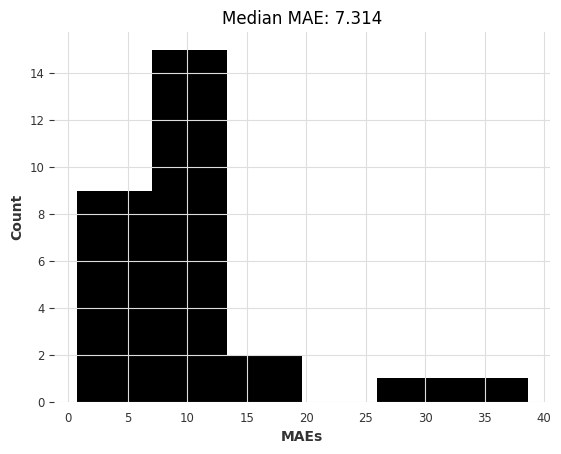

computing RMSEs...


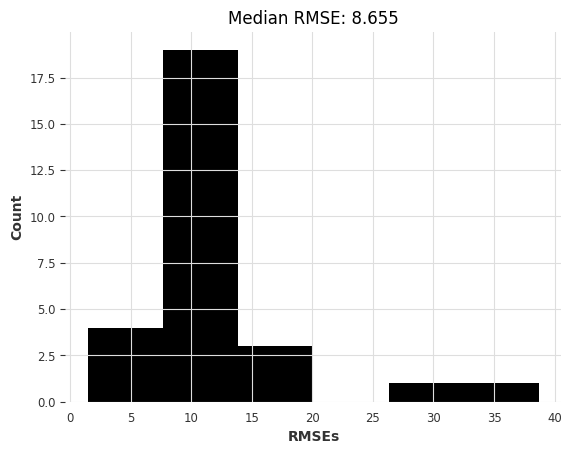


Clarke Error Grid for naive12:
Zone A: 85.12%
Zone B: 2.68%
Zone C: 0.00%
Zone D: 12.20%
Zone E: 0.00%


(<module 'matplotlib.pyplot' from '/home/smitsis/glucose_level_prediction/.venv/lib/python3.10/site-packages/matplotlib/pyplot.py'>,
 [286, 9, 0, 41, 0])

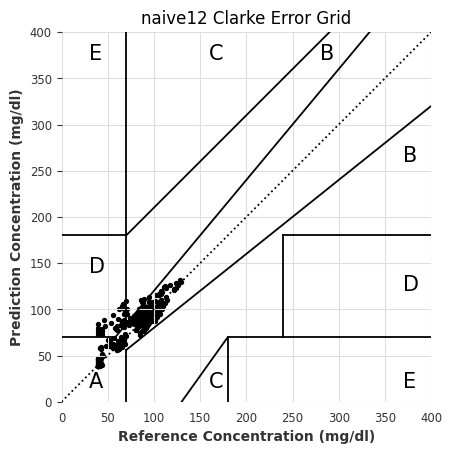

In [707]:
naive12_maes, naive12_rmses, naive12_time, naive12_preds = eval_local_model(cgm_train_transformed, cgm_val_transformed, NaiveSeasonal, K=12)

evaluate_clarke_error(naive12_preds, cgm_val_transformed, target_scaler, model_name="naive12")

## Explonential Smoothing

  0%|          | 0/28 [00:00<?, ?it/s]

computing MAEs...


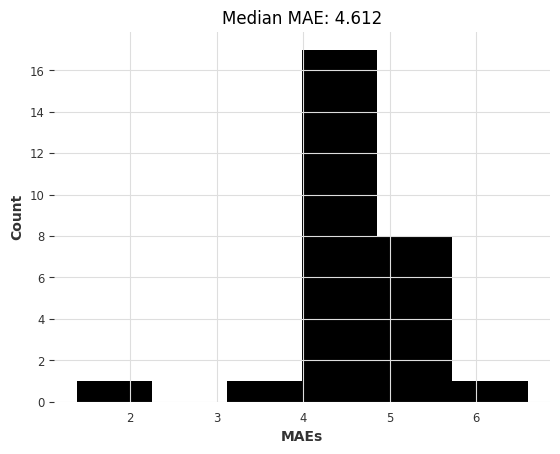

computing RMSEs...


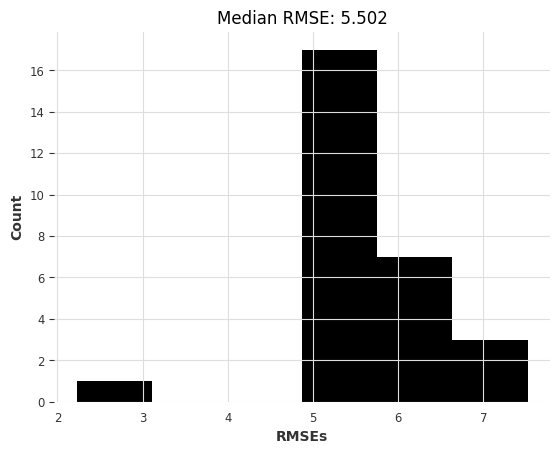


Clarke Error Grid for ets:
Zone A: 100.00%
Zone B: 0.00%
Zone C: 0.00%
Zone D: 0.00%
Zone E: 0.00%


(<module 'matplotlib.pyplot' from '/home/smitsis/glucose_level_prediction/.venv/lib/python3.10/site-packages/matplotlib/pyplot.py'>,
 [336, 0, 0, 0, 0])

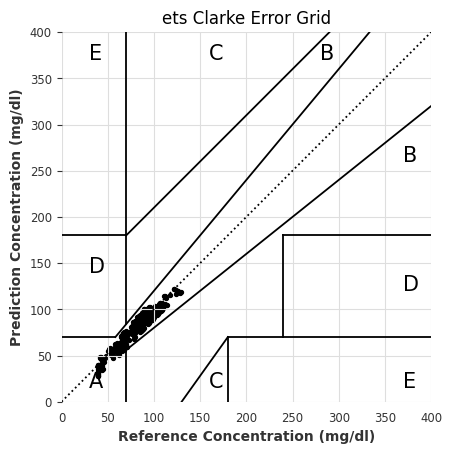

In [710]:
ets_maes, ets_rmses, ets_time, ets_preds = eval_local_model(cgm_train_transformed, cgm_val_transformed, ExponentialSmoothing)

evaluate_clarke_error(ets_preds, cgm_val_transformed, target_scaler, model_name="ets")

## ARIMA

  0%|          | 0/28 [00:00<?, ?it/s]

computing MAEs...


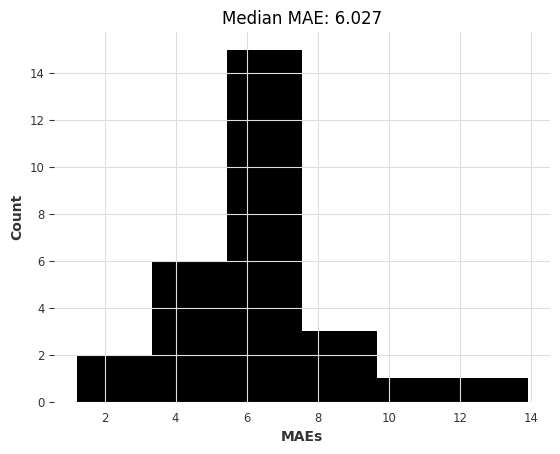

computing RMSEs...


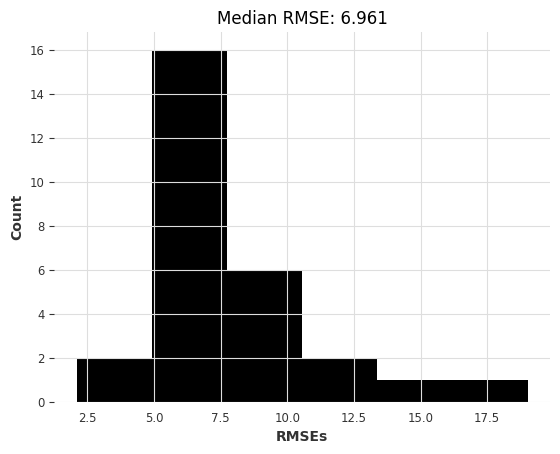


Clarke Error Grid for ARIMA:
Zone A: 94.35%
Zone B: 0.89%
Zone C: 0.00%
Zone D: 4.76%
Zone E: 0.00%


(<module 'matplotlib.pyplot' from '/home/smitsis/glucose_level_prediction/.venv/lib/python3.10/site-packages/matplotlib/pyplot.py'>,
 [317, 3, 0, 16, 0])

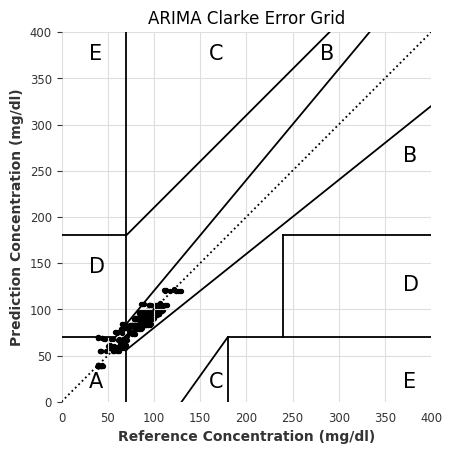

In [712]:
warnings.filterwarnings("ignore")
arima_maes, arima_rmses, arima_time, arima_preds = eval_local_model(cgm_train_transformed, cgm_val_transformed, ARIMA, p=12, d=1, q=1)

evaluate_clarke_error(arima_preds, cgm_val_transformed, target_scaler, model_name="ARIMA")

## Kalman Filter

  0%|          | 0/28 [00:00<?, ?it/s]

computing MAEs...


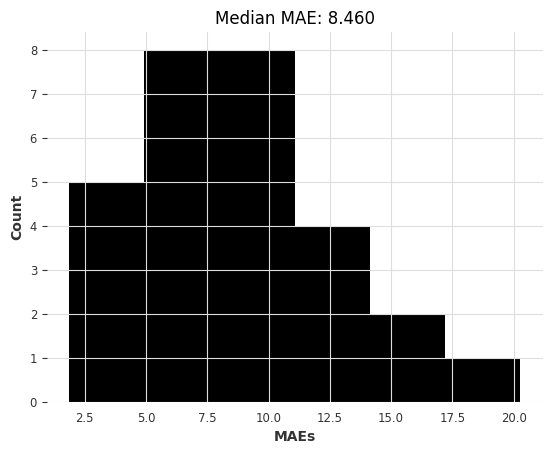

computing RMSEs...


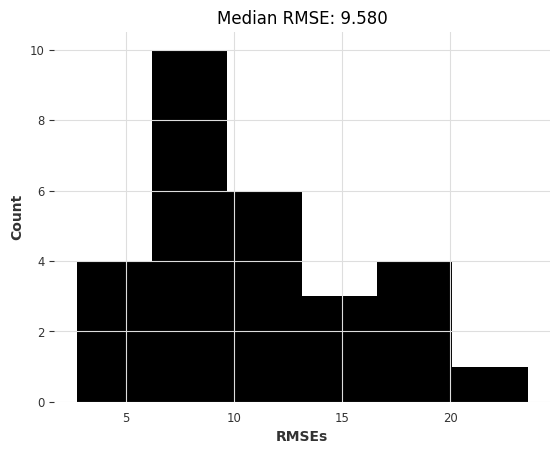


Clarke Error Grid Analysis:
Zone A: 93.75%
Zone B: 0.60%
Zone C: 0.00%
Zone D: 5.65%
Zone E: 0.00%


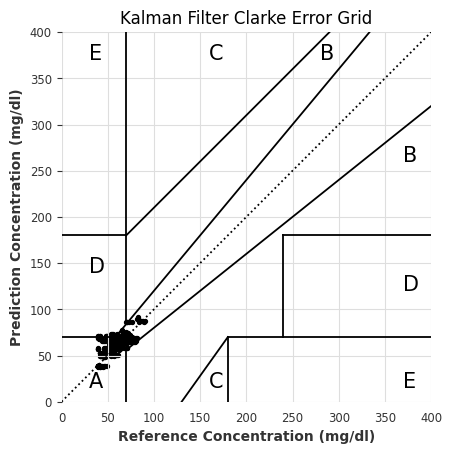

In [401]:
kf_maes, kf_rmses, kf_time, kf_preds = eval_local_model(cgm_train_transformed, cgm_val_transformed, KalmanForecaster, dim_x=12)

evaluate_clarke_error(kf_preds, cgm_val_transformed, target_scaler, model_name="Kalman Filter")

# Plotting Models

In [713]:
def plot_models(method_to_elapsed_times, method_to_maes, loss):
    shapes = ["o", "s", "*"]
    colors = ["tab:blue", "tab:orange", "tab:green", "tab:red", "tab:purple"]
    styles = list(product(shapes, colors))

    plt.figure(figsize=(6, 6), dpi=100)
    for i, method in enumerate(method_to_elapsed_times.keys()):
        t = method_to_elapsed_times[method]
        s = styles[i]
        plt.semilogx(
            [t],
            [np.median(method_to_maes[method])],
            s[0],
            color=s[1],
            label=method,
            markersize=13,
        )
    plt.xlabel("elapsed time [s]")
    plt.ylabel(f"median {loss} over all series")
    plt.legend(bbox_to_anchor=(1.4, 1.0), frameon=True)

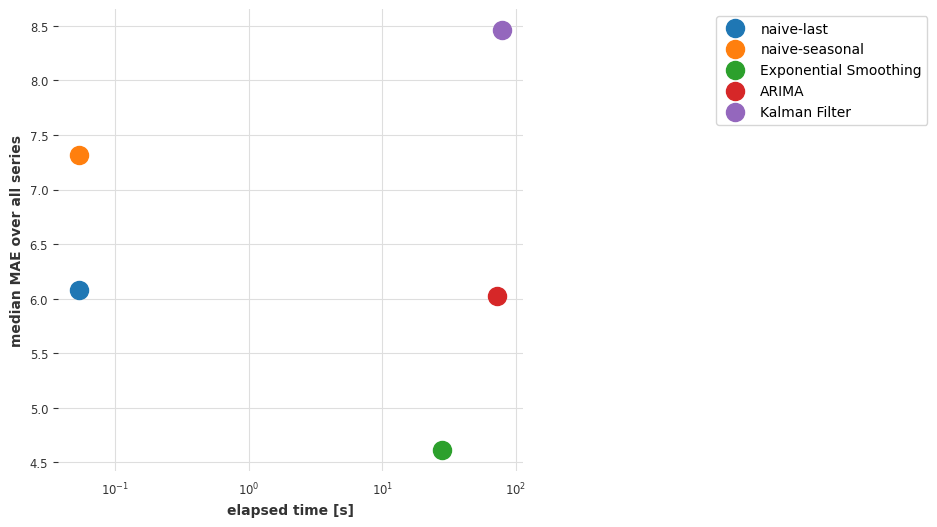

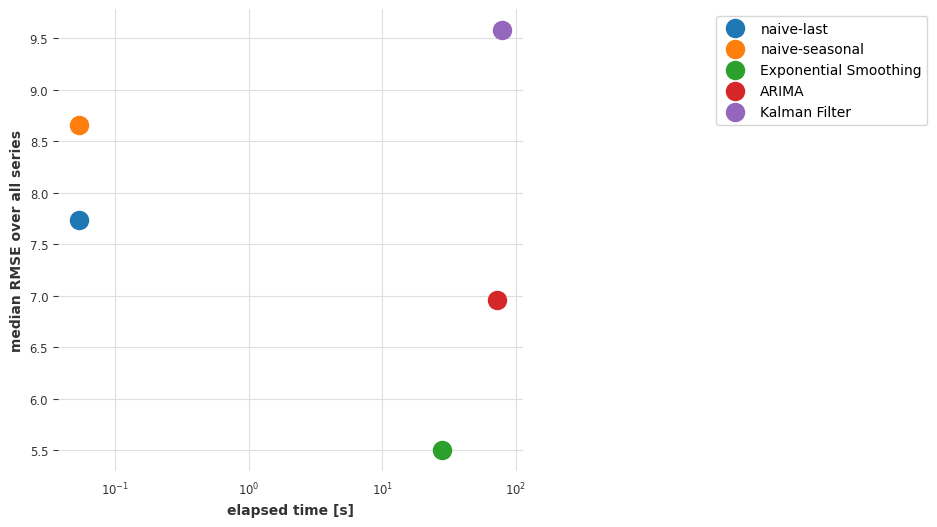

In [714]:
maes = {
    "naive-last": naive1_maes,
    "naive-seasonal": naive12_maes,
    "Exponential Smoothing": ets_maes,
    "ARIMA": arima_maes,
    "Kalman Filter": kf_maes,
}
rmses = {
    "naive-last": naive1_rmses,
    "naive-seasonal": naive12_rmses,
    "Exponential Smoothing": ets_rmses,
    "ARIMA": arima_rmses,
    "Kalman Filter": kf_rmses,
}

elapsed_times = {
    "naive-last": naive1_time,
    "naive-seasonal": naive12_time,
    "Exponential Smoothing": ets_time,
    "ARIMA": arima_time,
    "Kalman Filter": kf_time,
}

plot_models(elapsed_times, maes, "MAE")
plot_models(elapsed_times, rmses, "RMSE")

# Eval global Models

In [407]:
def eval_global_model(
    train_series: list[TimeSeries], test_series: list[TimeSeries], model_cls, **kwargs
) -> tuple[list[float], float]:
    start_time = time.time()

    model = model_cls(**kwargs)
    model.fit(train_series)
    preds = model.predict(n=HORIZON, series=train_series)

    elapsed_time = time.time() - start_time

    maes = eval_forecasts_mae(preds, test_series)
    rmses = eval_forecasts_rmse(preds, test_series)
    return maes, rmses, elapsed_time, preds

computing MAEs...


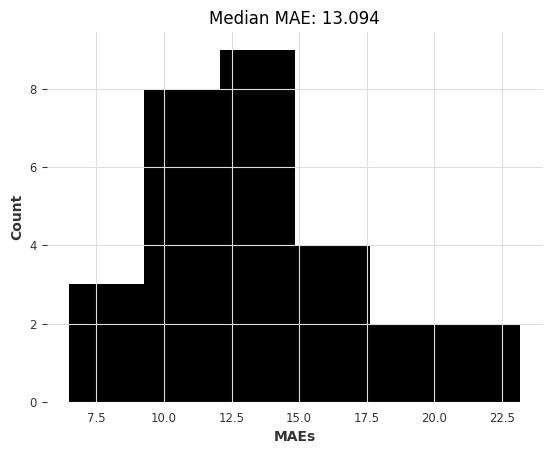

computing RMSEs...


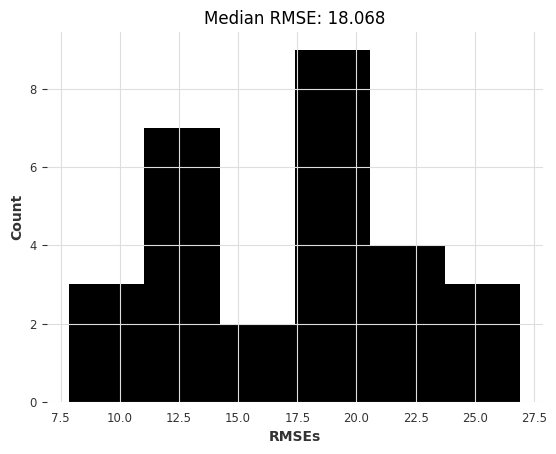


Clarke Error Grid Analysis:
Zone A: 74.70%
Zone B: 0.60%
Zone C: 0.00%
Zone D: 24.70%
Zone E: 0.00%


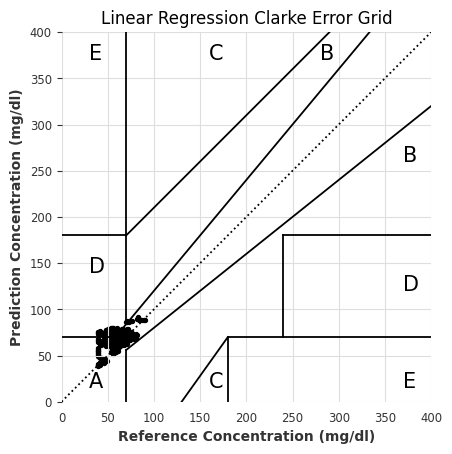

In [408]:
lr_maes, lr_rmses, lr_time, lr_preds = eval_global_model(
    cgm_train_transformed, cgm_val_transformed, LinearRegressionModel, lags=72, output_chunk_length=12
)

evaluate_clarke_error(lr_preds, cgm_val_transformed, target_scaler, model_name="Linear Regression")

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 18360
[LightGBM] [Info] Number of data points in the train set: 215404, number of used features: 72
[LightGBM] [Info] Start training from score 0.357683
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023144 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 18360
[LightGBM] [Info] Number of data points in the train set: 215404, number of used features: 72
[LightGBM] [Info] Start training from score 0.357632
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019636 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 18360
[LightGBM] [Info] Number of data points in the train set: 215404, number of used features: 72
[LightGBM] [Info] Sta

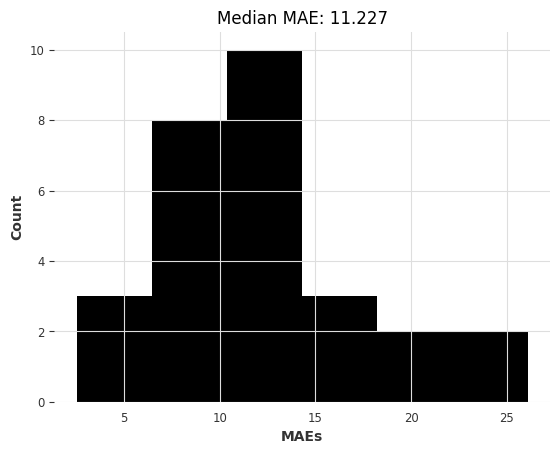

computing RMSEs...


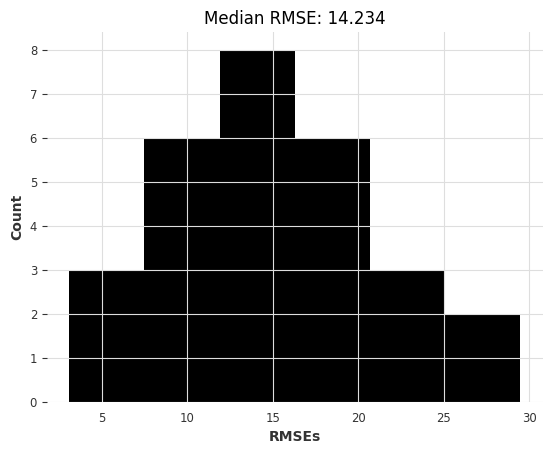


Clarke Error Grid Analysis:
Zone A: 85.12%
Zone B: 0.89%
Zone C: 0.00%
Zone D: 13.99%
Zone E: 0.00%


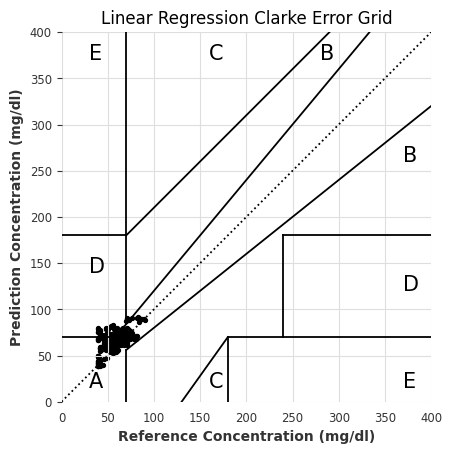

In [409]:
lgbm_maes, lgbm_rmses, lgbm_time, lgbm_preds = eval_global_model(
    cgm_train_transformed, cgm_val_transformed, LightGBMModel, lags=72, output_chunk_length=12, objective="mae"
)

evaluate_clarke_error(lgbm_preds, cgm_val_transformed, target_scaler, model_name="Linear Regression")

# N-BEATS

In [728]:
NUM_STACKS = 20
NUM_BLOCKS = 1
NUM_LAYERS = 2
LAYER_WIDTH = 136
COEFFS_DIM = 11

# training settings:
LR = 1e-3
BATCH_SIZE = 1024
MAX_SAMPLES_PER_TS = 10
NUM_EPOCHS = 10

In [734]:
np.random.seed(42)
torch.manual_seed(42)

start_time = time.time()

nbeats_model= NBEATSModel(
    input_chunk_length=input_chunk_length,
    output_chunk_length=forecast_horizon,
    log_tensorboard=True,
    model_name="2025-04-15-14-35-NBEATS",
    batch_size=128,
    optimizer_kwargs={"lr": LR},
    pl_trainer_kwargs={
        "enable_progress_bar": True,
    },
)

nbeats_model.fit(
    series=cgm_train_transformed, 
    past_covariates=past_covariates_transformed_train,
    val_past_covariates=past_covariates_transformed_val,
    val_series=cgm_val_transformed,
    dataloader_kwargs={"num_workers": 4}, 
    epochs=NUM_EPOCHS
    
)

Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

NBEATSModel(output_chunk_shift=0, generic_architecture=True, num_stacks=30, num_blocks=1, num_layers=4, layer_widths=256, expansion_coefficient_dim=5, trend_polynomial_degree=2, dropout=0.0, activation=ReLU, input_chunk_length=72, output_chunk_length=12, log_tensorboard=True, model_name=2025-04-15-14-35-NBEATS, batch_size=128, optimizer_kwargs={'lr': 0.001}, pl_trainer_kwargs={'enable_progress_bar': True})

In [ ]:
print(summarize(nbeats_model.model))
nbeats_model.save("nbeats_model_10_epochs")

Predicting: |                                                                                                 …

computing MAEs...


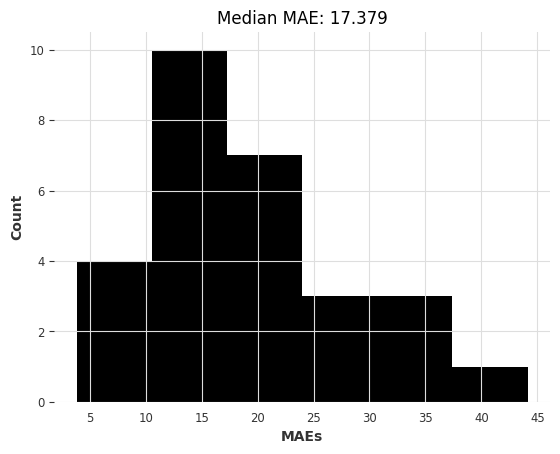

computing RMSEs...


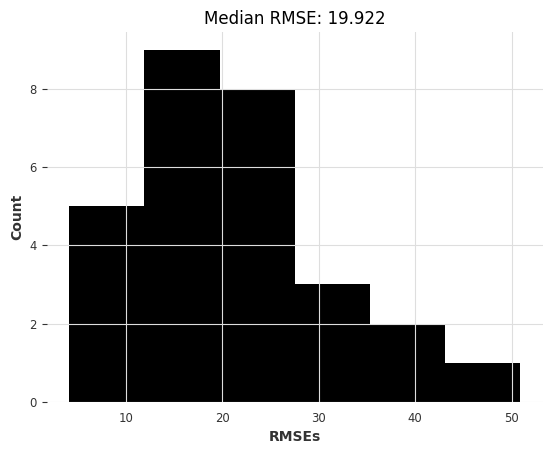


Clarke Error Grid Analysis:
Zone A: 85.12%
Zone B: 0.89%
Zone C: 0.00%
Zone D: 13.99%
Zone E: 0.00%


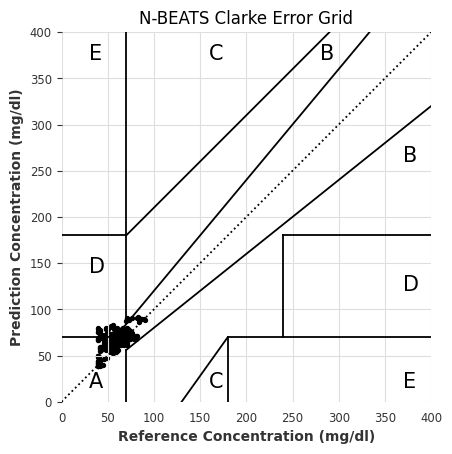

In [411]:
nb_preds = nbeats_model.predict(series=cgm_train_transformed, n=HORIZON)
nbeats_elapsed_time = time.time() - start_time

nbeats_maes = eval_forecasts_mae(nb_preds, cgm_val_transformed)
nbeats_rmses = eval_forecasts_rmse(nb_preds, cgm_val_transformed)

evaluate_clarke_error(lgbm_preds, cgm_val_transformed, target_scaler, model_name="N-BEATS")

# LSTM

In [749]:
lstm = RNNModel(
    input_chunk_length=input_chunk_length,
    output_chunk_length=12,
    model="LSTM",
    model_name="2025-04-15-15-33-LSTM",
    random_state=42,
    log_tensorboard=True,
    training_length=72 * 2,
    n_epochs = 10
)

lstm.fit(
    series=cgm_train_transformed,
    val_series=cgm_val_transformed,
    verbose=True
)

Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

RNNModel(model=LSTM, hidden_dim=25, n_rnn_layers=1, dropout=0.0, training_length=144, input_chunk_length=72, output_chunk_length=12, model_name=2025-04-15-15-33-LSTM, random_state=42, log_tensorboard=True, n_epochs=10)

# Transformer

In [674]:
transformer = TransformerModel(
    input_chunk_length=72,
    output_chunk_length=12,
    n_epochs=20,
    log_tensorboard=True
)
transformer.fit(
    series=cgm_train_transformed,
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_train,
    val_past_covariates=past_covariates_transformed_val,
    dataloader_kwargs={"num_workers": 4},
    verbose=True
)

Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

TransformerModel(output_chunk_shift=0, d_model=64, nhead=4, num_encoder_layers=3, num_decoder_layers=3, dim_feedforward=512, dropout=0.1, activation=relu, norm_type=None, custom_encoder=None, custom_decoder=None, input_chunk_length=72, output_chunk_length=12, n_epochs=20, log_tensorboard=True)

In [676]:
transformer.save()

Predicting: |                                                                                                 …

computing MAEs...


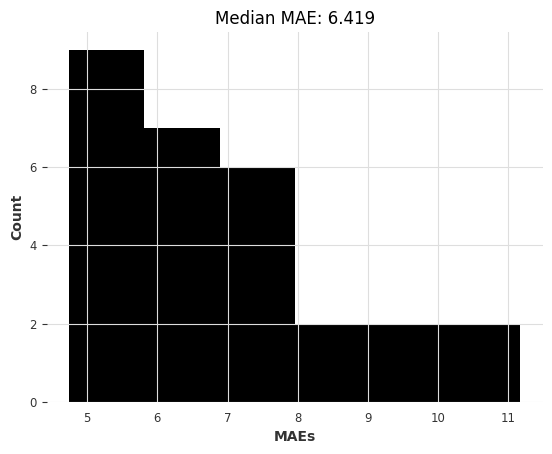

computing RMSEs...


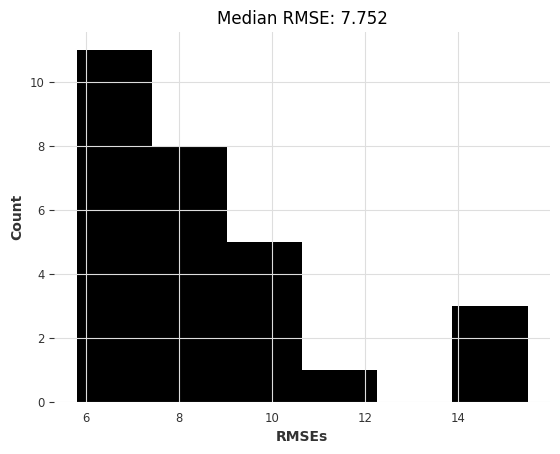


Clarke Error Grid for Temporal Fusion Transformer:
Zone A: 48.21%
Zone B: 32.44%
Zone C: 0.00%
Zone D: 19.35%
Zone E: 0.00%


[162, 109, 0, 65, 0]

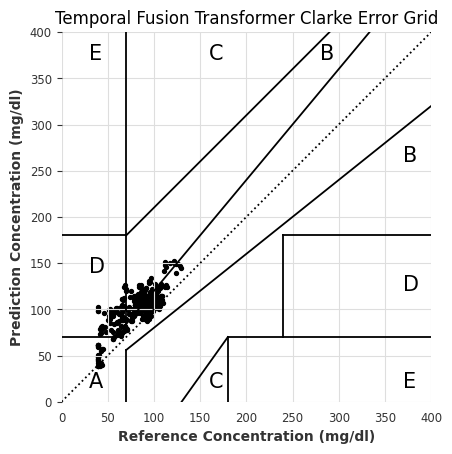

In [677]:
start_time = time.time()
ts_preds = transformer.predict(
    series=cgm_train_transformed,
    past_covariates=past_covariates_transformed_train,
    n=HORIZON)
ts_elapsed_time = time.time() - start_time
ts_maes = eval_forecasts_mae(ts_preds, cgm_val_transformed)
ts_rmses = eval_forecasts_rmse(ts_preds, cgm_val_transformed)

evaluate_clarke_error(lgbm_preds, cgm_val_transformed, target_scaler, model_name="Temporal Fusion Transformer")

In [90]:
tft = TFTModel.load("TFTModel_2025-04-11_15_49_49.pt")

In [121]:
cgm_val_transformed[0].time_index

RangeIndex(start=7776, stop=8629, step=1, name='time_idx')

In [226]:
cgm_train_trimmed = [ts[:-HORIZON] for ts in cgm_train_transformed]


future_covariates_transformed_train_72 = [
    i[-83:7776] for i in future_covariates_transformed_train
]

In [217]:
cgm_train_trimmed[0].time_index

RangeIndex(start=0, stop=7764, step=1, name='time_idx')

In [218]:
cgm_train[0].time_index

RangeIndex(start=0, stop=7776, step=1, name='time_idx')

In [223]:
print(future_covariates_transformed_train_72[0].time_index)

RangeIndex(start=7704, stop=7776, step=1, name='time_idx')


In [203]:
print(future_covariates_transformed_val[0].time_index)

RangeIndex(start=7776, stop=8641, step=1, name='time_idx')


In [228]:
print(future_covariates_transformed_train_72[0].time_index)

RangeIndex(start=7704, stop=7776, step=1, name='time_idx')


In [245]:
future_covariates_transformed_val_ext = [
    ts_train.concatenate(ts_val)
    for ts_train, ts_val in zip(future_covariates_transformed_train_72, future_covariates_transformed_val)
]

In [241]:
future_covariates_transformed_val_ext[0].time_index

RangeIndex(start=7704, stop=7705, step=1, name='time_idx')

Predicting: |                                                                                                 …

TFT prediction took 0.59s
computing MAEs...


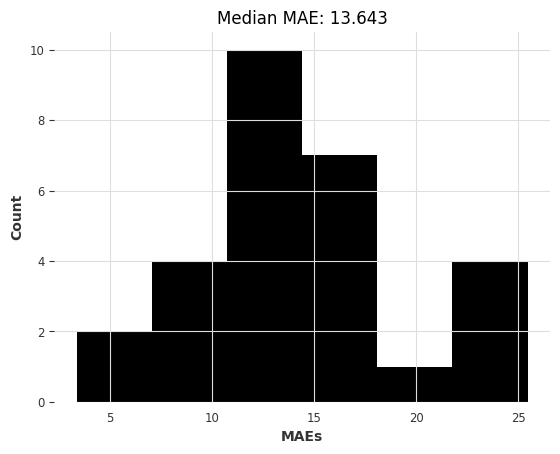

computing RMSEs...


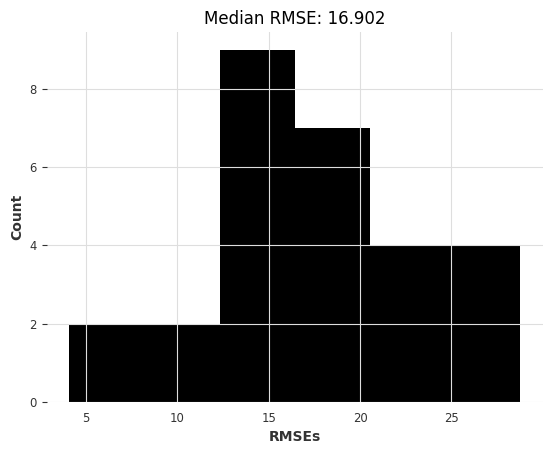


Clarke Error Grid Analysis:
Zone A: 85.12%
Zone B: 0.89%
Zone C: 0.00%
Zone D: 13.99%
Zone E: 0.00%


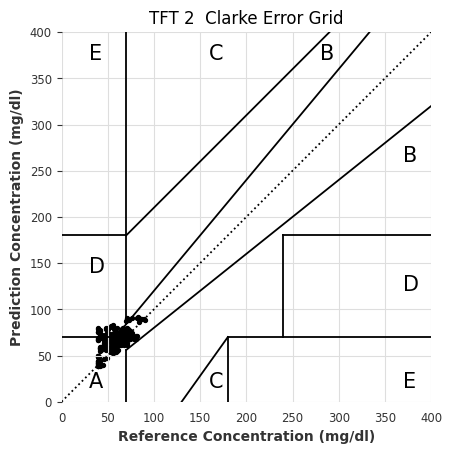

In [413]:
start_time = time.time()

tft_pred = tft.predict(
    series=cgm_train_transformed,
    n=HORIZON,
    past_covariates=past_covariates_transformed_train,
    future_covariates=future_covariates_transformed_val_ext,
)

tft_elapsed_time = time.time() - start_time
print(f"TFT prediction took {tft_elapsed_time:.2f}s")

tft_maes = eval_forecasts_mae(tft_pred, cgm_val_transformed)
tft_rmses = eval_forecasts_rmse(tft_pred, cgm_val_transformed)

evaluate_clarke_error(lgbm_preds, cgm_val_transformed, target_scaler, model_name="TFT 2 ")

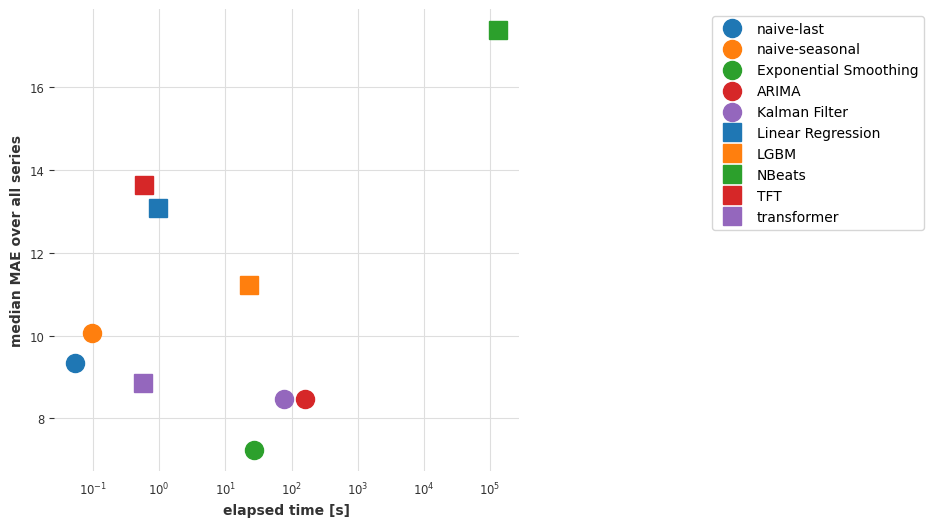

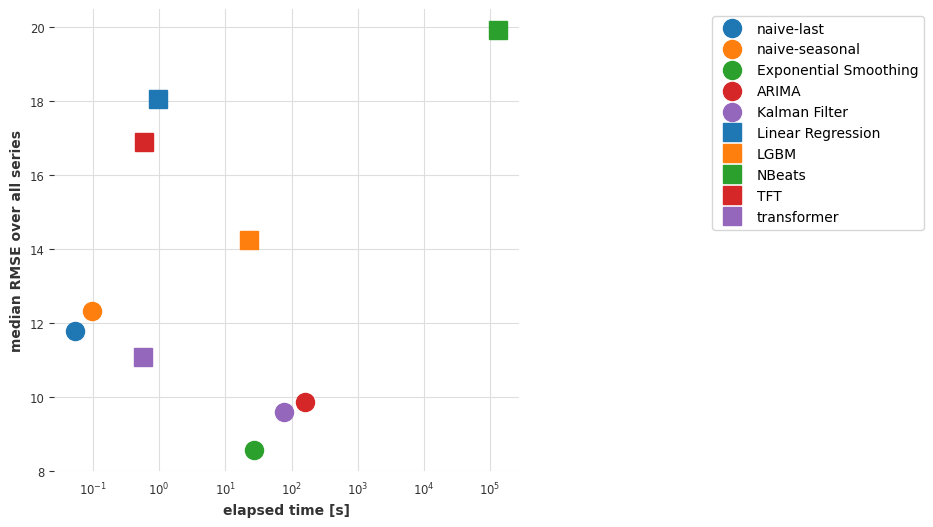

In [414]:
maes_2 = {
    **maes,
    **{
        "Linear Regression": lr_maes,
        "LGBM": lgbm_maes,
        "NBeats": nbeats_maes,
        "TFT": tft_maes,
        "transformer": ts_maes,
    },
}

rmses_2 = {
    **rmses,
    **{
        "Linear Regression": lr_rmses,
        "LGBM": lgbm_rmses,
        "NBeats": nbeats_rmses,
        "TFT": tft_rmses,
        "transformer": ts_rmses,
    },
}

elapsed_times_2 = {
    **elapsed_times,
    **{
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "NBeats": nbeats_elapsed_time,
        "TFT": tft_elapsed_time,
        "transformer": ts_elapsed_time,
    },
}

plot_models(elapsed_times_2, maes_2, "MAE")
plot_models(elapsed_times_2, rmses_2, "RMSE")

# TFT

In [58]:
quantiles = [
    0.1,
    0.5,
    0.9,
]

input_chunk_length = 72
forecast_horizon = 12

from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint

checkpoint_cb = ModelCheckpoint(
    monitor="val_loss",
    save_top_k=1,
    mode="min"
)

EarlyStopping(
    monitor="val_loss",
    min_delta=1e-4,
    patience=10,
    mode='min',
)


tuned_tft = TFTModel(
    add_relative_index=True,
    input_chunk_length=input_chunk_length,
    output_chunk_length=forecast_horizon,
    hidden_size=119,
    lstm_layers=1,
    num_attention_heads=2,
    dropout=0.23310745920680712,
    batch_size=512,
    n_epochs=50,
    add_encoders=None,
    optimizer_kwargs={"lr":0.0002684671988513788},
    likelihood=QuantileRegression(quantiles=quantiles),
    pl_trainer_kwargs={
        "enable_model_summary": True,
        "enable_checkpointing": True,
        "callbacks": [checkpoint_cb]
    },
    log_tensorboard=True,
    random_state=42,
)

In [60]:
tuned_tft.fit(
    series=cgm_train_transformed,
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_train,
    val_past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_train,
    val_future_covariates=future_covariates_transformed_val,
    dataloader_kwargs={"num_workers": 4},
    verbose=True
)

print(summarize(tft.model))
tft.save("trained_tft")


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

NameError: name 'tft' is not defined

In [62]:
print(summarize(tuned_tft.model))
tuned_tft.save()

   | Name                              | Type                             | Params | Mode 
------------------------------------------------------------------------------------------------
0  | train_metrics                     | MetricCollection                 | 0      | train
1  | val_metrics                       | MetricCollection                 | 0      | train
2  | input_embeddings                  | _MultiEmbedding                  | 0      | train
3  | static_covariates_vsn             | _VariableSelectionNetwork        | 0      | train
4  | encoder_vsn                       | _VariableSelectionNetwork        | 18.5 K | train
5  | decoder_vsn                       | _VariableSelectionNetwork        | 9.2 K  | train
6  | static_context_grn                | _GatedResidualNetwork            | 57.4 K | train
7  | static_context_hidden_encoder_grn | _GatedResidualNetwork            | 57.4 K | train
8  | static_context_cell_encoder_grn   | _GatedResidualNetwork            | 57.4 K |

In [ ]:
print("val_series ends at:", cgm_val_transformed[0].end_time())
print("val_future_covariates ends at:", future_covariates_transformed_val[0].end_time())


## TFT 32 batch

In [681]:
quantiles = [
    0.1,
    0.5,
    0.9,
]

input_chunk_length = 72
forecast_horizon = 12

from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint

checkpoint_cb = ModelCheckpoint(
    monitor="val_loss",
    save_top_k=1,
    mode="min"
)

EarlyStopping(
    monitor="val_loss",
    min_delta=1e-4,
    patience=10,
    mode='min',
)


tft_32 = TFTModel(
    add_relative_index=True,
    input_chunk_length=input_chunk_length,
    output_chunk_length=forecast_horizon,
    hidden_size=119,
    lstm_layers=1,
    num_attention_heads=2,
    dropout=0.23310745920680712,
    batch_size=32,
    n_epochs=20,
    add_encoders=None,
    optimizer_kwargs={"lr":0.0002684671988513788},
    likelihood=QuantileRegression(quantiles=quantiles),
    pl_trainer_kwargs={
        "enable_model_summary": True,
        "enable_checkpointing": True,
        "callbacks": [checkpoint_cb]
    },
    log_tensorboard=True,
    random_state=42,
    checkpoint
)

tft_32.fit(
    series=cgm_train_transformed,
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_train,
    val_past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_train,
    val_future_covariates=future_covariates_transformed_val,
    dataloader_kwargs={"num_workers": 4},
    verbose=True
)

print(summarize(tft_32.model))
tft.save("tft_32_finetuned_v2")

Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

   | Name                              | Type                             | Params | Mode 
------------------------------------------------------------------------------------------------
0  | train_metrics                     | MetricCollection                 | 0      | train
1  | val_metrics                       | MetricCollection                 | 0      | train
2  | input_embeddings                  | _MultiEmbedding                  | 0      | train
3  | static_covariates_vsn             | _VariableSelectionNetwork        | 0      | train
4  | encoder_vsn                       | _VariableSelectionNetwork        | 18.5 K | train
5  | decoder_vsn                       | _VariableSelectionNetwork        | 9.2 K  | train
6  | static_context_grn                | _GatedResidualNetwork            | 57.4 K | train
7  | static_context_hidden_encoder_grn | _GatedResidualNetwork            | 57.4 K | train
8  | static_context_cell_encoder_grn   | _GatedResidualNetwork            | 57.4 K |

## TFT std

In [682]:
quantiles = [
    0.1,
    0.5,
    0.9,
]

input_chunk_length = 72
forecast_horizon = 12

from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint

checkpoint_cb = ModelCheckpoint(
    monitor="val_loss",
    save_top_k=1,
    mode="min"
)

EarlyStopping(
    monitor="val_loss",
    min_delta=1e-4,
    patience=10,
    mode='min',
)


tft_std = TFTModel(
    add_relative_index=True,
    input_chunk_length=input_chunk_length,
    output_chunk_length=forecast_horizon,
    n_epochs=20,
    likelihood=QuantileRegression(quantiles=quantiles),
    pl_trainer_kwargs={
        "enable_model_summary": True,
        "enable_checkpointing": True,
        "callbacks": [checkpoint_cb]
    },
    log_tensorboard=True,
    random_state=42,
)

tft_std.fit(
    series=cgm_train_transformed,
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_train,
    val_past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_train,
    val_future_covariates=future_covariates_transformed_val,
    dataloader_kwargs={"num_workers": 4},
    verbose=True
)

print(summarize(tft_std.model))
tft.save("tft_std")

Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

   | Name                              | Type                             | Params | Mode 
------------------------------------------------------------------------------------------------
0  | train_metrics                     | MetricCollection                 | 0      | train
1  | val_metrics                       | MetricCollection                 | 0      | train
2  | input_embeddings                  | _MultiEmbedding                  | 0      | train
3  | static_covariates_vsn             | _VariableSelectionNetwork        | 0      | train
4  | encoder_vsn                       | _VariableSelectionNetwork        | 3.7 K  | train
5  | decoder_vsn                       | _VariableSelectionNetwork        | 1.8 K  | train
6  | static_context_grn                | _GatedResidualNetwork            | 1.1 K  | train
7  | static_context_hidden_encoder_grn | _GatedResidualNetwork            | 1.1 K  | train
8  | static_context_cell_encoder_grn   | _GatedResidualNetwork            | 1.1 K  |

# Backtesting

In [715]:
from darts import concatenate
import time
import numpy as np
import os
import matplotlib.pyplot as plt

def backtest_model(
    model,
    model_name,
    val_series,
    scaler,
    forecast_horizon=12,
    stride=12,
    retrain=True,
    verbose=True,
    save_dir="model_results",
    past_covariates=None,
    future_covariates=None,
    last_points_only=True
):
    start_time = time.time()

    forecasts = model.historical_forecasts(
        series=val_series,
        past_covariates=past_covariates,
        future_covariates=future_covariates,
        start=0,
        forecast_horizon=forecast_horizon,
        stride=stride,
        retrain=retrain,
        last_points_only=last_points_only,
        verbose=verbose
    )

    total_time = time.time() - start_time

    plot_dir = os.path.join(save_dir, f"{model_name}_plots")
    os.makedirs(plot_dir, exist_ok=True)

    all_maes = []
    all_rmses = []
    all_predicted = []
    all_actual = []

    concatenated_forecasts = []

    for i in range(len(val_series)):
        if isinstance(forecasts[i], list):
            forecast_series = concatenate(forecasts[i], axis=0)
        else:
            forecast_series = forecasts[i]

        concatenated_forecasts.append(forecast_series)

        plt.figure(figsize=(10, 4))
        scaler.inverse_transform(val_series[i]).plot(label="Actual")
        scaler.inverse_transform(forecast_series).plot(label="Forecast")
        plt.title(f"{model_name} - Series {i}")
        plt.legend()
        plt.tight_layout()

        save_path = os.path.join(plot_dir, f"{model_name}_series_{i}.png")
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

        combined_preds = concatenate(forecast_series, axis=0)
        ground_truth = val_series[i].slice_intersect(combined_preds)

        unscaled_pred = scaler.inverse_transform(combined_preds)
        unscaled_actual = scaler.inverse_transform(ground_truth)

        mae_val = mae(unscaled_actual, unscaled_pred)
        rmse_val = rmse(unscaled_actual, unscaled_pred)

        all_maes.append(mae_val)
        all_rmses.append(rmse_val)

        all_predicted.extend(unscaled_pred.values().flatten())
        all_actual.extend(unscaled_actual.values().flatten())

    metrics_path = os.path.join(plot_dir, f"{model_name}_metrics.txt")
    with open(metrics_path, "w") as f:
        f.write(f"Average MAE: {np.mean(all_maes):.4f}\n")
        f.write(f"Average RMSE: {np.mean(all_rmses):.4f}\n")
        f.write(f"Total time: {total_time:.2f} seconds\n")
        f.write("\nDetailed metrics:\n")
        for i, (mae_val, rmse_val) in enumerate(zip(all_maes, all_rmses)):
            f.write(f"Series {i}: MAE = {mae_val:.4f}, RMSE = {rmse_val:.4f}\n")

    with open(metrics_path, "a") as f:
        f.write("\nClarke Error Grid Analysis:\n")
        plot, clarke_zones = evaluate_clarke_error(concatenated_forecasts, val_series, scaler, model_name, save_file=f)
        
        clarke_img_path = os.path.join(plot_dir, f"{model_name}_clarke_error.png")
        plot.savefig(clarke_img_path, dpi=300, bbox_inches='tight')
        plot.show()
        plot.close()

    return all_maes, all_rmses, total_time, clarke_zones

## Naive Seasonal k=12

historical forecasts:   0%|          | 0/28 [00:00<?, ?it/s]

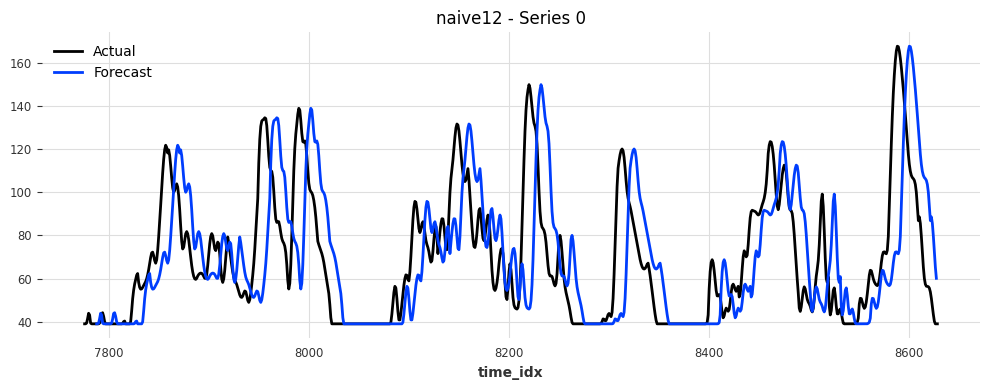

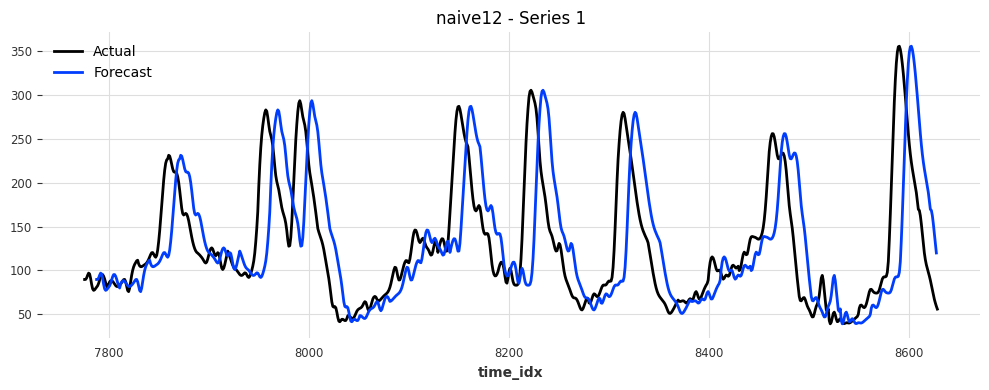

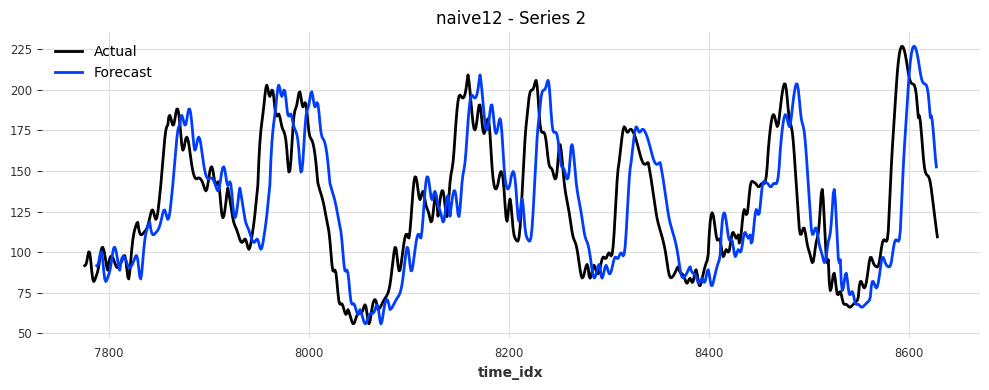

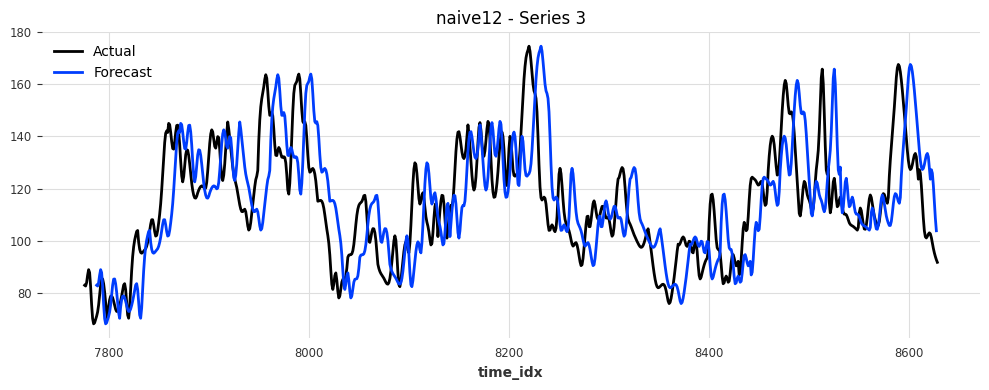

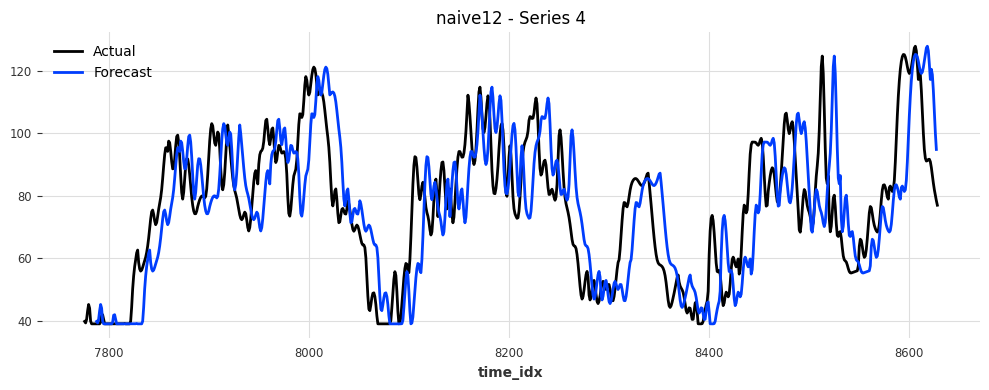

...

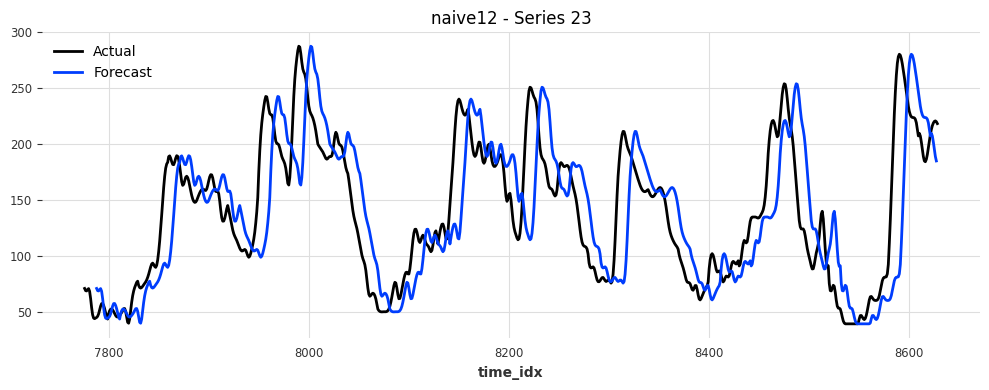

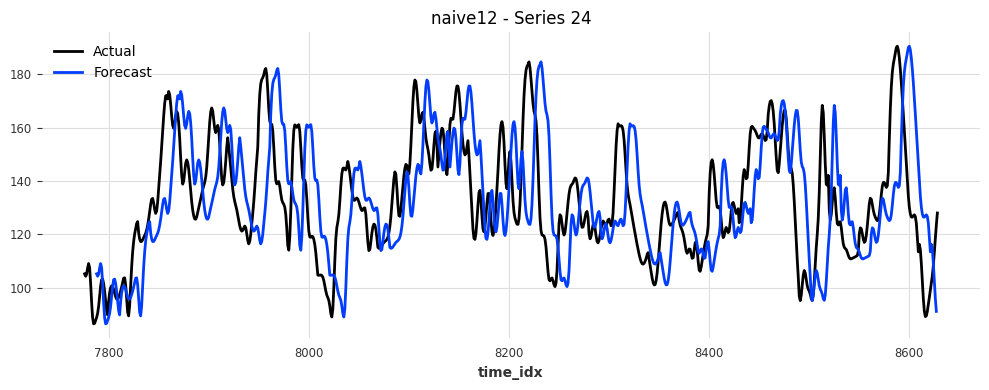

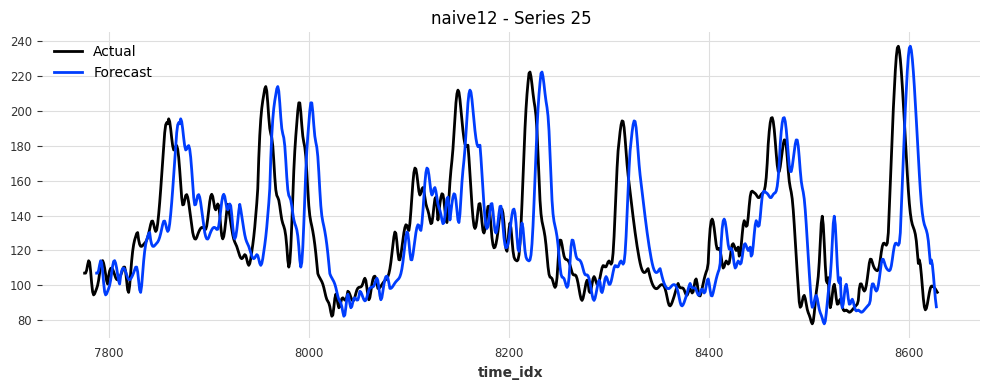

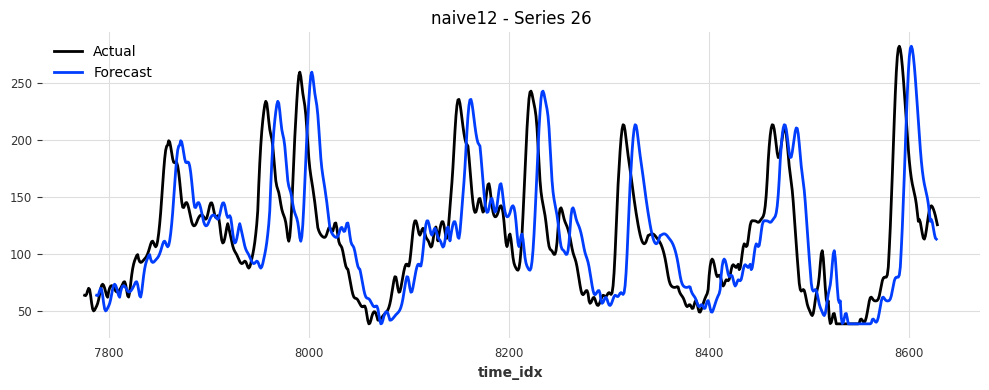

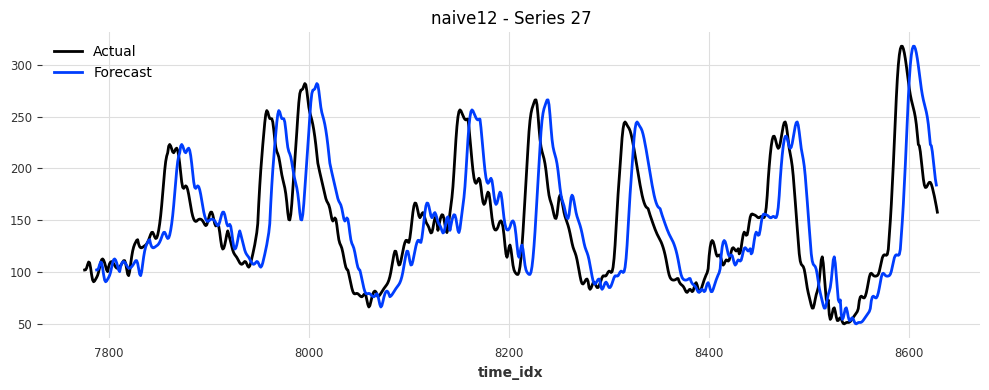


Clarke Error Grid for naive12:
Zone A: 66.01%
Zone B: 30.11%
Zone C: 0.30%
Zone D: 3.53%
Zone E: 0.04%


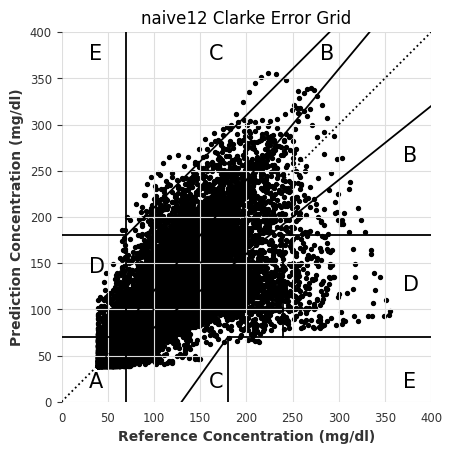

In [716]:
naive12 = NaiveSeasonal(K=12)

naive12_maes, naive12_rmses, naive12_time, naive12_zones = backtest_model(
    model=naive12,
    model_name="naive12",
    val_series=cgm_val_transformed,
    scaler=target_scaler,
    last_points_only=False
)

## Exponential Smoothing

historical forecasts:   0%|          | 0/28 [00:00<?, ?it/s]

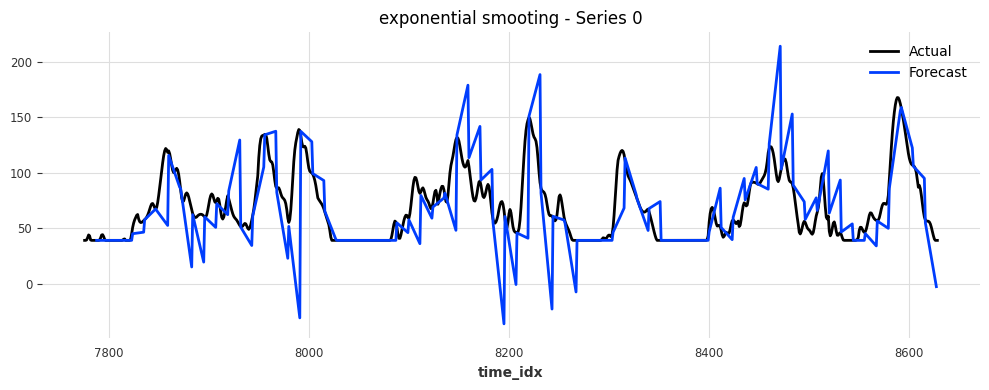

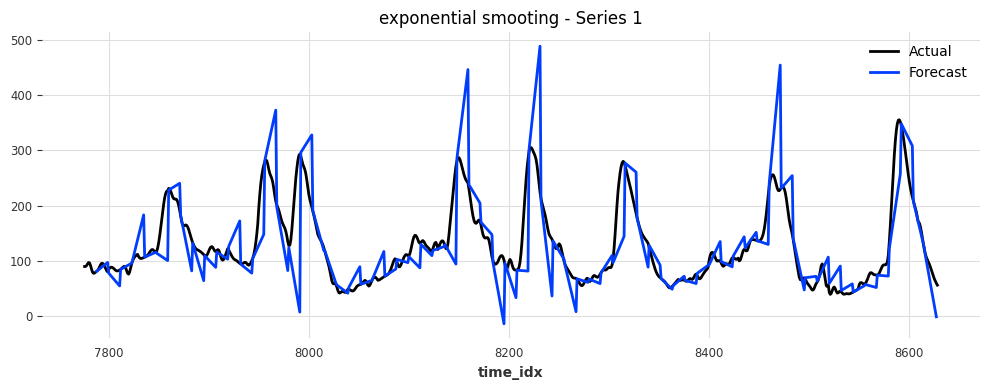

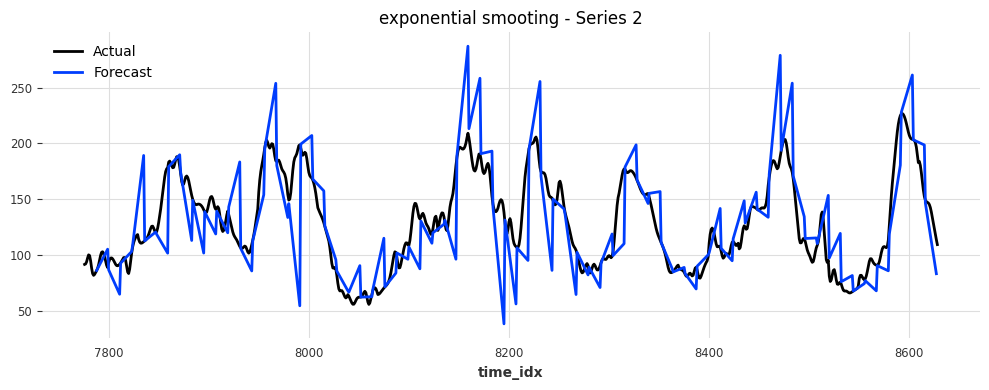

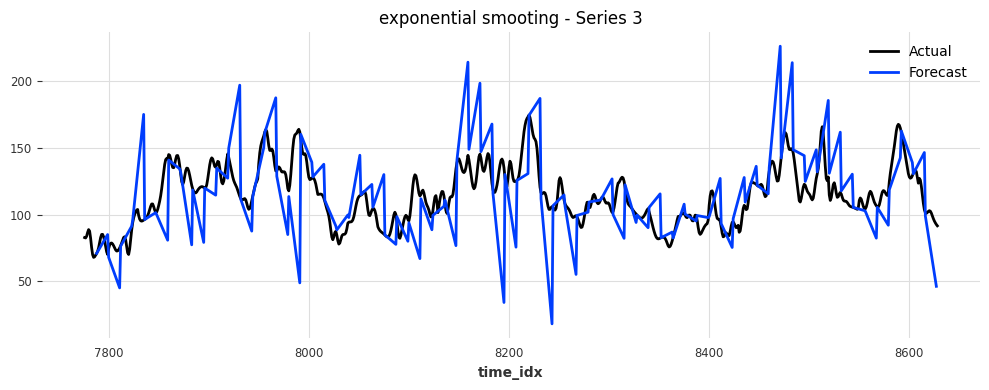

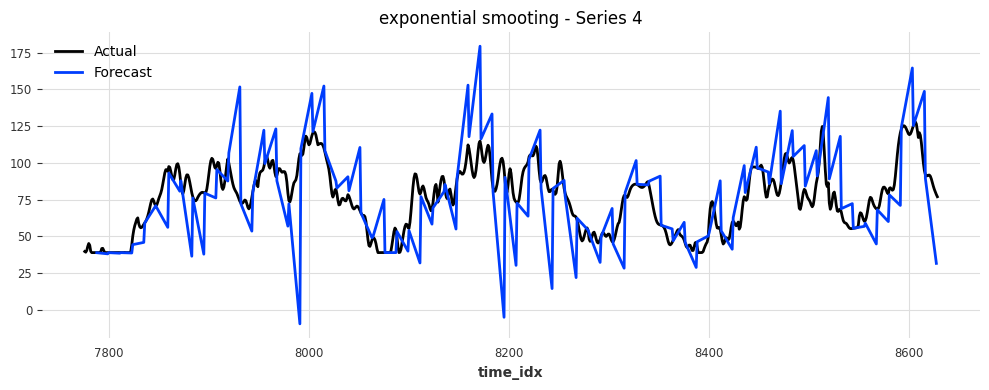

...

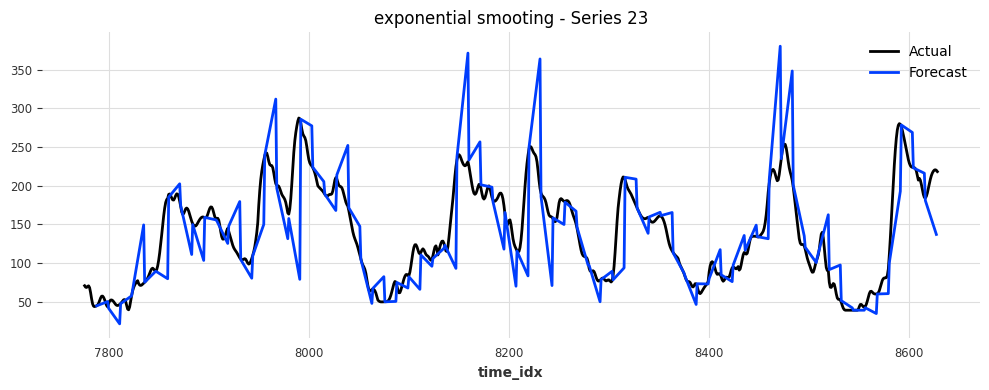

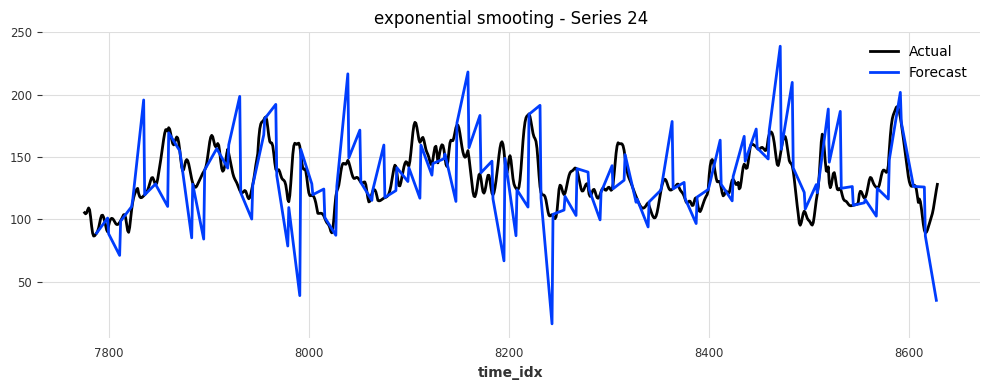

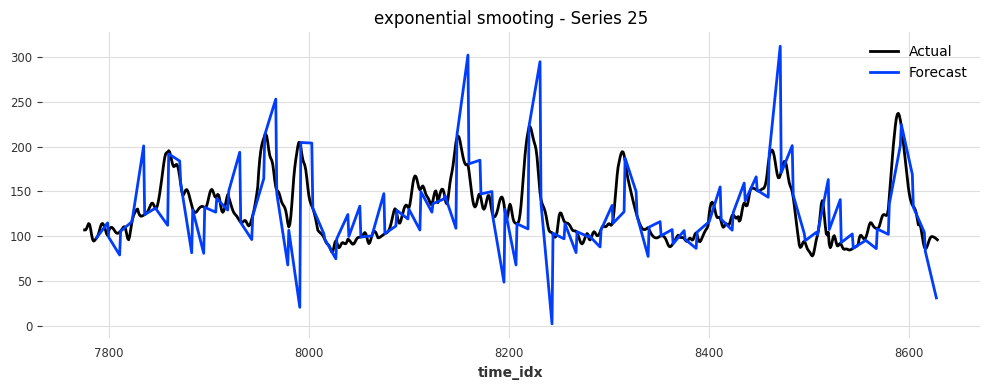

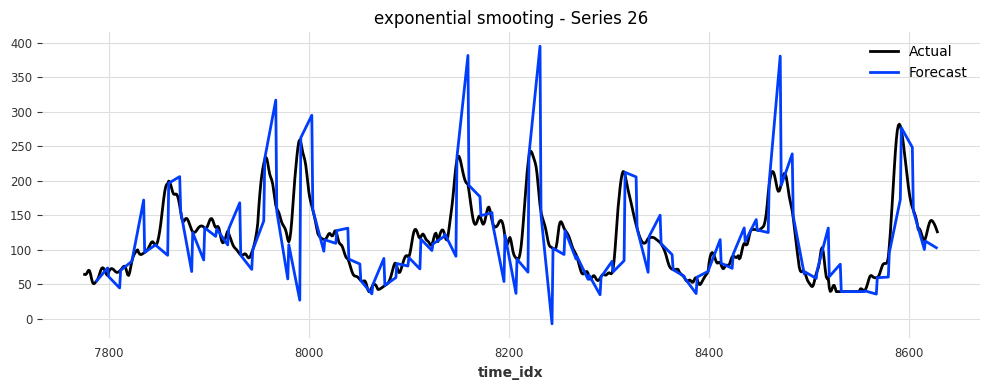

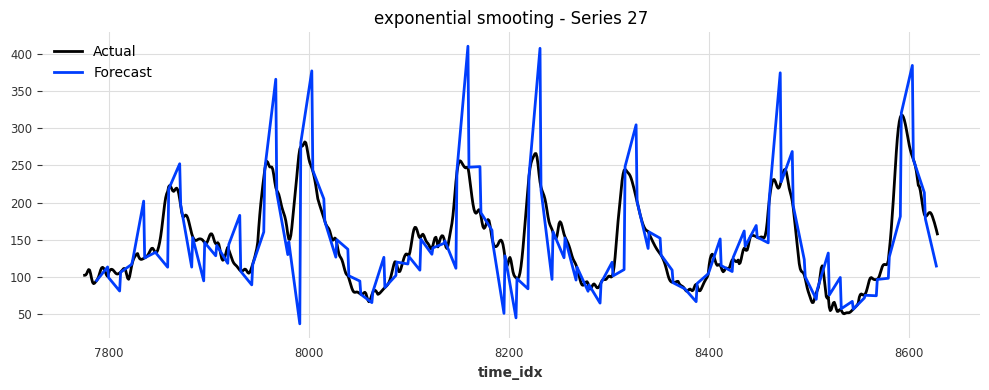


Clarke Error Grid for exponential smooting:
Input Warning: the maximum reference value 355.28135743656986 or the maximum prediction value 488.53117163593555 exceeds the normal physiological range of glucose (<400 mg/dl).
Input Warning: the minimum reference value 38.99999999999999 or the minimum prediction value -59.590081157516636 is less than 0 mg/dl.
Zone A: 70.21%
Zone B: 26.77%
Zone C: 0.68%
Zone D: 2.11%
Zone E: 0.22%


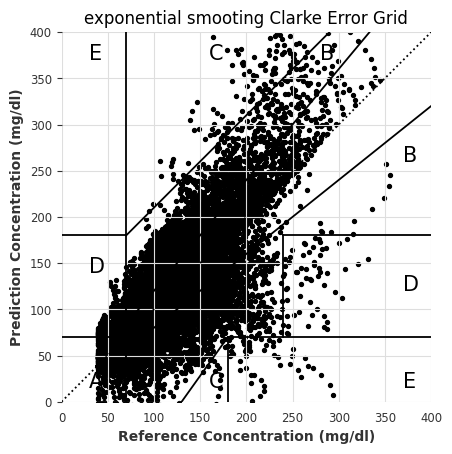

In [720]:
exp_smoothing = ExponentialSmoothing(seasonal=None, damped=False)

exp_maes, exp_rmses, exp_time, exp_zones = backtest_model(
    model=exp_smoothing,
    model_name="exponential smooting",
    val_series=cgm_val_transformed,
    scaler=target_scaler,
    last_points_only=False
)

## ARIMA

historical forecasts:   0%|          | 0/28 [00:00<?, ?it/s]

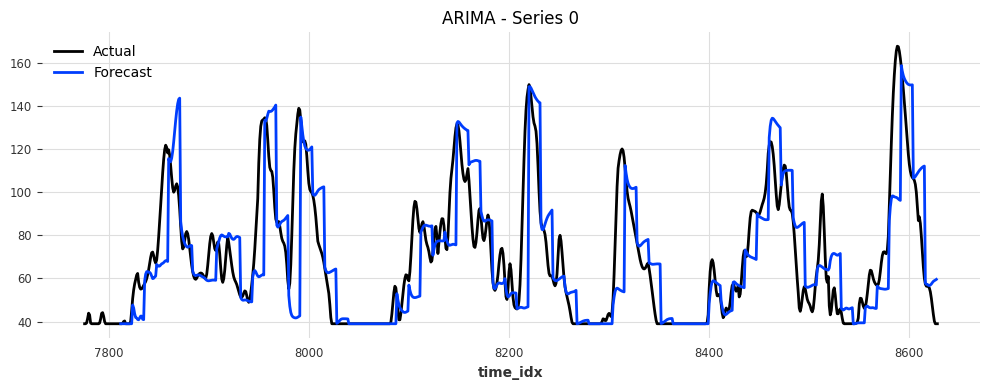

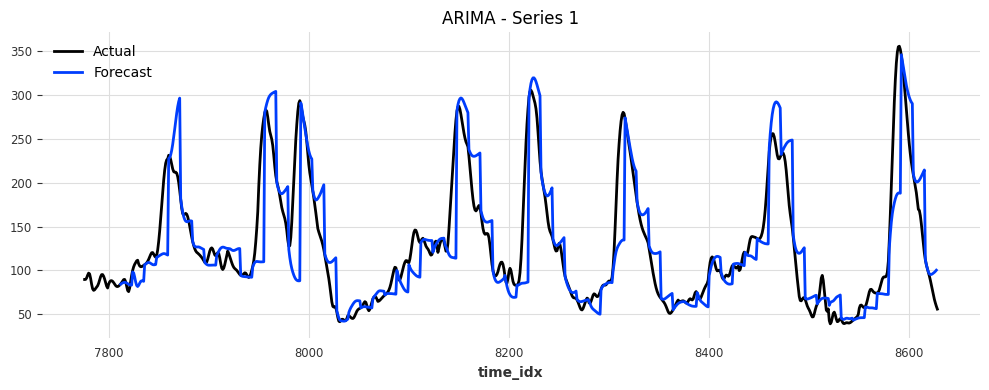

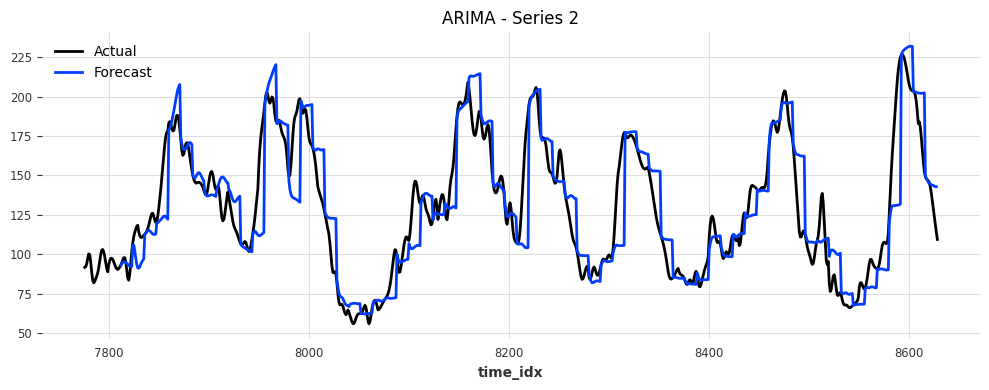

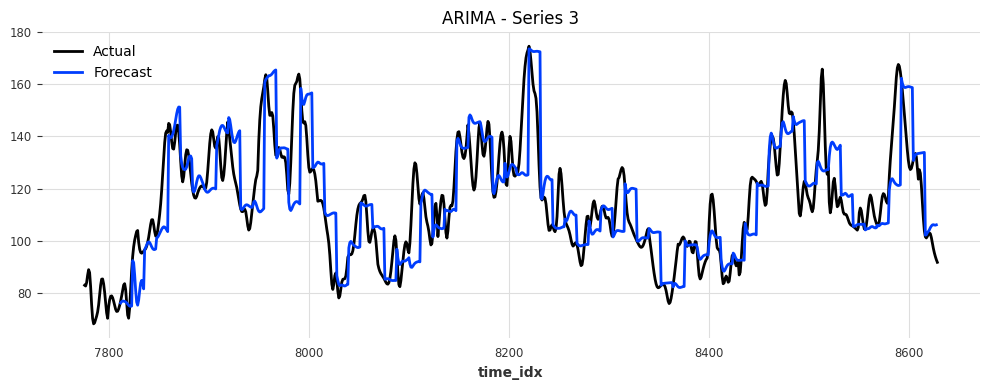

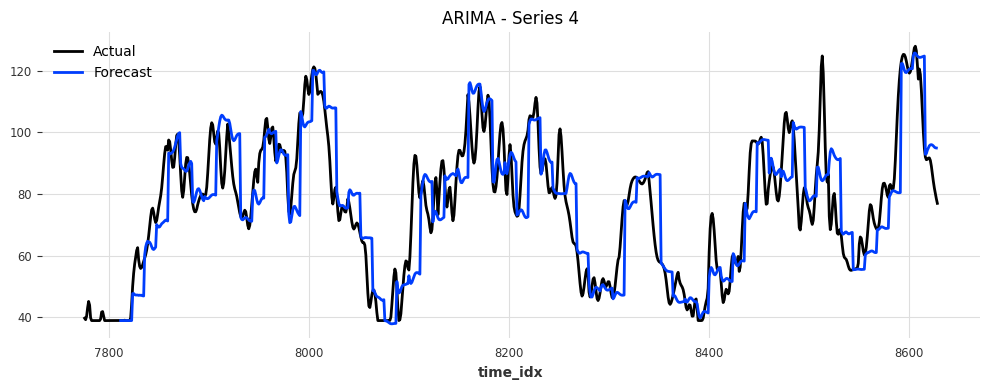

...

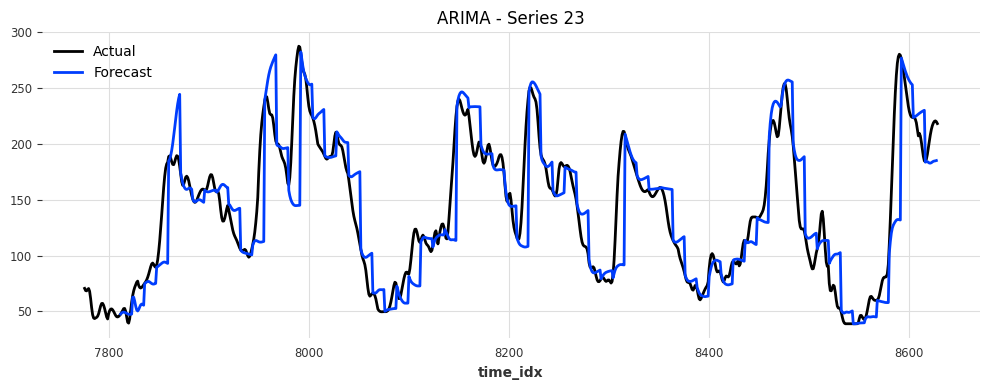

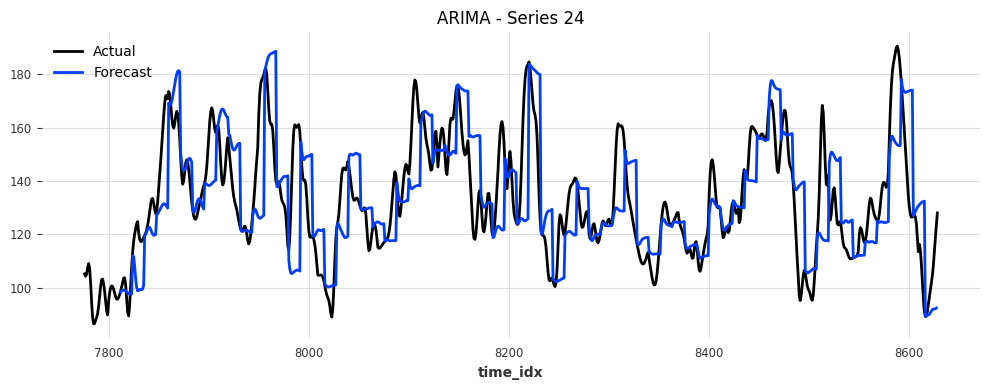

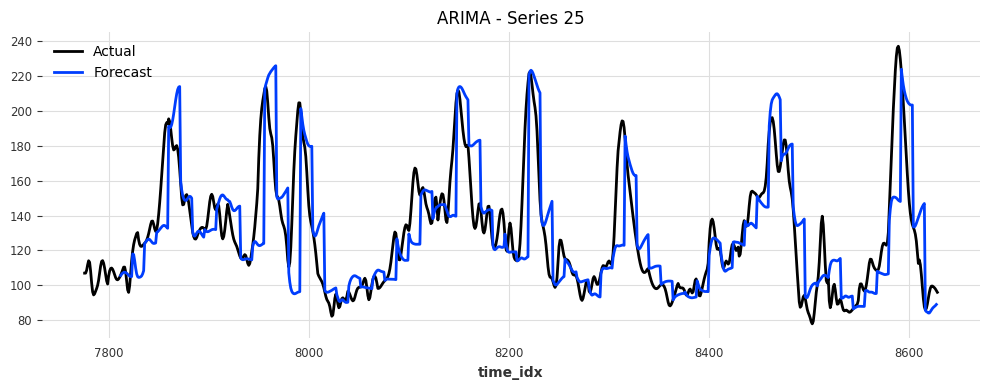

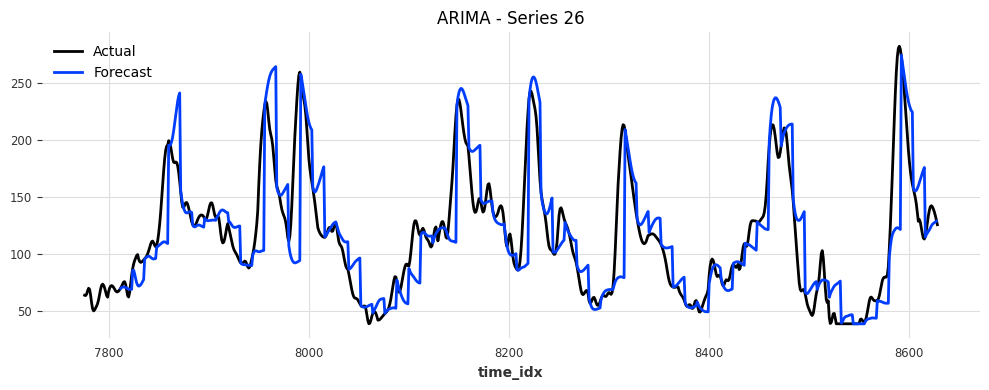

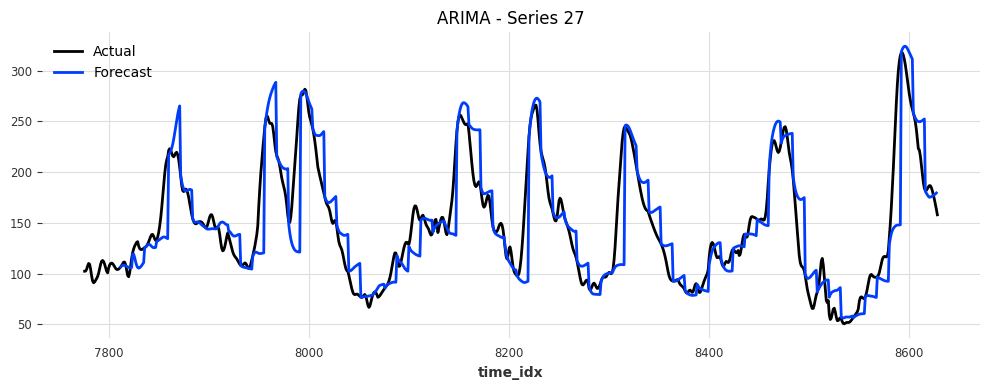


Clarke Error Grid for ARIMA:
Zone A: 83.09%
Zone B: 15.22%
Zone C: 0.00%
Zone D: 1.66%
Zone E: 0.03%


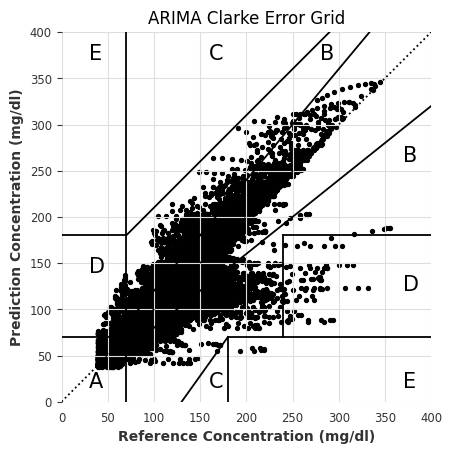

In [721]:
arima_model = ARIMA(p=12, d=1, q=1)

start_time = time.time()

arima_maes, arima_rmses, arima_time, arima_zones = backtest_model(
    model=arima_model,
    model_name="ARIMA",
    val_series=cgm_val_transformed,
    scaler=target_scaler,
    last_points_only=False
)

## Linear Regression

historical forecasts:   0%|          | 0/28 [00:00<?, ?it/s]

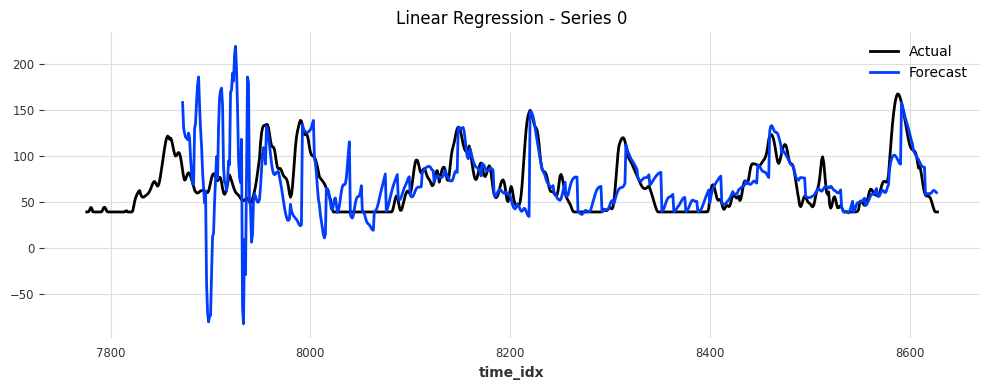

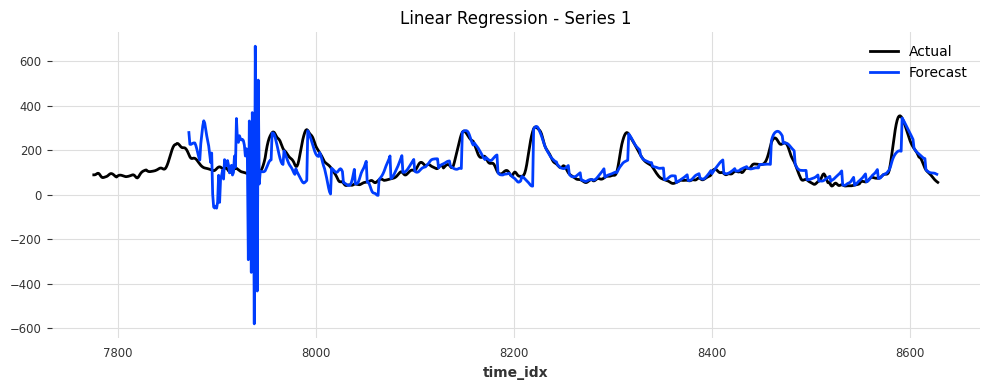

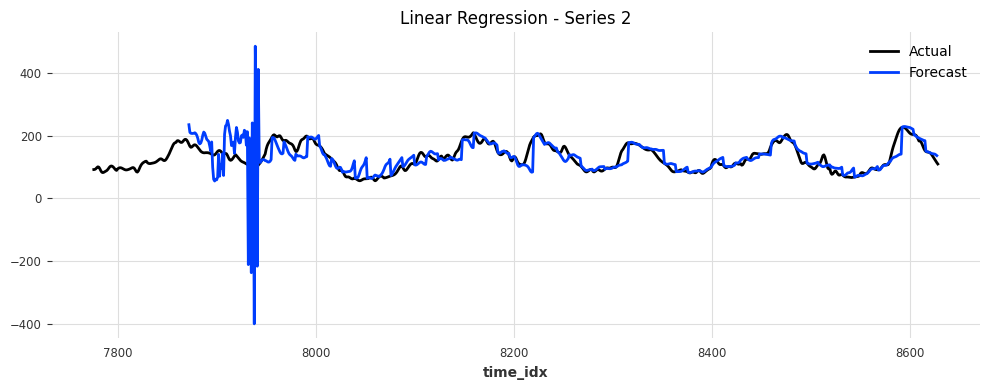

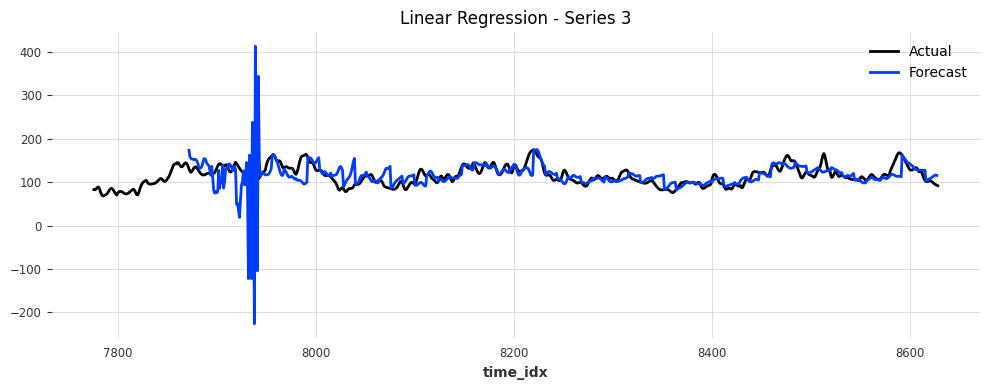

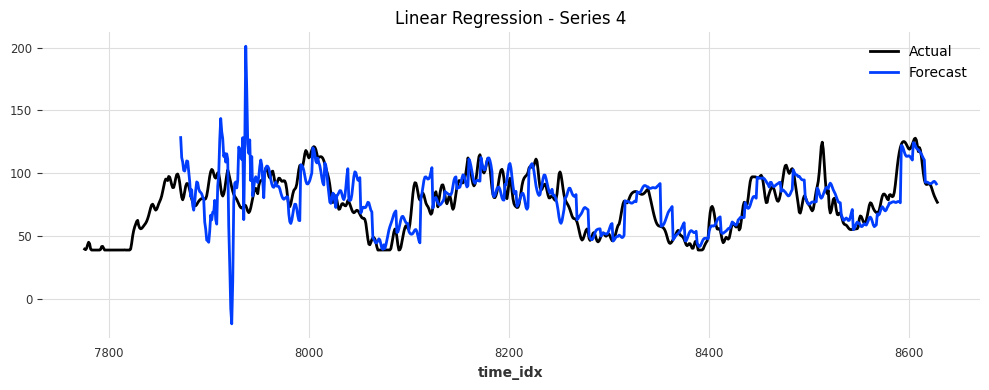

...

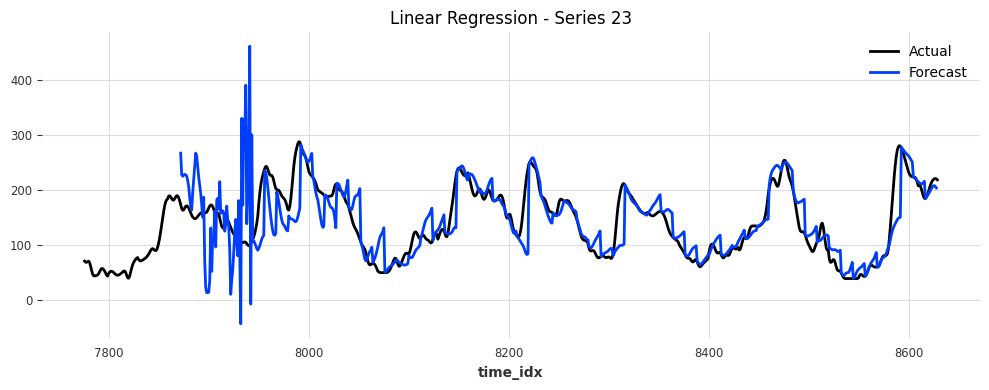

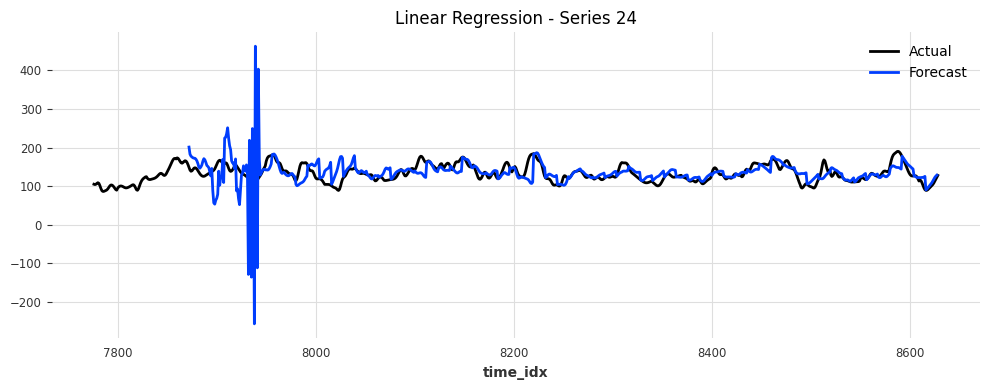

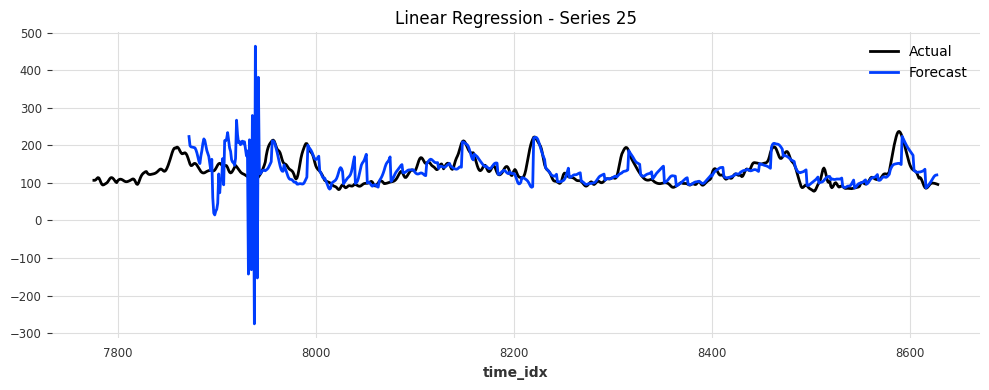

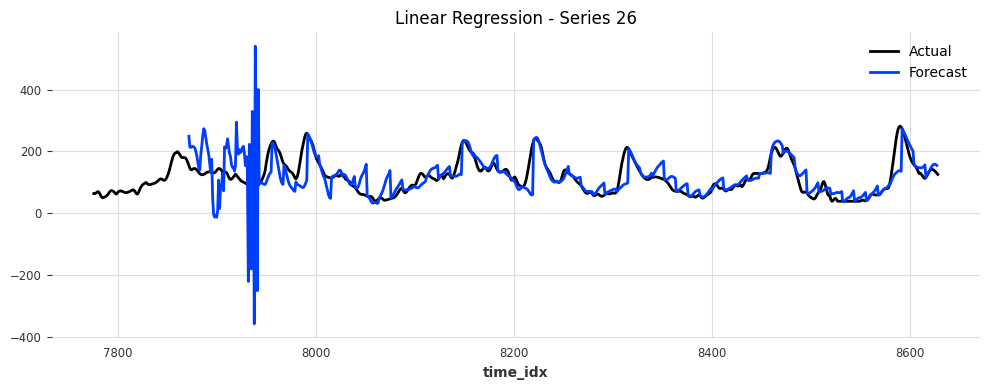

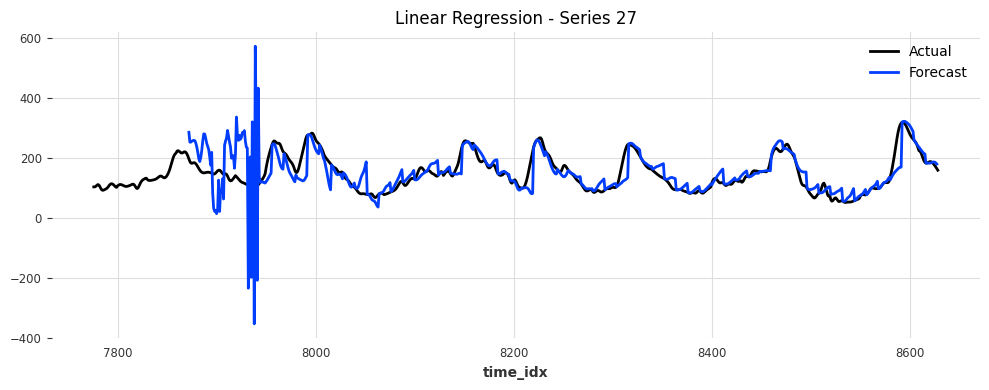


Clarke Error Grid for Linear Regression:
Input Warning: the maximum reference value 355.28135743656986 or the maximum prediction value 684.7030071483701 exceeds the normal physiological range of glucose (<400 mg/dl).
Input Warning: the minimum reference value 38.99999999999999 or the minimum prediction value -580.8065975933542 is less than 0 mg/dl.
Zone A: 74.22%
Zone B: 20.95%
Zone C: 1.08%
Zone D: 3.55%
Zone E: 0.21%


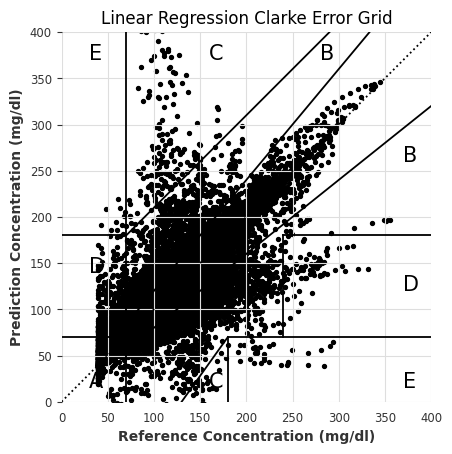

In [722]:
lr = LinearRegressionModel(lags=72, output_chunk_length=12)

lr_maes, lr_rmses, lr_time, lr_zones = backtest_model(
    model=lr,
    model_name="Linear Regression",
    val_series=cgm_val_transformed,
    scaler=target_scaler,
    last_points_only=False
)

## Vanilla Transformer

In [453]:
transformer

TransformerModel(output_chunk_shift=0, d_model=64, nhead=4, num_encoder_layers=3, num_decoder_layers=3, dim_feedforward=512, dropout=0.1, activation=relu, norm_type=None, custom_encoder=None, custom_decoder=None, input_chunk_length=72, output_chunk_length=12, n_epochs=20, log_tensorboard=True)

Predicting: |                                                                                                 …

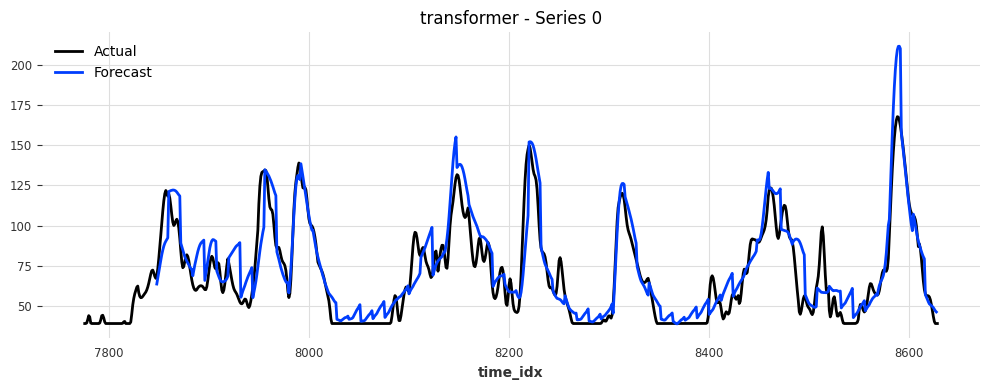

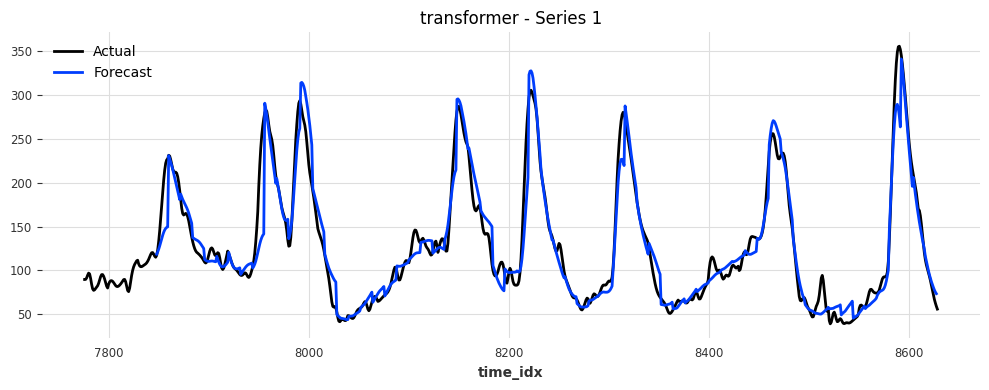

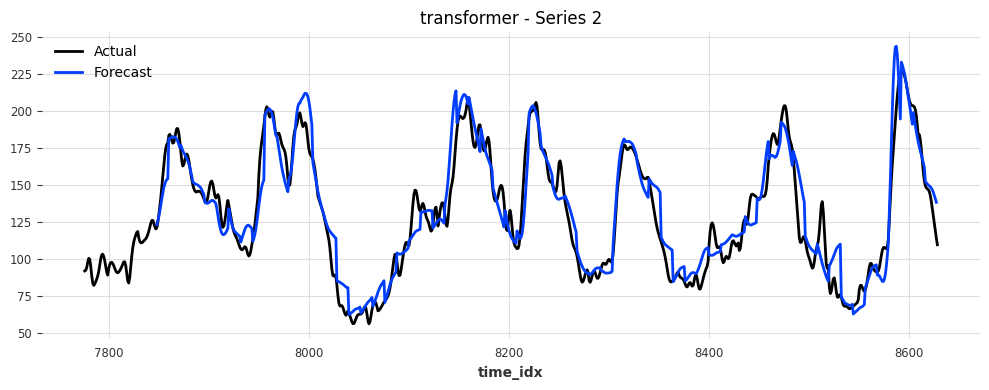

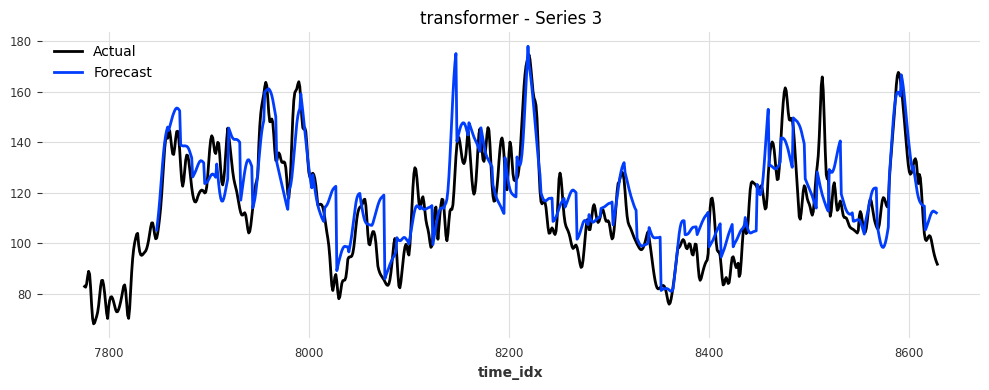

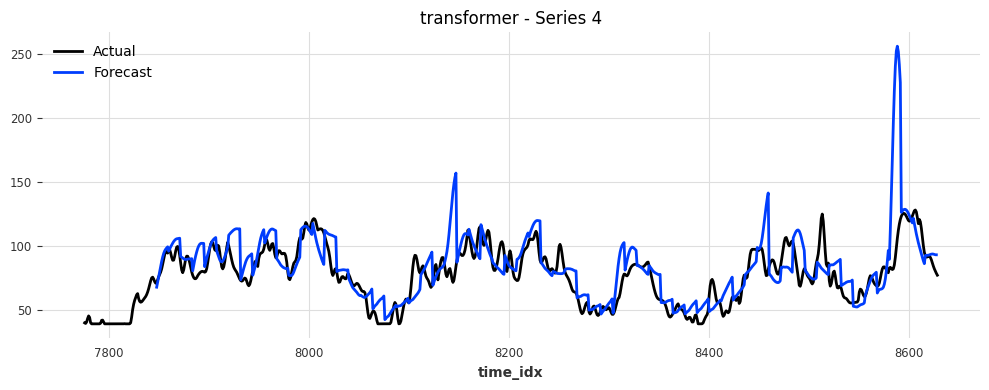

...

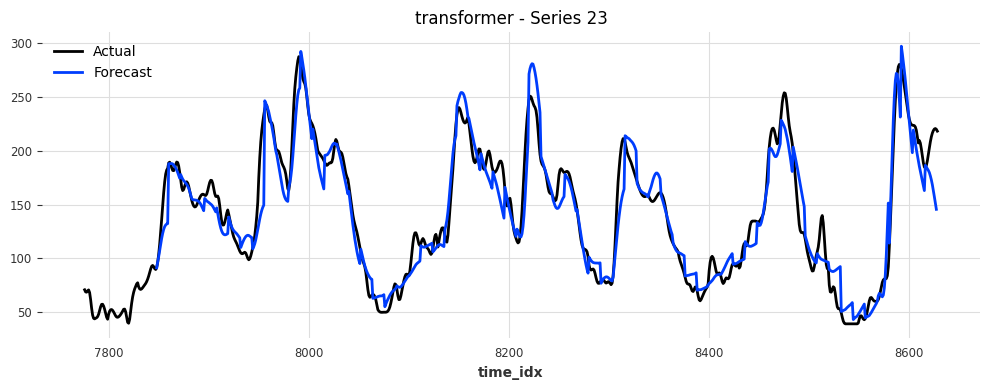

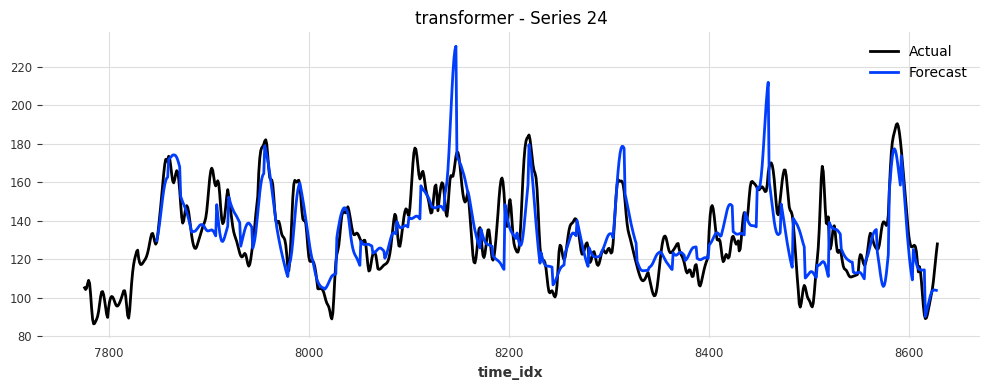

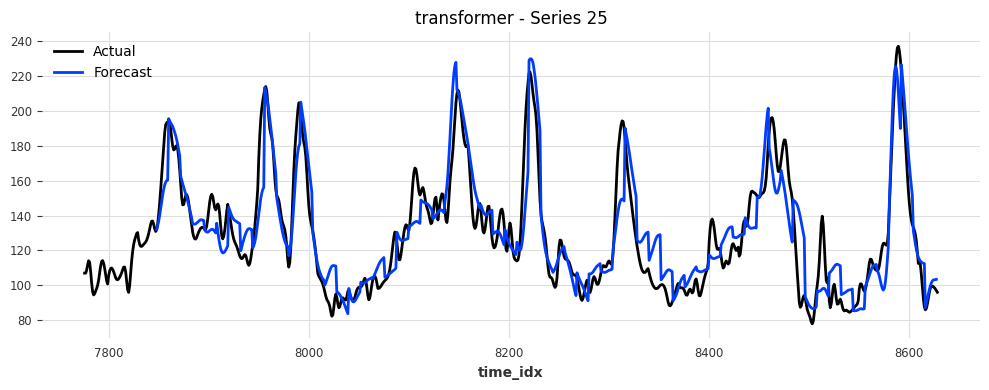

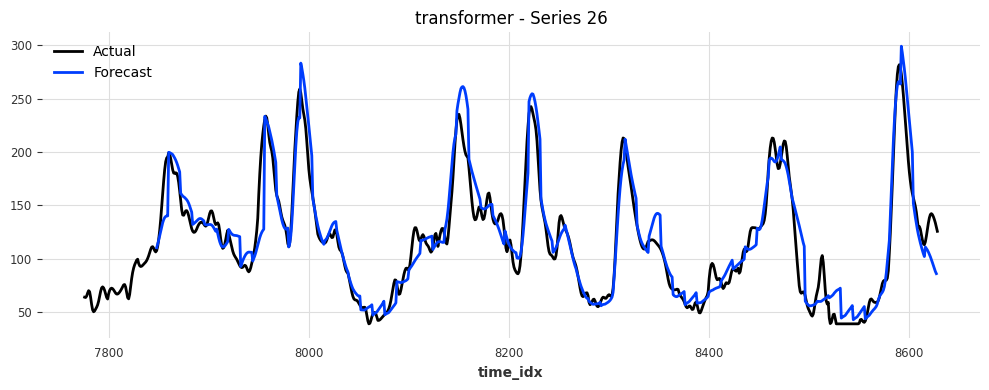

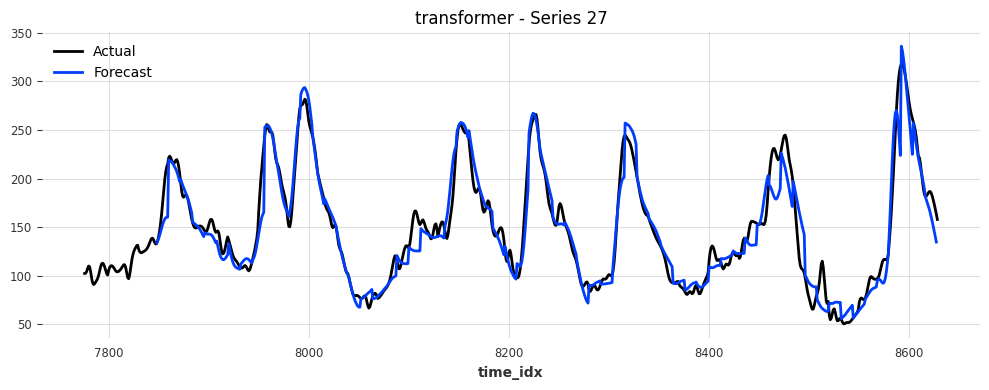


Clarke Error Grid for transformer:
Zone A: 90.19%
Zone B: 8.36%
Zone C: 0.03%
Zone D: 1.42%
Zone E: 0.00%


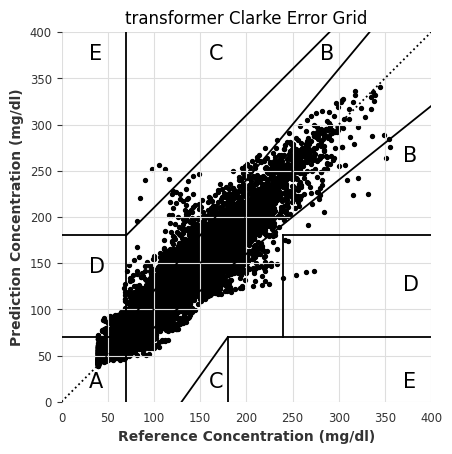

In [723]:
ts_maes, ts_rmses, ts_time, ts_zones = backtest_model(
    model=transformer,
    model_name="transformer",
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    scaler=target_scaler,
    last_points_only=False,
    retrain=False
)

## Temporal Fusion Transformer

### TFT 32

Predicting: |                                                                                                 …

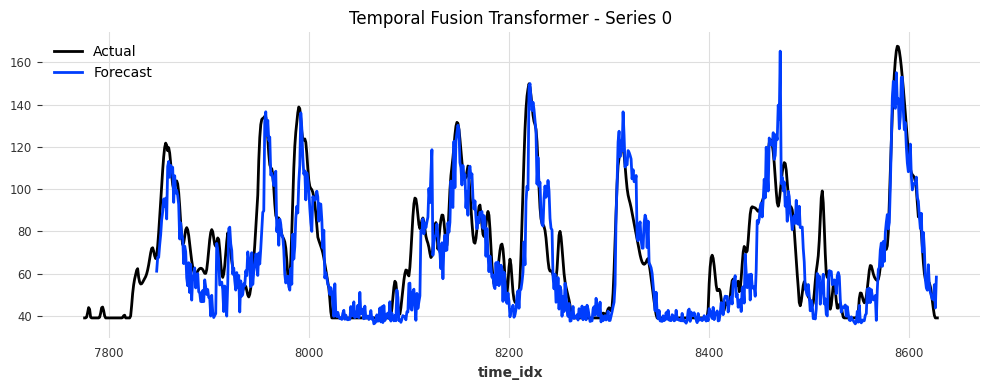

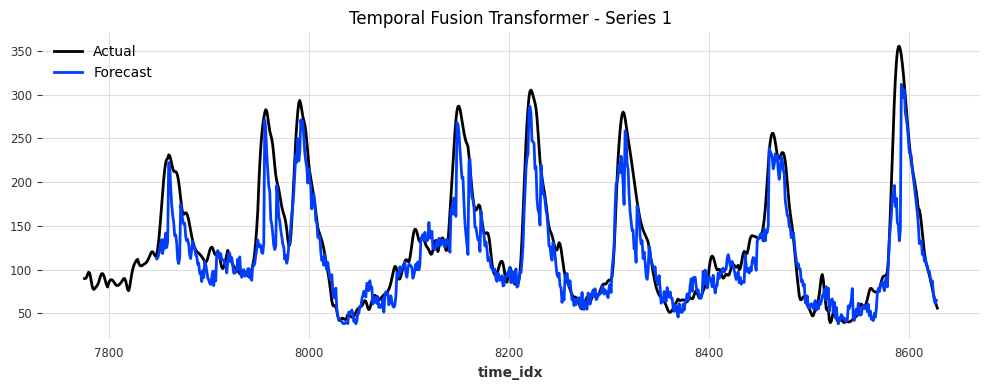

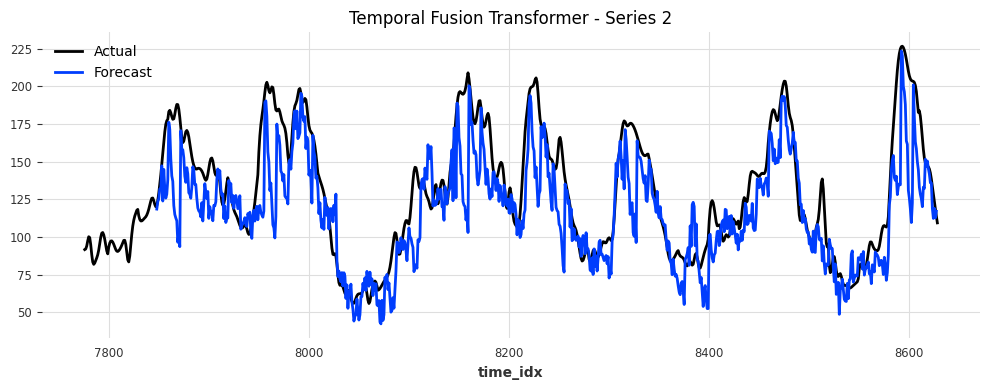

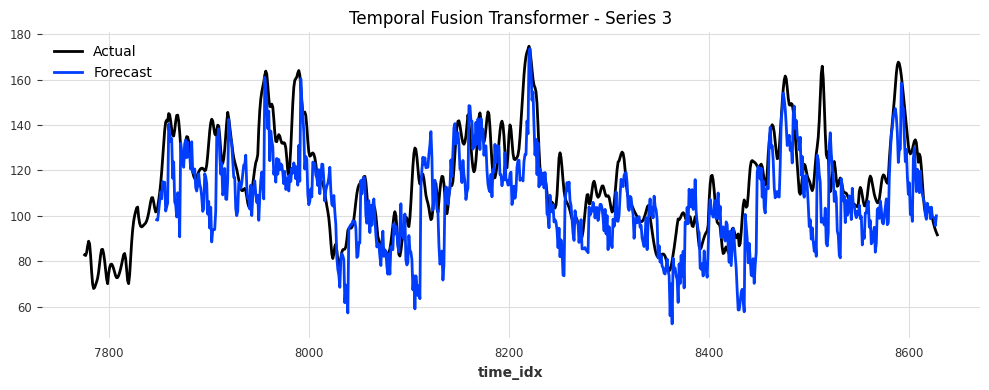

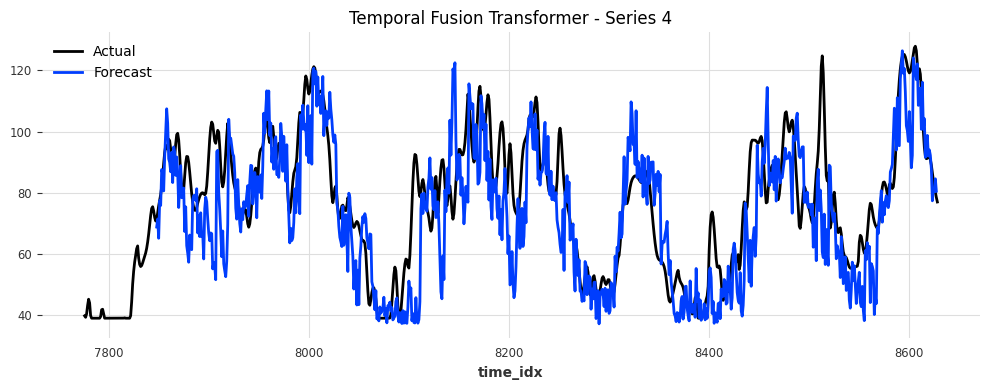

...

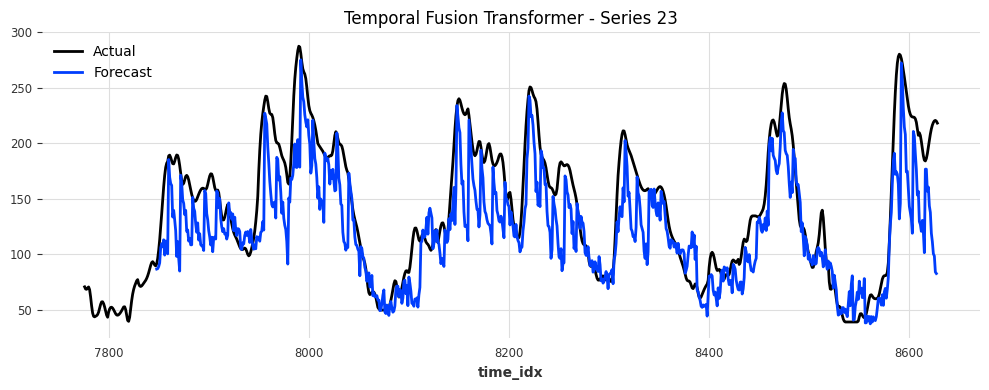

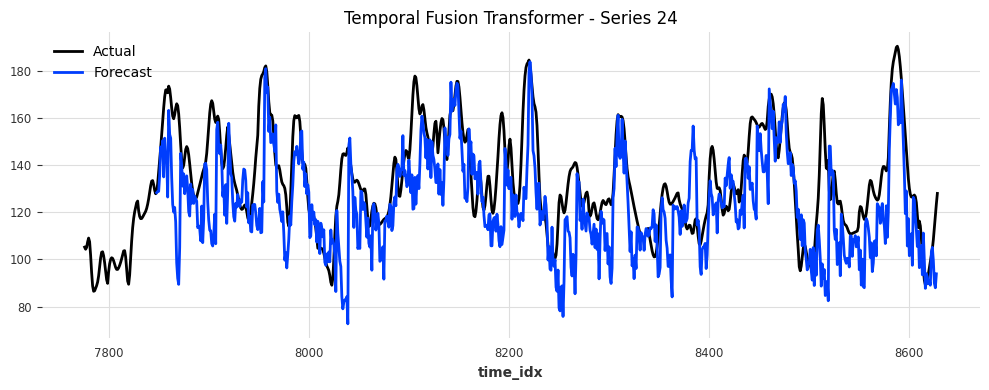

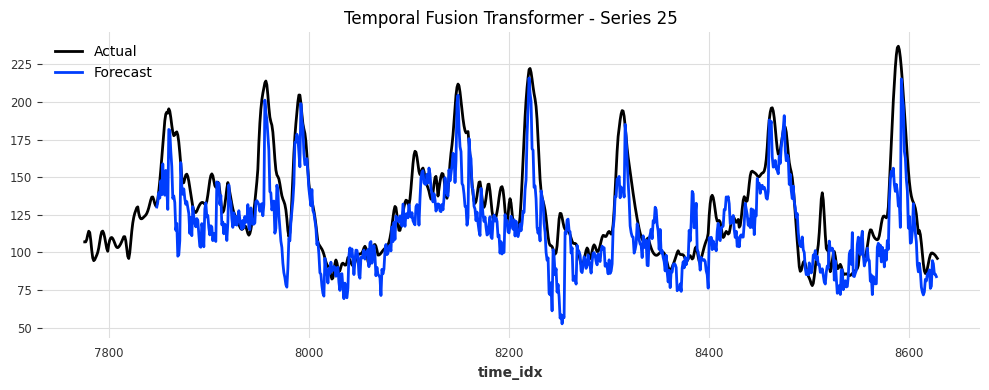

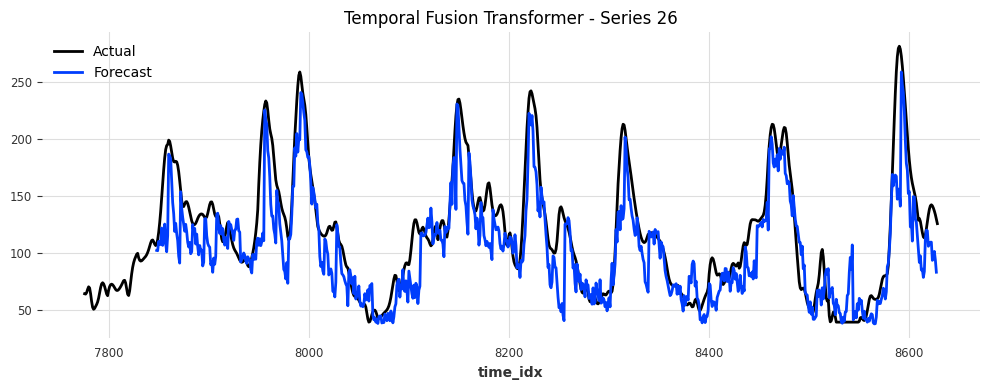

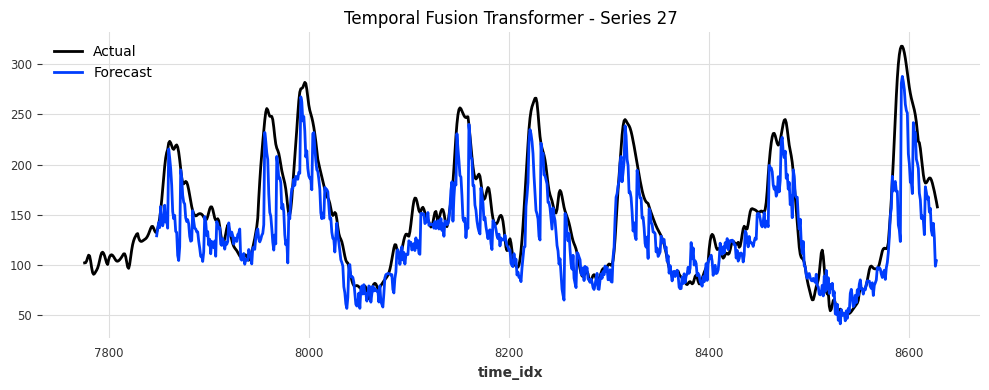


Clarke Error Grid for Temporal Fusion Transformer:
Zone A: 76.18%
Zone B: 22.21%
Zone C: 0.00%
Zone D: 1.61%
Zone E: 0.00%


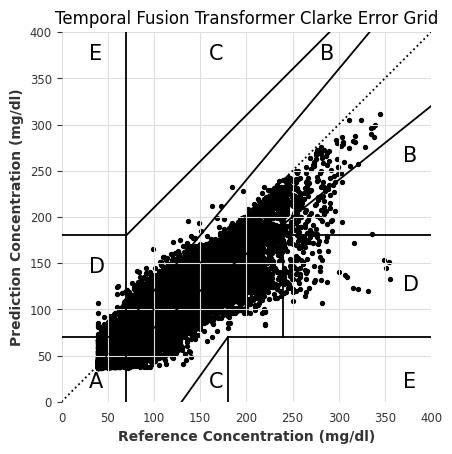

In [725]:
tft_32_maes, tft_32_rmses, tft_32_time, tft_32_zones = backtest_model(
    model=tft_32,
    model_name="Temporal Fusion Transformer",
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_val,
    scaler=target_scaler,
    last_points_only=False,
    retrain=False
)

### TFT STD

Predicting: |                                                                                                 …

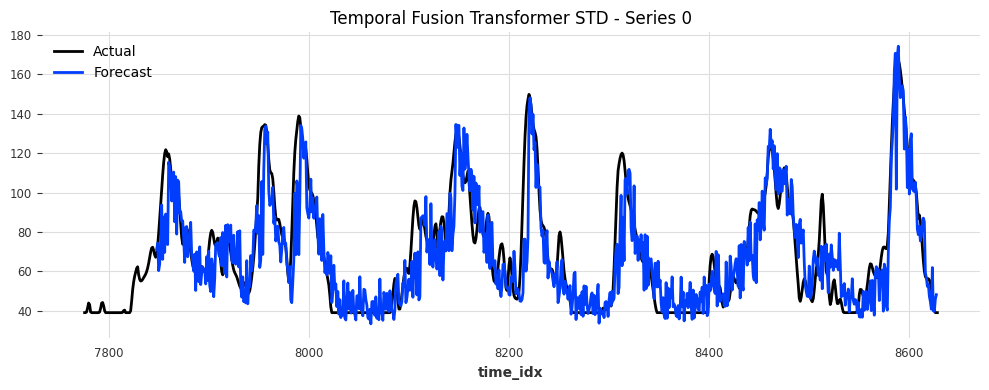

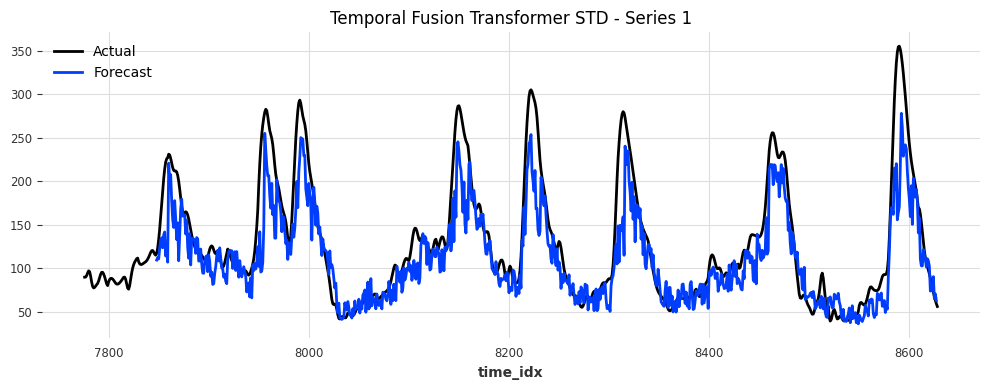

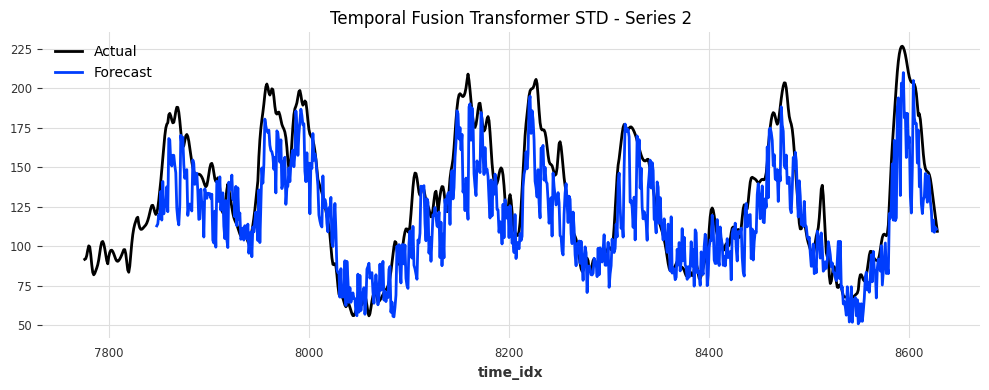

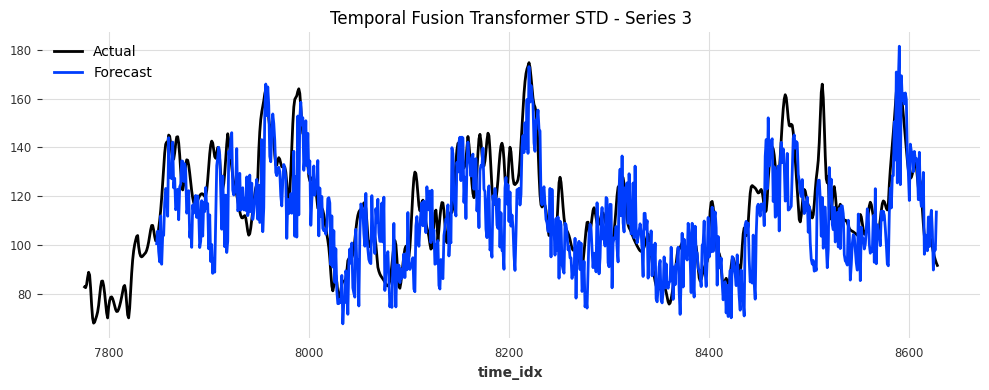

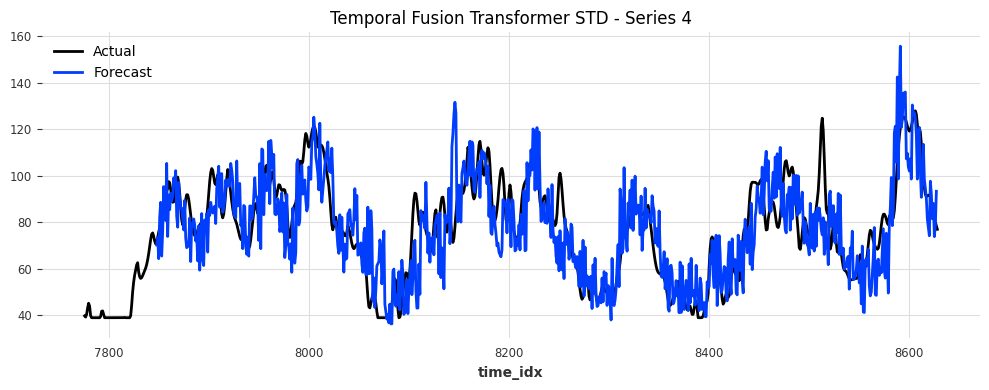

...

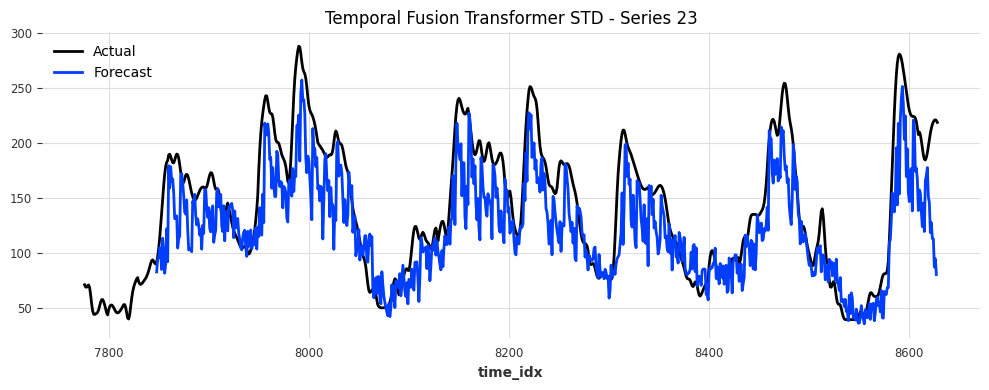

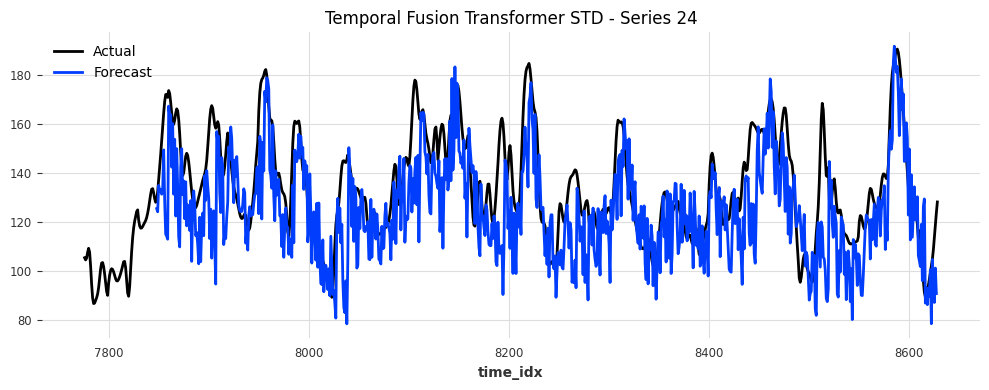

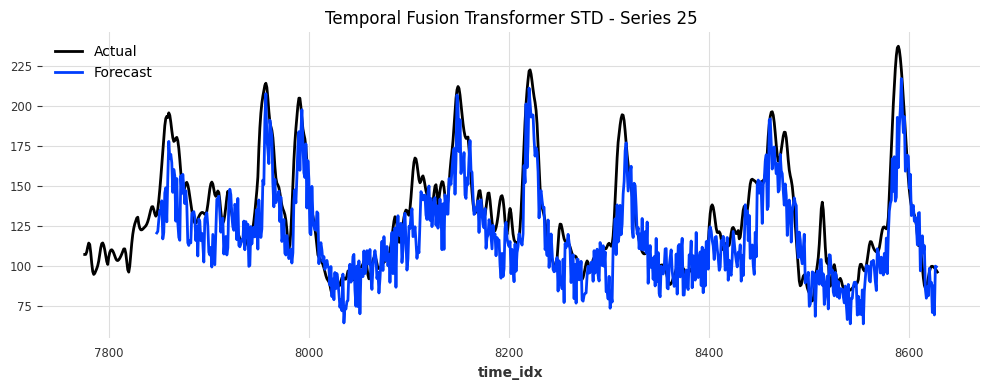

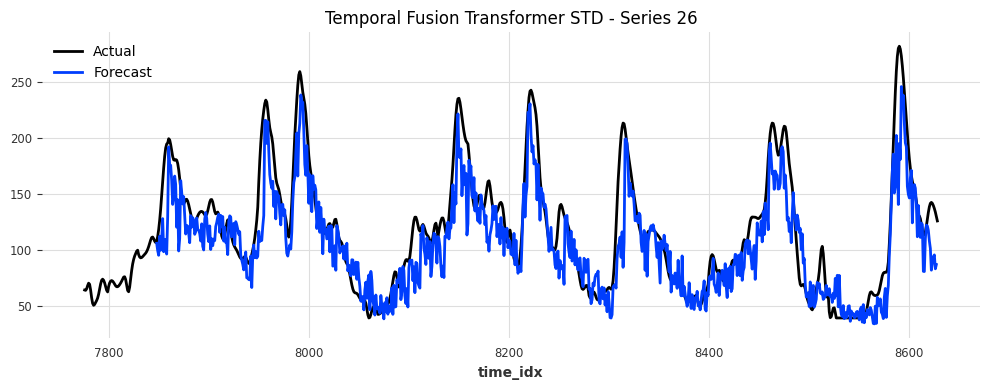

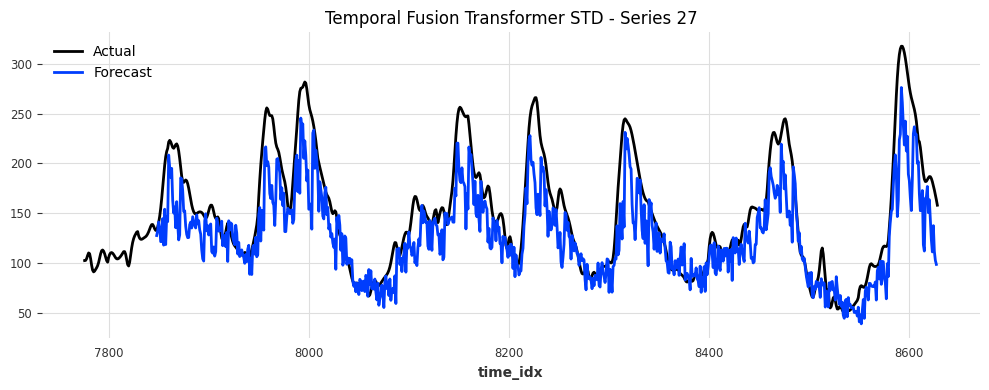


Clarke Error Grid for Temporal Fusion Transformer STD:
Zone A: 77.11%
Zone B: 20.78%
Zone C: 0.00%
Zone D: 2.11%
Zone E: 0.00%


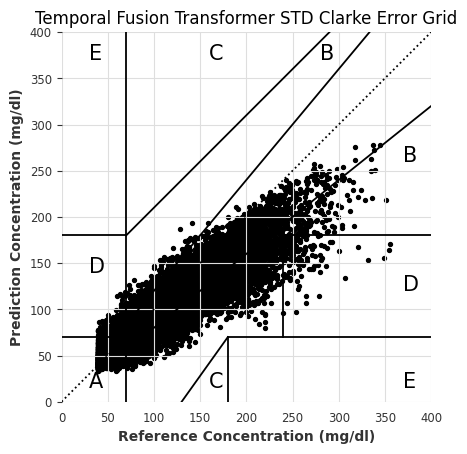

In [726]:
tft_std_maes, tft_std_rmses, tft_std_time, tft_std_zones = backtest_model(
    model=tft_std,
    model_name="temporal fusion transformer std",
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_val,
    scaler=target_scaler,
    last_points_only=False,
    retrain=False
)

## N Beats

Predicting: |                                                                                                 …

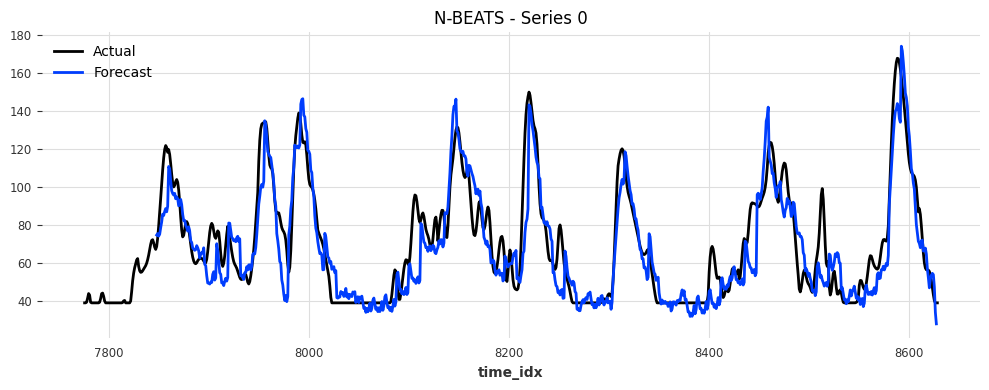

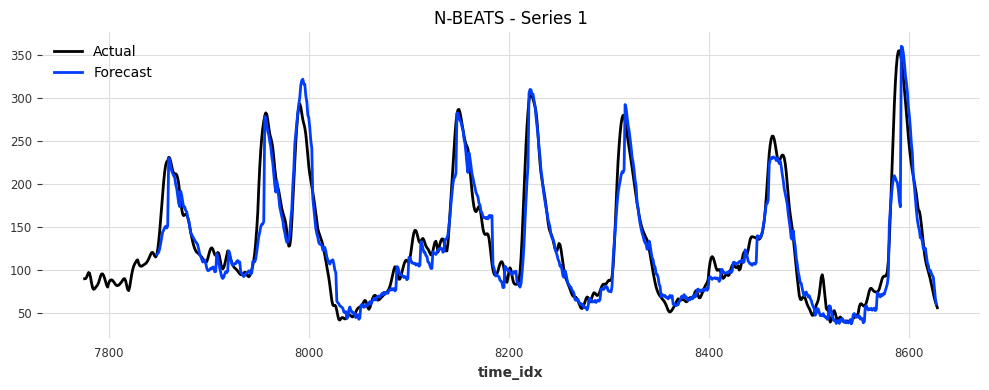

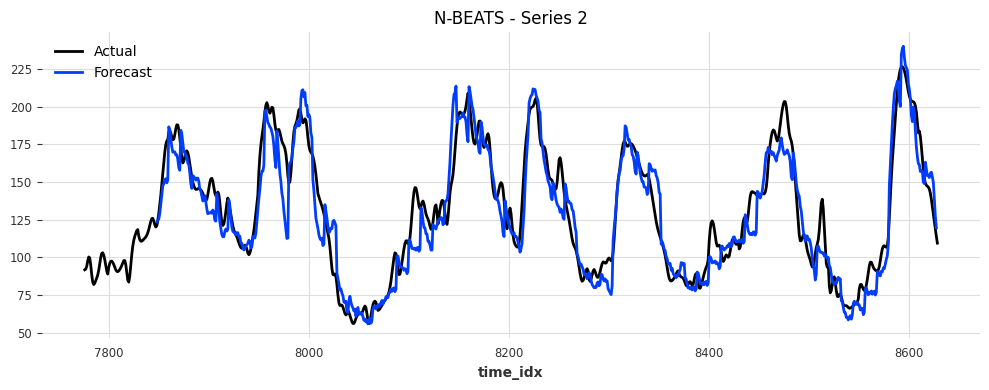

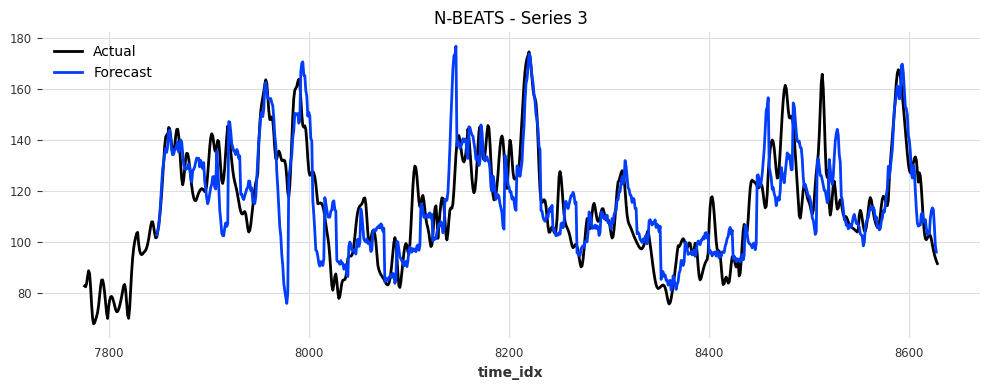

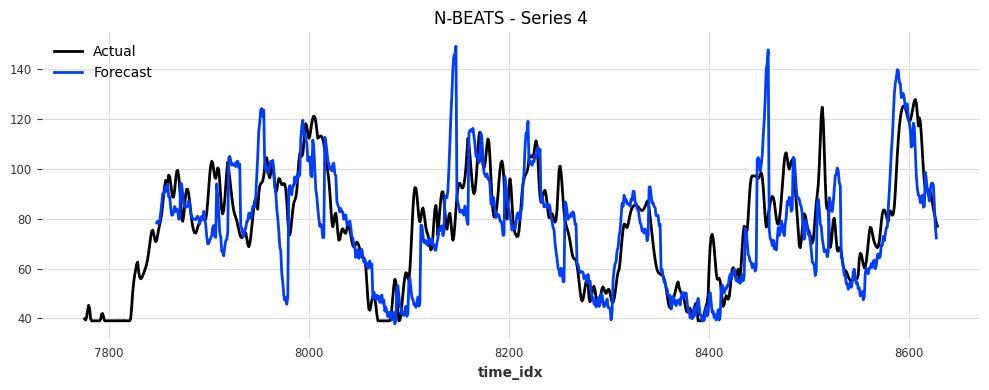

...

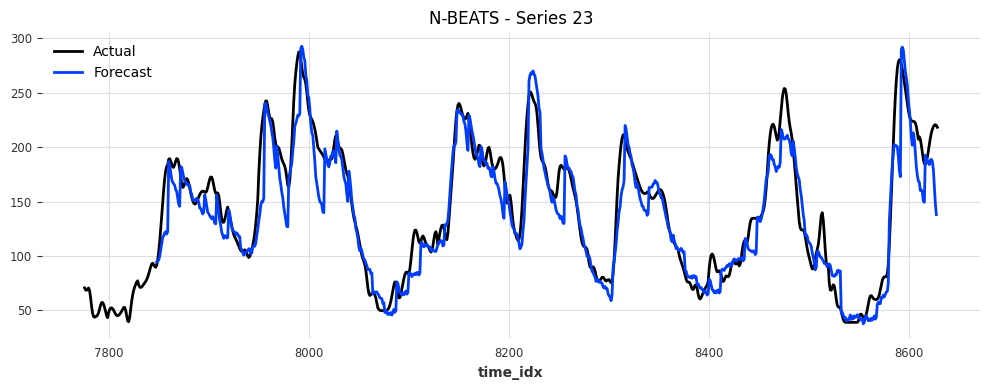

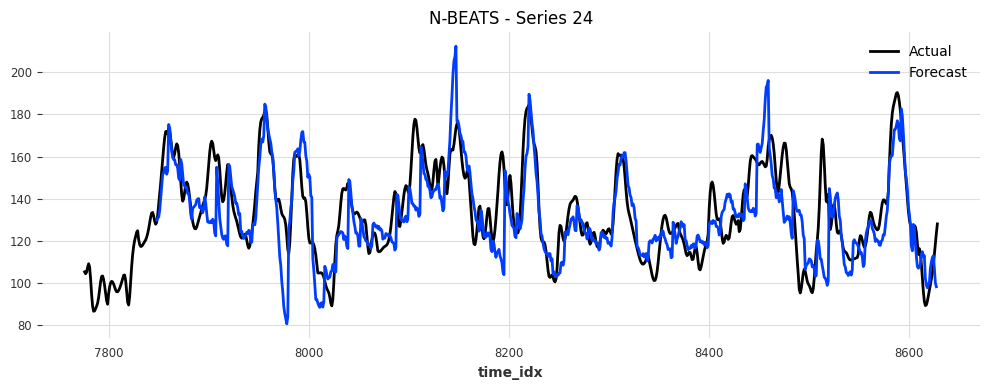

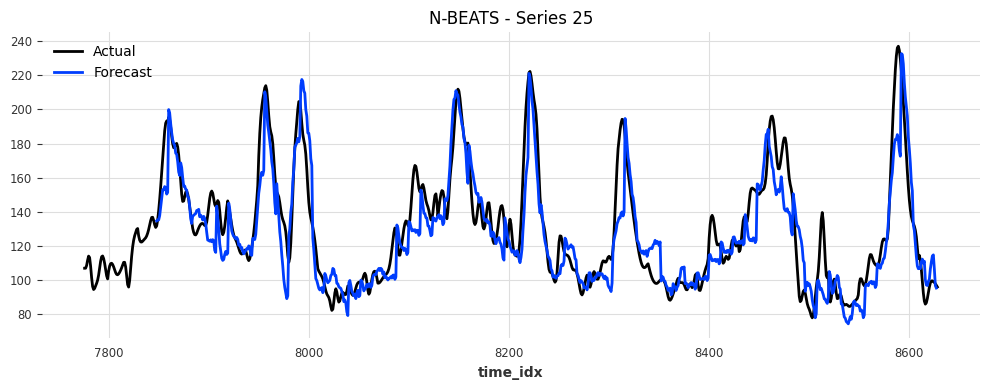

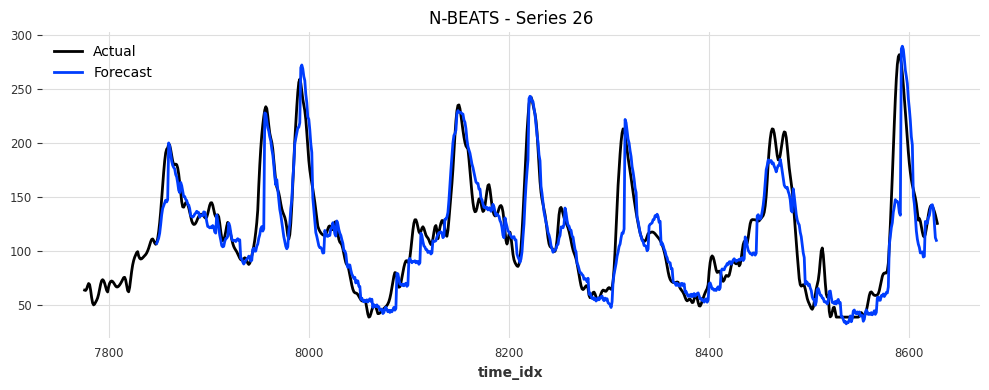

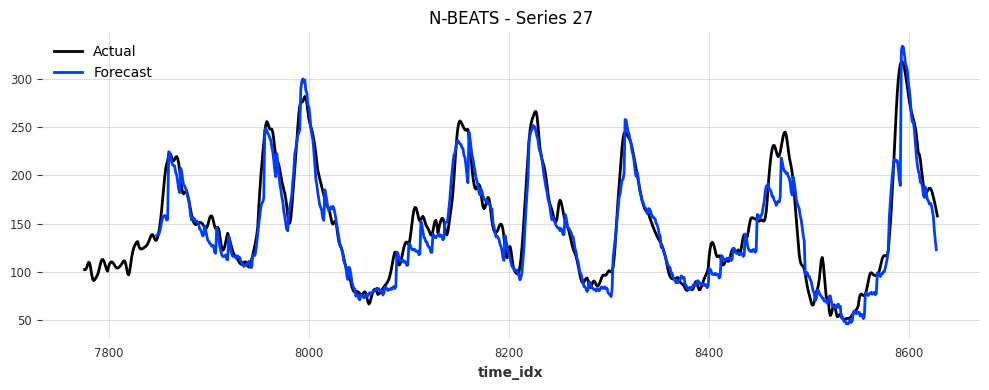


Clarke Error Grid for N-BEATS:
Zone A: 88.57%
Zone B: 10.72%
Zone C: 0.00%
Zone D: 0.71%
Zone E: 0.00%


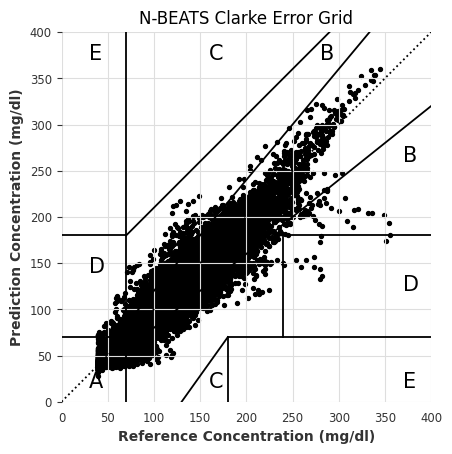

In [737]:
nbeats_maes, nbeats_rmses, nbeats_time, nbeats_zones = backtest_model(
    model=nbeats_model,
    model_name="N-BEATS",
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    scaler=target_scaler,
    last_points_only=False,
    retrain=False
)

## LSTM

Predicting: |                                                                                                 …

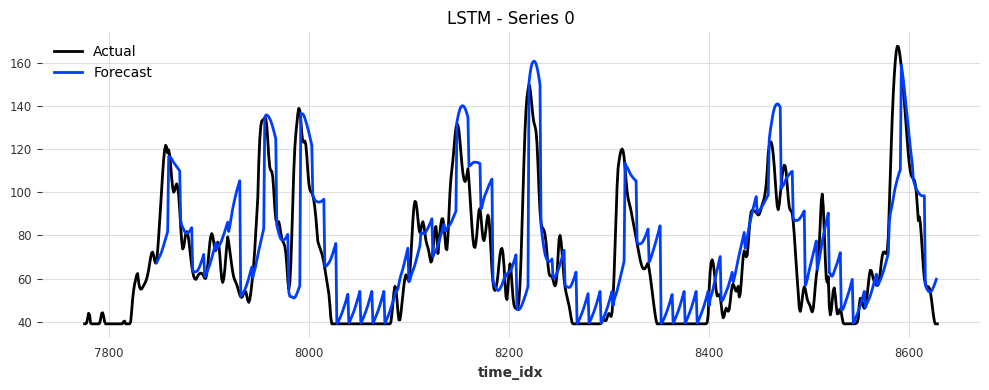

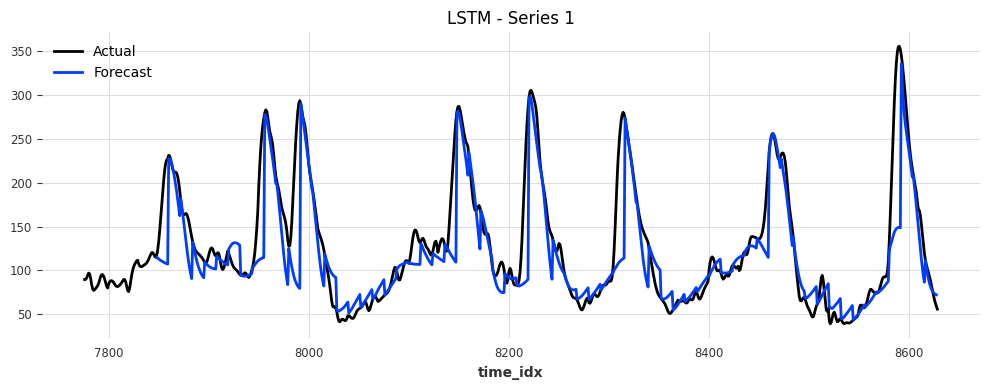

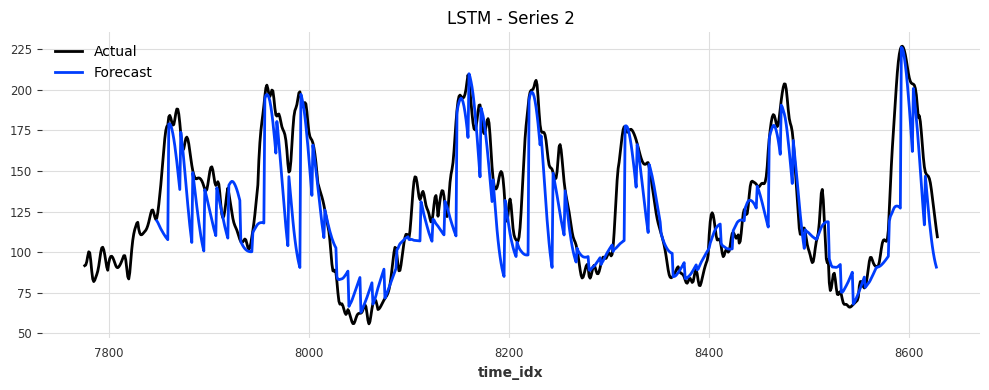

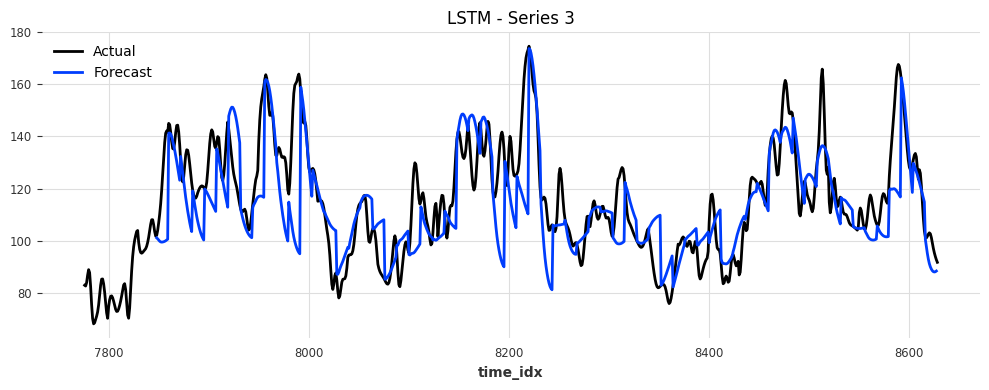

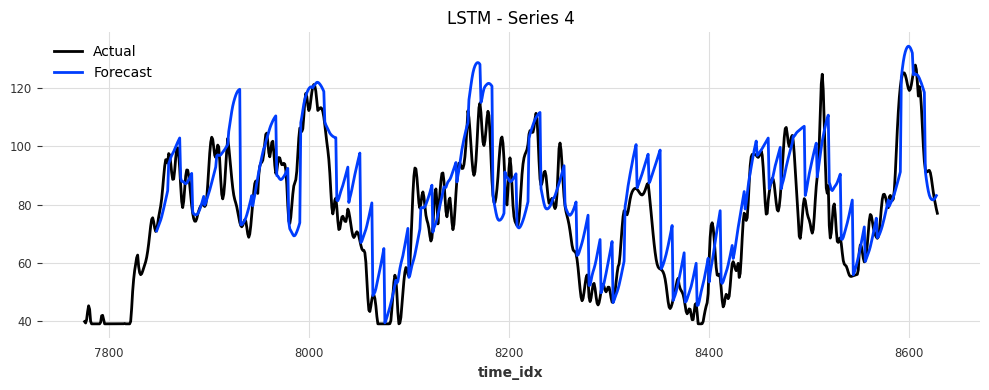

...

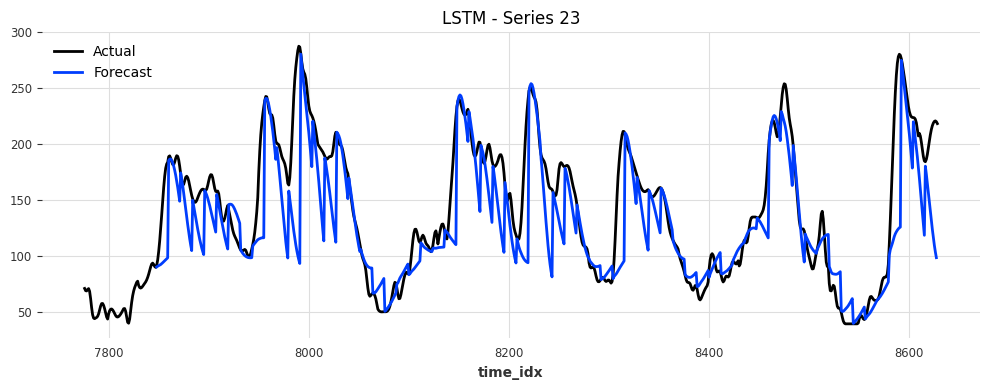

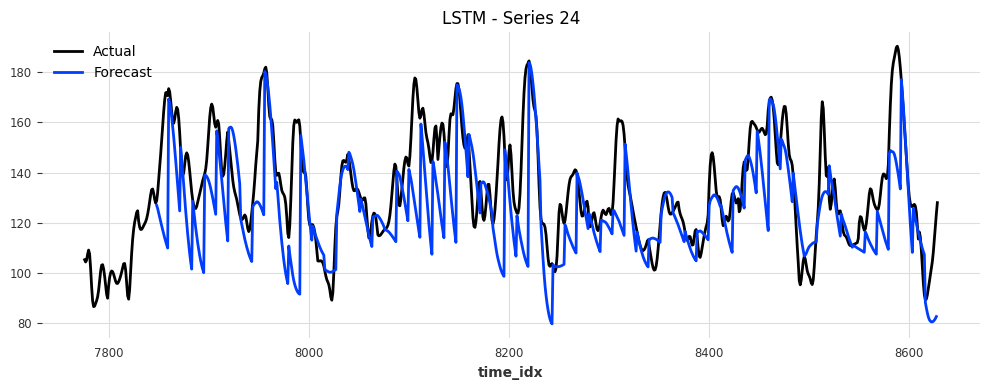

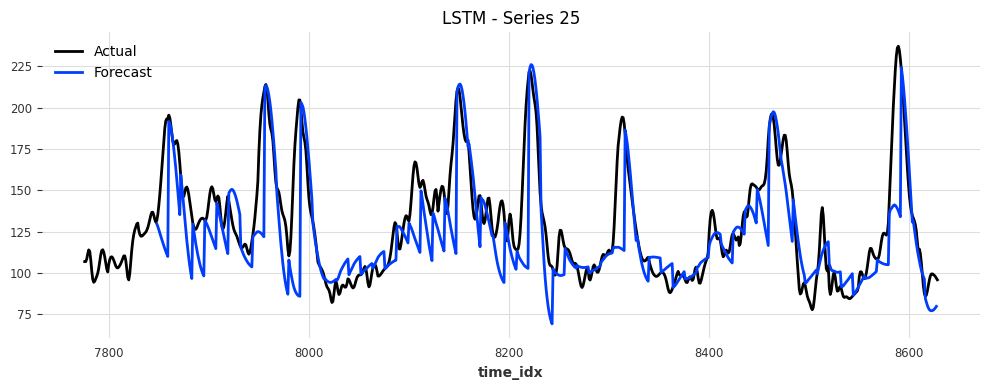

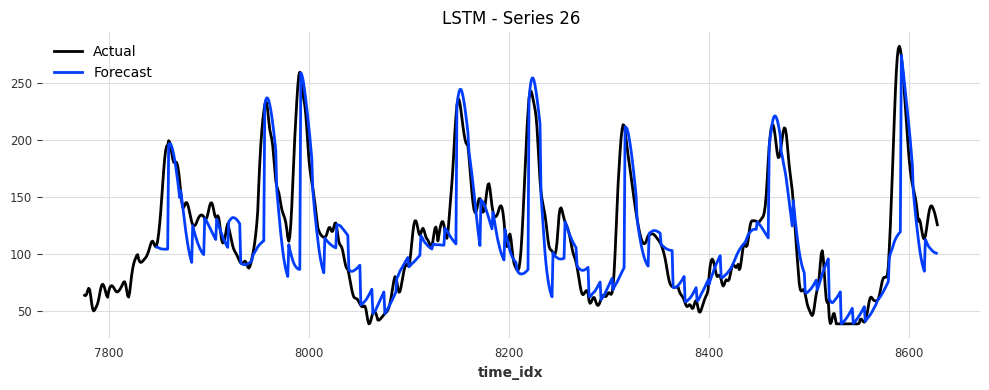

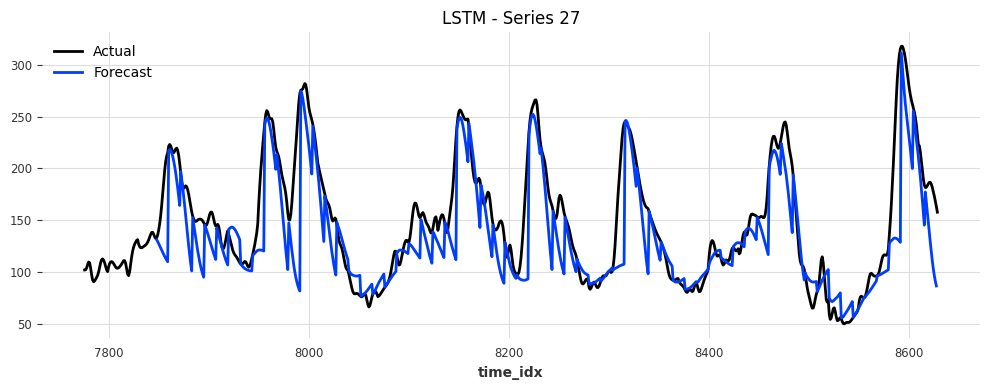


Clarke Error Grid for LSTM:
Zone A: 81.43%
Zone B: 15.40%
Zone C: 0.00%
Zone D: 3.14%
Zone E: 0.03%


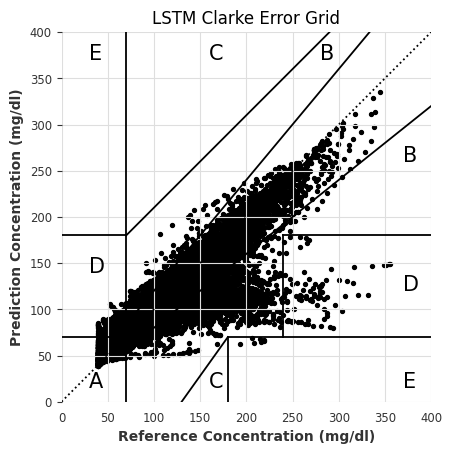

In [750]:
lstm_maes, lstm_rmses, lstm_time, lstm_zones = backtest_model(
    model=lstm,
    model_name="LSTM",
    val_series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    scaler=target_scaler,
    last_points_only=False,
    retrain=False
)

## Plotting Models

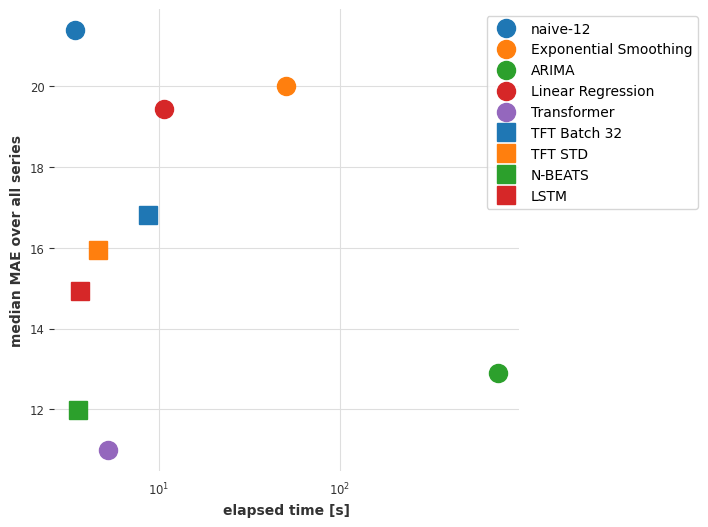

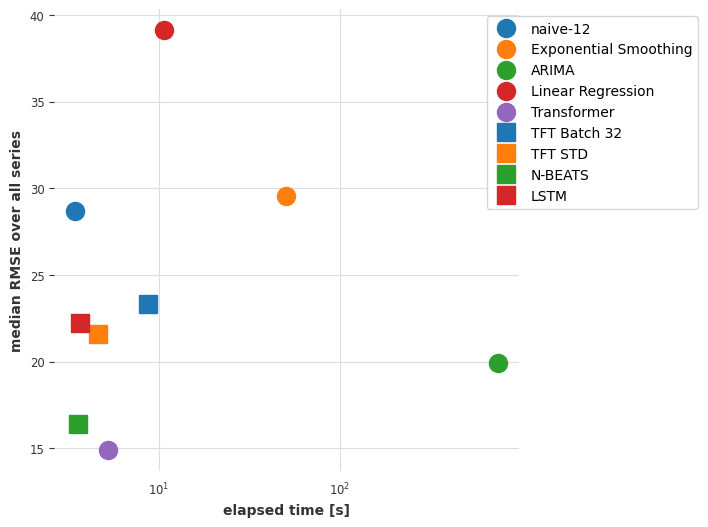

In [752]:
maes = {
    "naive-12": naive12_maes,
    "Exponential Smoothing": exp_maes,
    "ARIMA": arima_maes,
    "Linear Regression": lr_maes,
    "Transformer": ts_maes,
    "TFT Batch 32": tft_32_maes,
    "TFT STD": tft_std_maes,
    "N-BEATS": nbeats_maes,
    "LSTM": lstm_maes,
  
}
rmses = {
    "naive-12": naive12_rmses,
    "Exponential Smoothing": exp_rmses,
    "ARIMA": arima_rmses,
    "Linear Regression": lr_rmses,
    "Transformer": ts_rmses,
    "TFT Batch 32": tft_32_rmses,
    "TFT STD": tft_std_rmses,
    "N-BEATS": nbeats_rmses,
    "LSTM": lstm_rmses,
 
}

elapsed_times = {
    "naive-12": naive12_time,
    "Exponential Smoothing": exp_time,
    "ARIMA": arima_time,
    "Linear Regression": lr_time,
    "Transformer": ts_time,
    "TFT Batch 32": tft_32_time,
    "TFT STD": tft_std_time,
    "N-BEATS": nbeats_time,
    "LSTM": lstm_time,
}

plot_models(elapsed_times, maes, "MAE")
plot_models(elapsed_times, rmses, "RMSE")

### TFT32 tuned

Predicting: |                                                                                                 …

Predicting: |                                                                                                 …

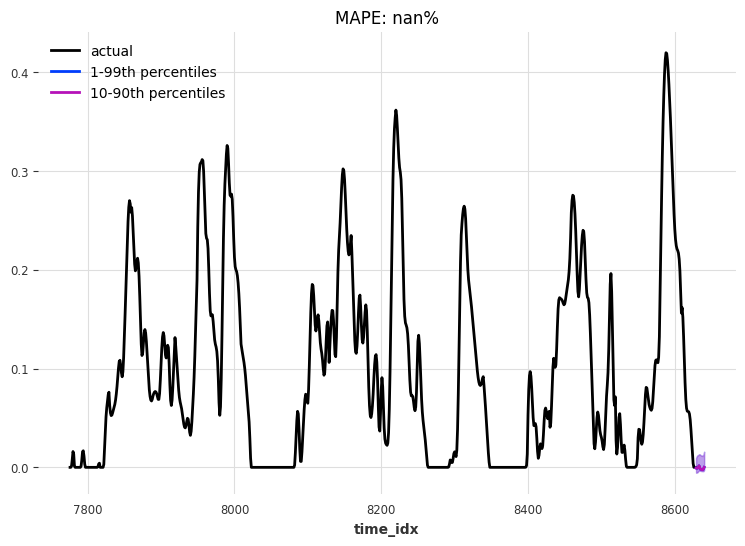

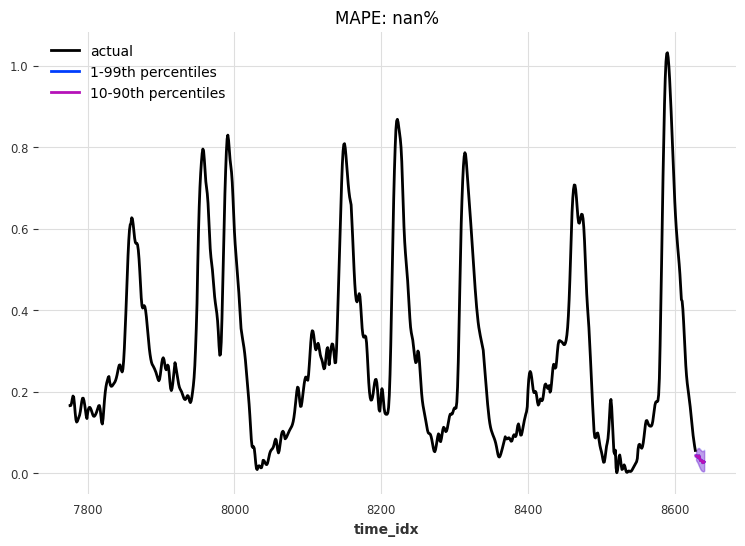

In [683]:
def eval_model(model, n, actual_series, val_series, past_covariates, future_covariates):
    pred_series = model.predict(
        n=n, 
        series=val_series,
        num_samples=num_samples,
        past_covariates=past_covariates,
        future_covariates=future_covariates
    )

    # plot actual series
    plt.figure(figsize=figsize)
    val_series[: pred_series.end_time()].plot(label="actual")

    # plot prediction with quantile ranges
    pred_series.plot(
        low_quantile=lowest_q, high_quantile=highest_q, label=label_q_outer
    )
    pred_series.plot(low_quantile=low_q, high_quantile=high_q, label=label_q_inner)

    plt.title(f"MAPE: {mape(val_series, pred_series):.2f}%")
    plt.legend()


num_samples=200
figsize = (9, 6)
lowest_q, low_q, high_q, highest_q = 0.01, 0.1, 0.9, 0.99
label_q_outer = f"{int(lowest_q * 100)}-{int(highest_q * 100)}th percentiles"
label_q_inner = f"{int(low_q * 100)}-{int(high_q * 100)}th percentiles"
for i in range(2):
    eval_model(tft_32, 12, cgm_train_transformed[i], cgm_val_transformed[i], past_covariates_transformed_val[i], future_covariates_transformed_val[i])

Predicting: |                                                                                                 …

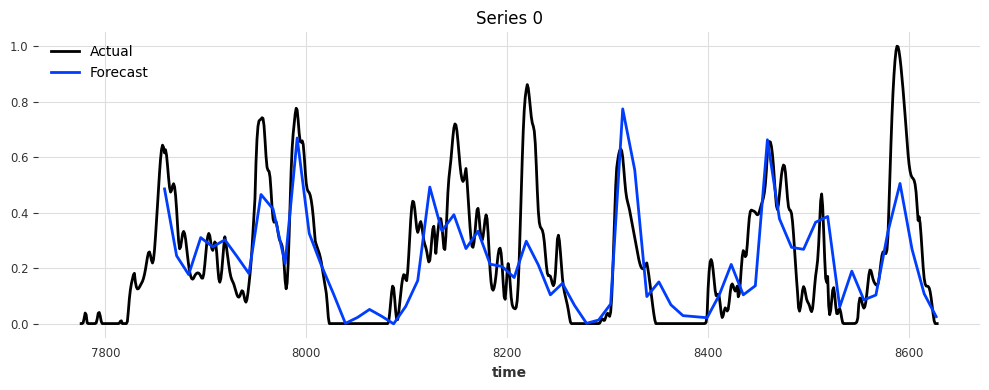

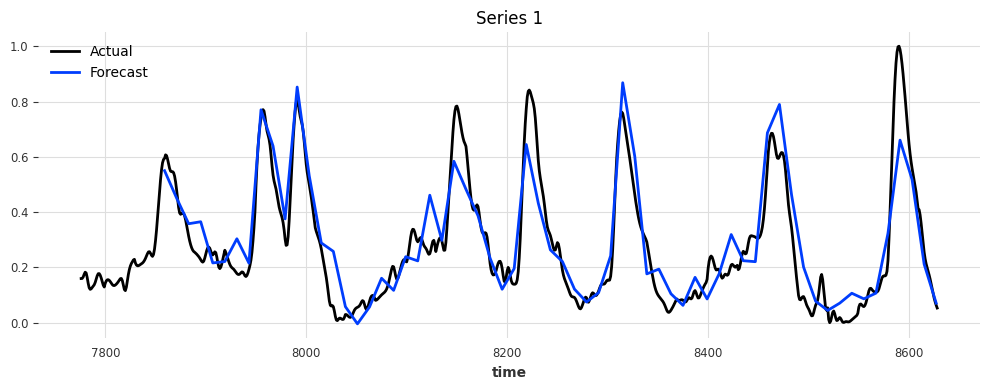

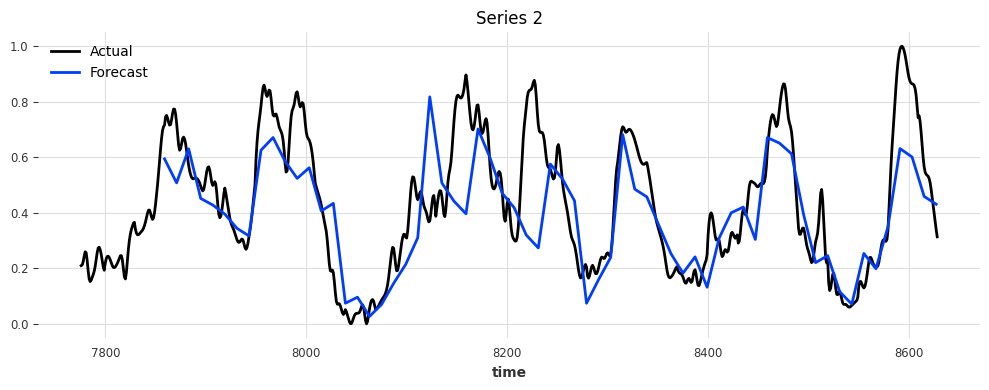

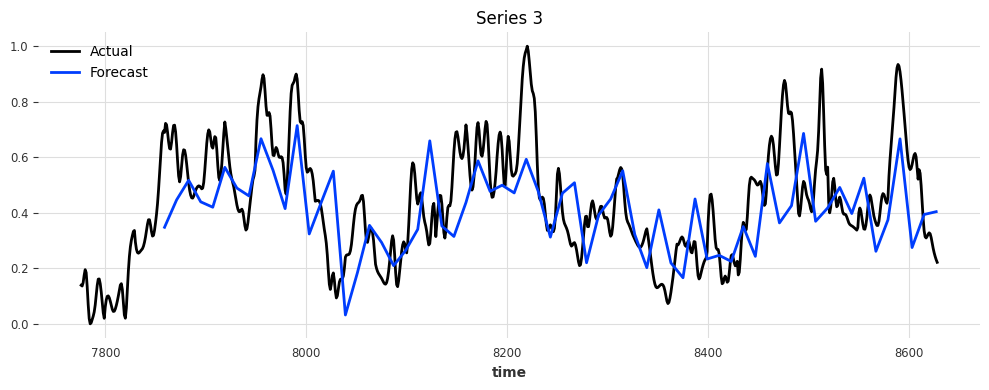

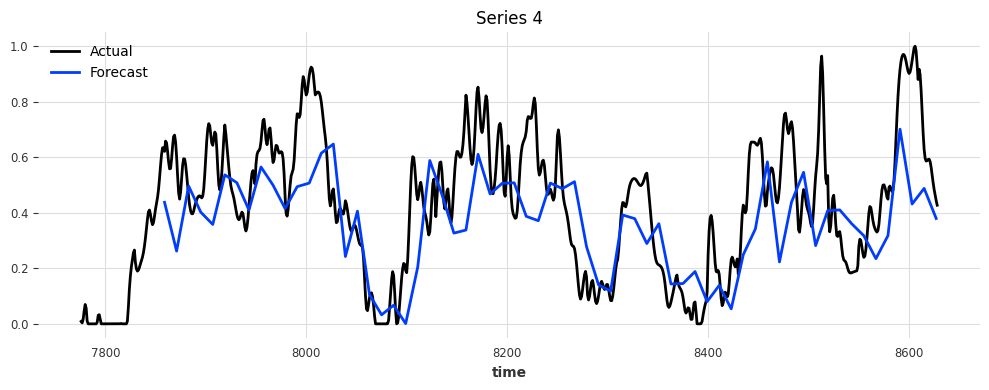

...

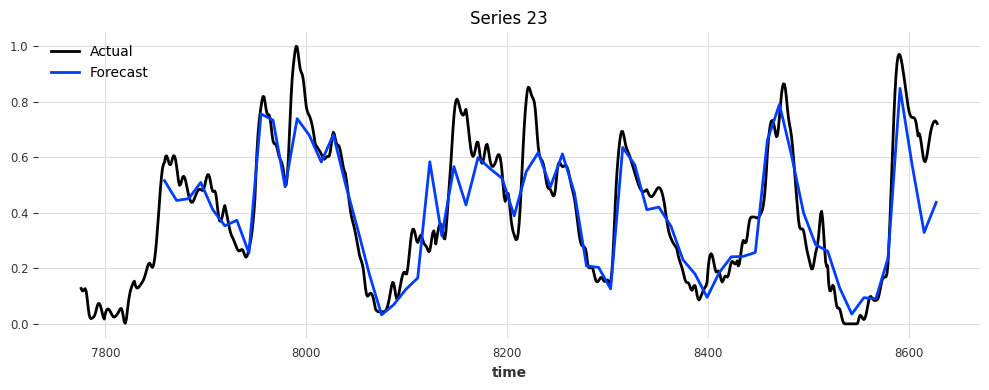

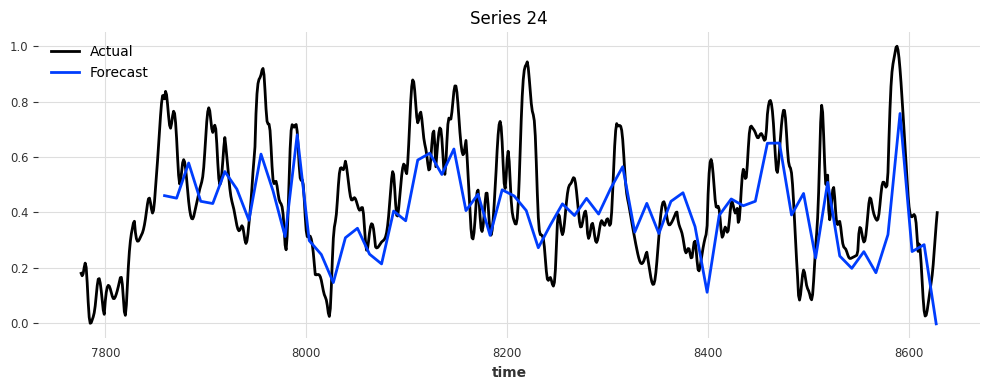

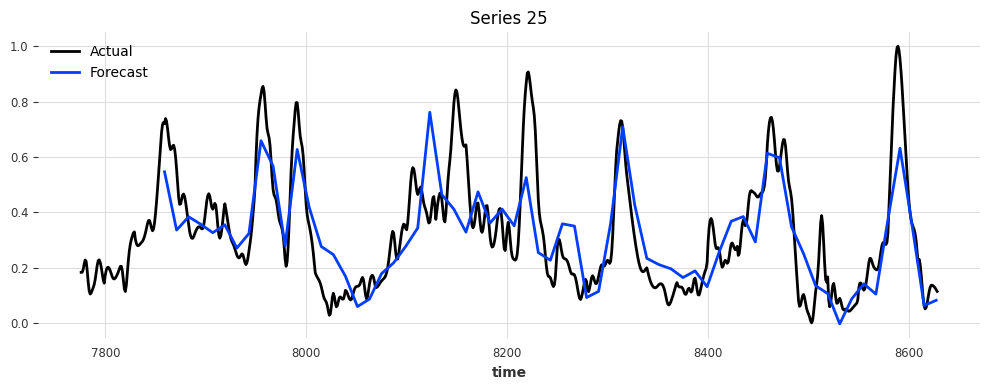

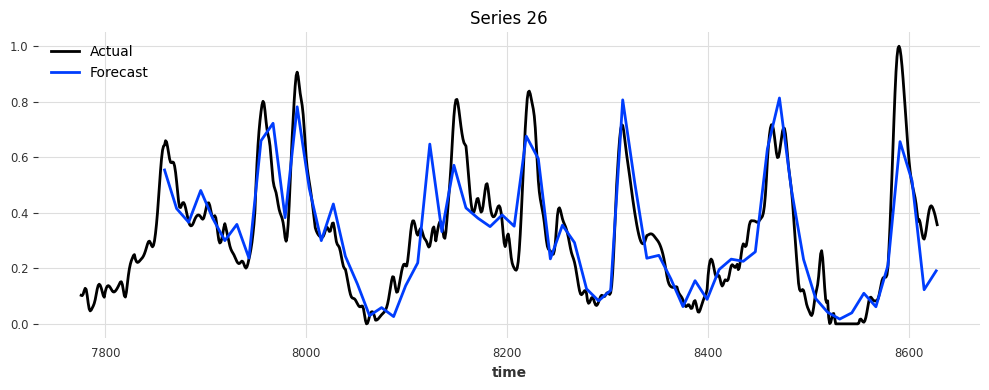

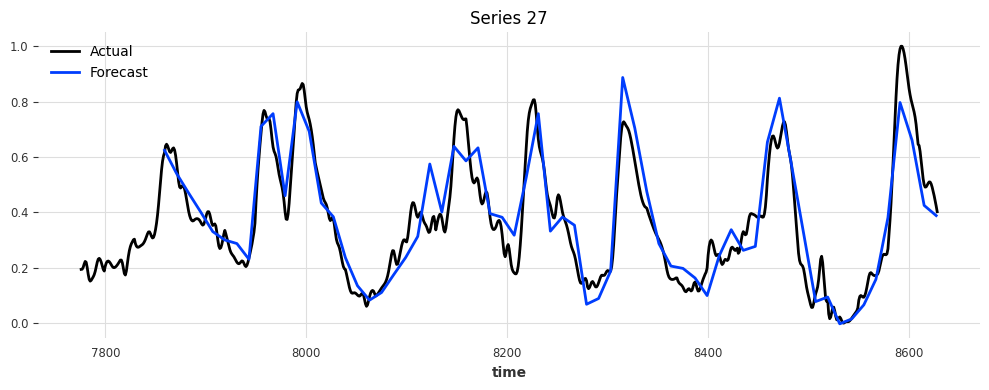

average mae: 15.8812
average rmse: 20.9155
total time: 7.43 seconds


In [320]:
start_time = time.time()
tft_32_forecasts = tft_32.historical_forecasts(
    series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_val,
    start=0,
    forecast_horizon=12,
    stride=12,
    retrain=False,
    verbose=True,
)
tft_32_time = time.time() - start_time

plot_dir = "temporal_fusion32_plots"
os.makedirs(plot_dir, exist_ok=True)

tft_32_time = time.time() - start_time
all_maes = []
all_rmses = []

for i in range(28):
    plt.figure(figsize=(10, 4))
    cgm_val_transformed[i].plot(label="Actual")
    tft_32_forecasts[i].plot(label="Forecast")
    plt.title(f"Series {i}")
    plt.legend()
    plt.tight_layout()
    
    save_path = os.path.join(plot_dir, f"temporal_fusion_32_plot_{i}.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    plt.show()
    
    combined_preds = concatenate(tft_32_forecasts[i], axis=0)
    ground_truth = cgm_val_transformed[i].slice_intersect(combined_preds)
    unscaled_pred = target_scaler.inverse_transform(combined_preds)
    unscaled_actual = target_scaler.inverse_transform(ground_truth)
    all_maes.append(mae(unscaled_actual, unscaled_pred))
    all_rmses.append(rmse(unscaled_actual, unscaled_pred))

print(f"average mae: {np.mean(all_maes):.4f}")
print(f"average rmse: {np.mean(all_rmses):.4f}")
print(f"total time: {tft_32_time:.2f} seconds")

with open(os.path.join(plot_dir, "temporal_fusion_metrics.txt"), "w") as f:
    f.write(f"Average MAE: {np.mean(all_maes):.4f}\n")
    f.write(f"Average RMSE: {np.mean(all_rmses):.4f}\n")
    f.write(f"Total time: {tft_32_time:.2f} seconds\n")
    f.write("\nDetailed metrics:\n")
    for i, (mae_val, rmse_val) in enumerate(zip(all_maes, all_rmses)):
        f.write(f"Series {i}: MAE = {mae_val:.4f}, RMSE = {rmse_val:.4f}\n")

### TFT std

Predicting: |                                                                                                 …

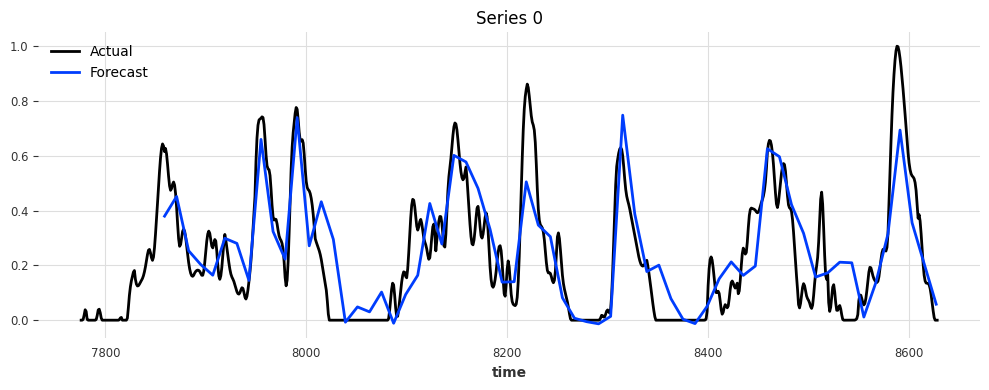

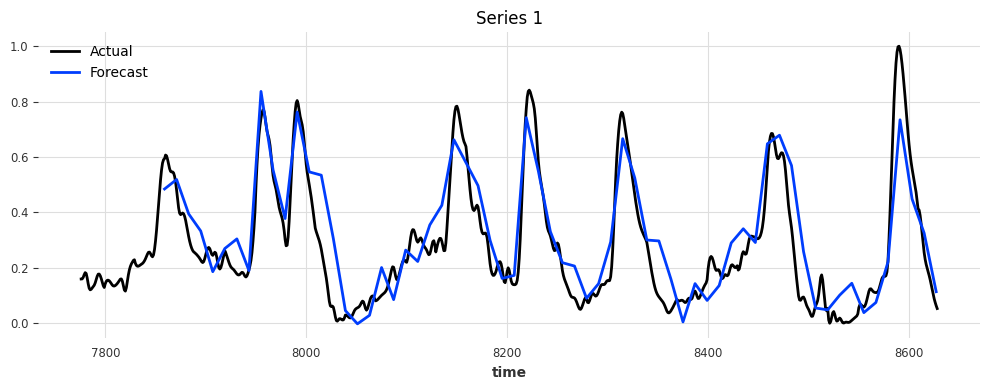

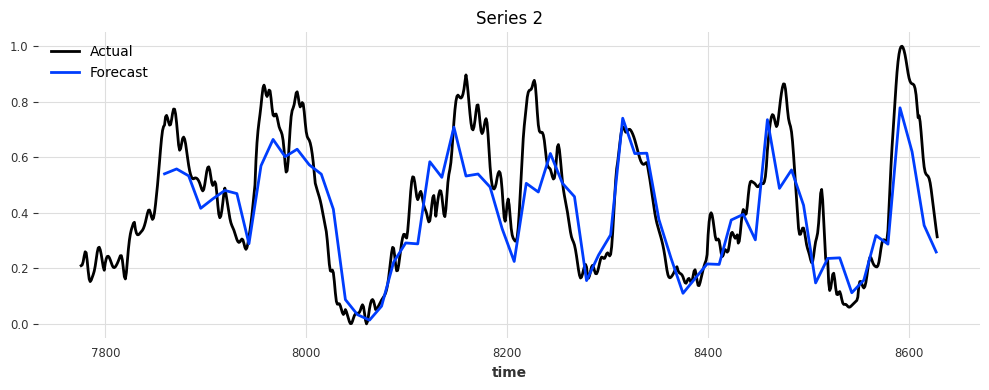

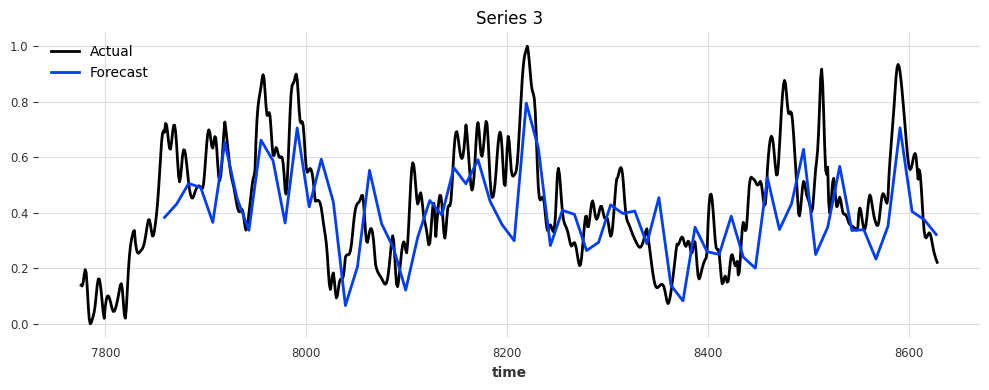

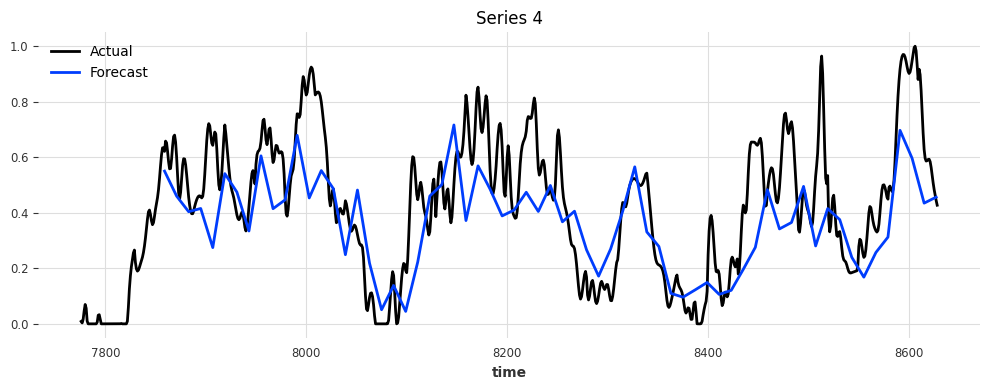

...

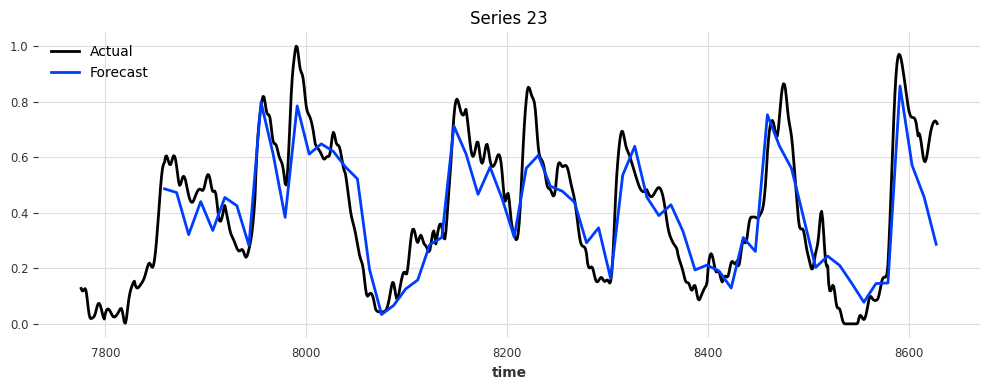

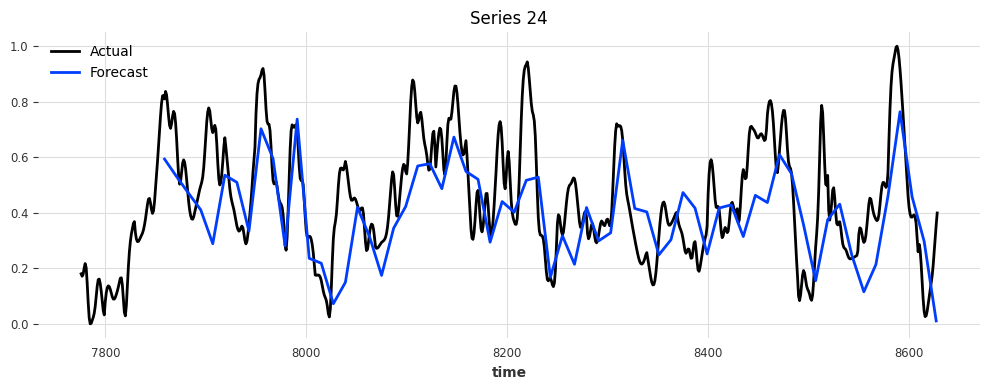

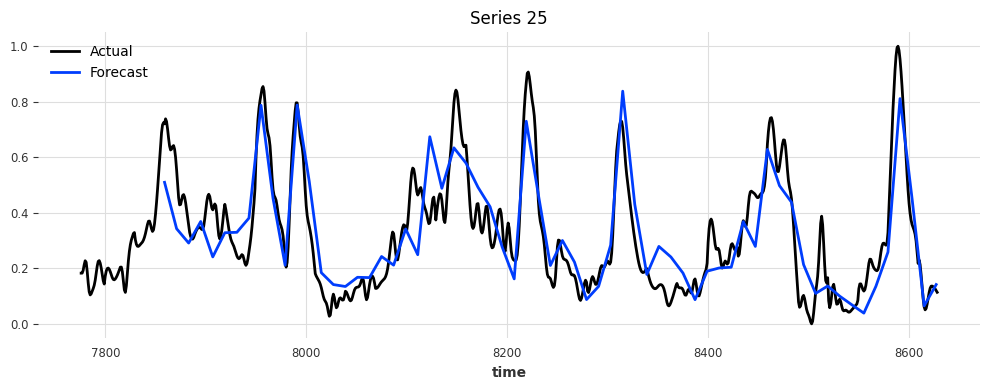

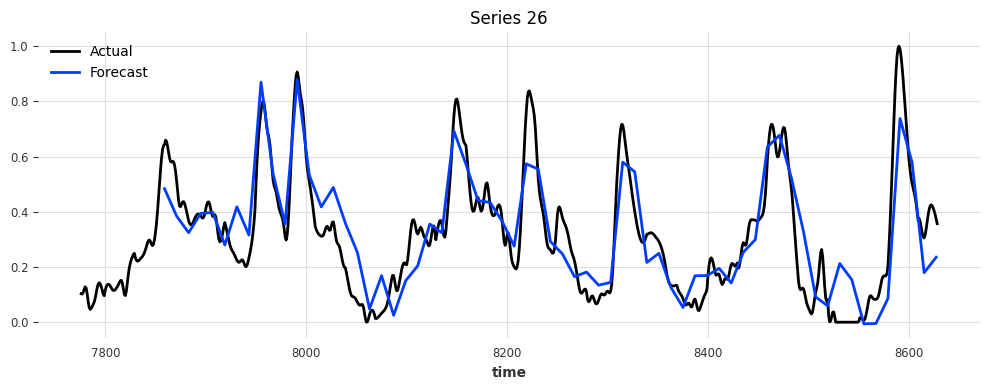

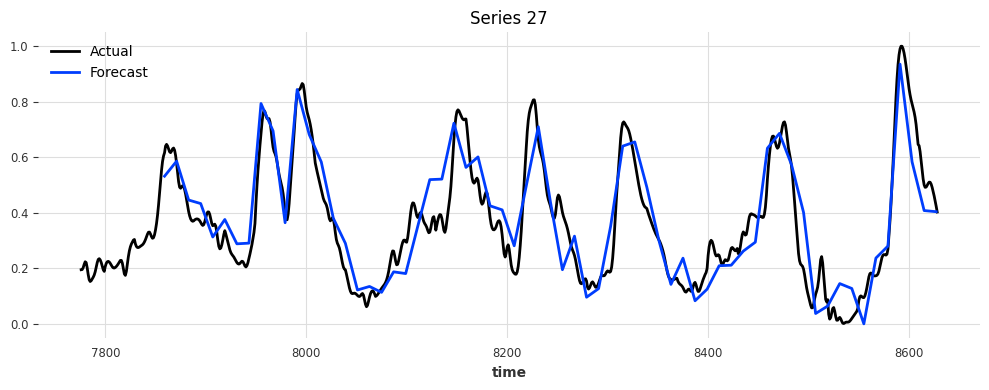

average mae: 15.6783
average rmse: 19.7464
total time: 5.09 seconds


In [321]:
start_time = time.time()
tft_std_forecasts = tft_std.historical_forecasts(
    series=cgm_val_transformed,
    past_covariates=past_covariates_transformed_val,
    future_covariates=future_covariates_transformed_val,
    start=0,
    forecast_horizon=12,
    stride=12,
    retrain=False,
    verbose=True,
)
tft_std_time = time.time() - start_time

plot_dir = "temporal_fusion32_plots"
os.makedirs(plot_dir, exist_ok=True)

tft_std_time = time.time() - start_time
all_maes = []
all_rmses = []

for i in range(28):
    plt.figure(figsize=(10, 4))
    cgm_val_transformed[i].plot(label="Actual")
    tft_std_forecasts[i].plot(label="Forecast")
    plt.title(f"Series {i}")
    plt.legend()
    plt.tight_layout()
    
    save_path = os.path.join(plot_dir, f"temporal_fusion_std_plot_{i}.png")
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    plt.show()
    
    combined_preds = concatenate(tft_std_forecasts[i], axis=0)
    ground_truth = cgm_val_transformed[i].slice_intersect(combined_preds)
    unscaled_pred = target_scaler.inverse_transform(combined_preds)
    unscaled_actual = target_scaler.inverse_transform(ground_truth)
    all_maes.append(mae(unscaled_actual, unscaled_pred))
    all_rmses.append(rmse(unscaled_actual, unscaled_pred))

print(f"average mae: {np.mean(all_maes):.4f}")
print(f"average rmse: {np.mean(all_rmses):.4f}")
print(f"total time: {tft_std_time:.2f} seconds")

with open(os.path.join(plot_dir, "temporal_fusion_metrics.txt"), "w") as f:
    f.write(f"Average MAE: {np.mean(all_maes):.4f}\n")
    f.write(f"Average RMSE: {np.mean(all_rmses):.4f}\n")
    f.write(f"Total time: {tft_32_time:.2f} seconds\n")
    f.write("\nDetailed metrics:\n")
    for i, (mae_val, rmse_val) in enumerate(zip(all_maes, all_rmses)):
        f.write(f"Series {i}: MAE = {mae_val:.4f}, RMSE = {rmse_val:.4f}\n")

# OPTUNA

In [17]:
import optuna
from darts.models import TFTModel
from darts.metrics import mae
from pytorch_lightning.callbacks import EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from darts.utils.likelihood_models import QuantileRegression

import os
import datetime


def objective(trial):
    input_chunk_length = 72
    forecast_horizon = 12
    quantiles = [0.1, 0.5, 0.9]

    print(f"\n--- Starting Trial #{trial.number} ---")

    # Hyperparameter search space
    hidden_size = trial.suggest_int("hidden_size", 32, 128)
    lstm_layers = trial.suggest_int("lstm_layers", 1, 2)
    num_attention_heads = trial.suggest_int("num_attention_heads", 1, 2)
    dropout = trial.suggest_float("dropout", 0.1, 0.3)
    batch_size = trial.suggest_categorical("batch_size", [512, 1024])
    learning_rate = trial.suggest_float("learning_rate", 1e-4, 1e-2, log=True)
    add_relative_index = trial.suggest_categorical("add_relative_index", [True, False])

    print("Hyperparameters:")
    print(f"  hidden_size: {hidden_size}")
    print(f"  lstm_layers: {lstm_layers}")
    print(f"  num_attention_heads: {num_attention_heads}")
    print(f"  dropout: {dropout}")
    print(f"  batch_size: {batch_size}")
    print(f"  learning_rate: {learning_rate}")
    print(f"  add_relative_index: {add_relative_index}")

    # Create a unique logger directory for each trial
    log_dir = os.path.join("tb_logs", f"trial_{trial.number}")
    logger = TensorBoardLogger(save_dir=log_dir, name="TFTModel")

    early_stopping = EarlyStopping(
        monitor="val_loss",
        patience=3,
        min_delta=0.001,
        mode="min",
        verbose=True,
    )

    model = TFTModel(
        input_chunk_length=input_chunk_length,
        output_chunk_length=forecast_horizon,
        hidden_size=hidden_size,
        lstm_layers=lstm_layers,
        num_attention_heads=num_attention_heads,
        dropout=dropout,
        batch_size=batch_size,
        n_epochs=10,
        add_relative_index=add_relative_index,
        add_encoders=None,
        optimizer_kwargs={"lr": learning_rate},
        likelihood=QuantileRegression(quantiles=quantiles),
        pl_trainer_kwargs={
            "enable_model_summary": True,
            "callbacks": [early_stopping],
            "logger": logger,
            "log_every_n_steps": 1,
        },
        random_state=42,
    )

    try:
        print("→ Fitting model...")
        model.fit(
            series=cgm_train_transformed,
            val_series=cgm_val_transformed,
            past_covariates=past_covariates_transformed_train,
            val_past_covariates=past_covariates_transformed_val,
            future_covariates=future_covariates_transformed_train,
            val_future_covariates=future_covariates_transformed_val,
            dataloader_kwargs={"num_workers": 4},
            verbose=True
        )

        print("→ Predicting...")
        predictions = model.predict(
            n=forecast_horizon,
            series=cgm_val_transformed,
            past_covariates=past_covariates_transformed_val,
            future_covariates=future_covariates_transformed_val
        )

        error = mae(cgm_val_transformed, predictions)
        if isinstance(error, list):
            error = sum(error) / len(error)

        print(f"✅ Trial {trial.number} completed. MAE: {error:.4f}")
        return error

    except Exception as e:
        print(f"⚠️ Trial #{trial.number} failed: {e}")
        return float('inf')


In [52]:
study = optuna.create_study(
    direction="minimize",
    pruner=optuna.pruners.SuccessiveHalvingPruner(),
)
study.optimize(objective, n_trials=50)

print("\n✅ Best trial:")
best = study.best_trial
print(f"  Value (MAE): {best.value}")
print("  Params:")
for key, value in best.params.items():
    print(f"    {key}: {value}")



--- Starting Trial #0 ---
Hyperparameters:
  hidden_size: 82
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.17560583163786342
  batch_size: 1024
  learning_rate: 0.0002534711174244557
  add_relative_index: True
→ Fitting model...


2025-04-09 19:36:24.666987: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-09 19:36:24.873682: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1744216584.998226   14049 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1744216585.052825   14049 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1744216585.309088   14049 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 0 completed. MAE: nan

--- Starting Trial #1 ---
Hyperparameters:
  hidden_size: 116
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.2639688215125011
  batch_size: 512
  learning_rate: 0.0026879984993810674
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 1 completed. MAE: nan

--- Starting Trial #2 ---
Hyperparameters:
  hidden_size: 54
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.24677486617193903
  batch_size: 512
  learning_rate: 0.0002145118841972759
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 2 completed. MAE: nan

--- Starting Trial #3 ---
Hyperparameters:
  hidden_size: 88
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.24565480167623832
  batch_size: 512
  learning_rate: 0.0002536460739283809
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 3 completed. MAE: nan

--- Starting Trial #4 ---
Hyperparameters:
  hidden_size: 122
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.2820882314581004
  batch_size: 512
  learning_rate: 0.0005739920891470351
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 4 completed. MAE: nan

--- Starting Trial #5 ---
Hyperparameters:
  hidden_size: 119
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.23310745920680712
  batch_size: 512
  learning_rate: 0.0002684671988513788
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 5 completed. MAE: nan

--- Starting Trial #6 ---
Hyperparameters:
  hidden_size: 67
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.27271303242630107
  batch_size: 1024
  learning_rate: 0.0014709215764347736
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 6 completed. MAE: nan

--- Starting Trial #7 ---
Hyperparameters:
  hidden_size: 85
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.24070710883598959
  batch_size: 1024
  learning_rate: 0.0026642219765205415
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 7 completed. MAE: nan

--- Starting Trial #8 ---
Hyperparameters:
  hidden_size: 63
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.2125694631728988
  batch_size: 1024
  learning_rate: 0.0007256588746310148
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 8 completed. MAE: nan

--- Starting Trial #9 ---
Hyperparameters:
  hidden_size: 90
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.2628223909677994
  batch_size: 1024
  learning_rate: 0.0001863542008861437
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 9 completed. MAE: nan

--- Starting Trial #10 ---
Hyperparameters:
  hidden_size: 81
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.17628354535106414
  batch_size: 1024
  learning_rate: 0.0007646662252815174
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 10 completed. MAE: nan

--- Starting Trial #11 ---
Hyperparameters:
  hidden_size: 105
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.11325300158184387
  batch_size: 512
  learning_rate: 0.0006508479238550525
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 11 completed. MAE: nan

--- Starting Trial #12 ---
Hyperparameters:
  hidden_size: 66
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.26675300879721153
  batch_size: 512
  learning_rate: 0.003465856720950874
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 12 completed. MAE: nan

--- Starting Trial #13 ---
Hyperparameters:
  hidden_size: 78
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.21076374448609755
  batch_size: 1024
  learning_rate: 0.0004206659287425185
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 13 completed. MAE: nan

--- Starting Trial #14 ---
Hyperparameters:
  hidden_size: 53
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.27753440720110967
  batch_size: 512
  learning_rate: 0.008640482725078308
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 14 completed. MAE: nan

--- Starting Trial #15 ---
Hyperparameters:
  hidden_size: 78
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.17754163910015014
  batch_size: 1024
  learning_rate: 0.0003776151063475649
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 15 completed. MAE: nan

--- Starting Trial #16 ---
Hyperparameters:
  hidden_size: 81
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.14720324232799462
  batch_size: 512
  learning_rate: 0.00014470701798269007
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 16 completed. MAE: nan

--- Starting Trial #17 ---
Hyperparameters:
  hidden_size: 58
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.23164081597228336
  batch_size: 512
  learning_rate: 0.0008502821721489412
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 17 completed. MAE: nan

--- Starting Trial #18 ---
Hyperparameters:
  hidden_size: 68
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.29656024103381695
  batch_size: 512
  learning_rate: 0.0009694585766138223
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 18 completed. MAE: nan

--- Starting Trial #19 ---
Hyperparameters:
  hidden_size: 86
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.15816054025187296
  batch_size: 512
  learning_rate: 0.00020750868461315931
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 19 completed. MAE: nan

--- Starting Trial #20 ---
Hyperparameters:
  hidden_size: 100
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.28203031178930527
  batch_size: 1024
  learning_rate: 0.00022145252897631457
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 20 completed. MAE: nan

--- Starting Trial #21 ---
Hyperparameters:
  hidden_size: 56
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.21389037090448734
  batch_size: 1024
  learning_rate: 0.0031239980428671306
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 21 completed. MAE: nan

--- Starting Trial #22 ---
Hyperparameters:
  hidden_size: 104
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.12866654336118535
  batch_size: 1024
  learning_rate: 0.00021705042901566942
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 22 completed. MAE: nan

--- Starting Trial #23 ---
Hyperparameters:
  hidden_size: 92
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.28351174054657835
  batch_size: 512
  learning_rate: 0.0018621520817064853
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 23 completed. MAE: nan

--- Starting Trial #24 ---
Hyperparameters:
  hidden_size: 47
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.19025386678595813
  batch_size: 512
  learning_rate: 0.0010911347613512163
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 24 completed. MAE: nan

--- Starting Trial #25 ---
Hyperparameters:
  hidden_size: 127
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.24016733932107648
  batch_size: 512
  learning_rate: 0.0008301863880087777
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 25 completed. MAE: nan

--- Starting Trial #26 ---
Hyperparameters:
  hidden_size: 81
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.1460020096776144
  batch_size: 1024
  learning_rate: 0.0016844102479648434
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 26 completed. MAE: nan

--- Starting Trial #27 ---
Hyperparameters:
  hidden_size: 91
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.2102905692988762
  batch_size: 1024
  learning_rate: 0.0007933829823605813
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 27 completed. MAE: nan

--- Starting Trial #28 ---
Hyperparameters:
  hidden_size: 102
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.1586748545419313
  batch_size: 512
  learning_rate: 0.00022902888014072044
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 28 completed. MAE: nan

--- Starting Trial #29 ---
Hyperparameters:
  hidden_size: 65
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.2133085209663903
  batch_size: 1024
  learning_rate: 0.007515294727008628
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 29 completed. MAE: nan

--- Starting Trial #30 ---
Hyperparameters:
  hidden_size: 39
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.2706665233592911
  batch_size: 1024
  learning_rate: 0.0006566163510866736
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 30 completed. MAE: nan

--- Starting Trial #31 ---
Hyperparameters:
  hidden_size: 76
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.11113493557588153
  batch_size: 1024
  learning_rate: 0.00017023940041792002
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 31 completed. MAE: nan

--- Starting Trial #32 ---
Hyperparameters:
  hidden_size: 125
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.2414107679058051
  batch_size: 512
  learning_rate: 0.00015603130386621154
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 32 completed. MAE: nan

--- Starting Trial #33 ---
Hyperparameters:
  hidden_size: 96
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.24924737074196796
  batch_size: 1024
  learning_rate: 0.0005894695185432887
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 33 completed. MAE: nan

--- Starting Trial #34 ---
Hyperparameters:
  hidden_size: 77
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.19578103043234035
  batch_size: 1024
  learning_rate: 0.00036673220194426143
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 34 completed. MAE: nan

--- Starting Trial #35 ---
Hyperparameters:
  hidden_size: 95
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.1793129654144462
  batch_size: 1024
  learning_rate: 0.009059489906153505
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 35 completed. MAE: nan

--- Starting Trial #36 ---
Hyperparameters:
  hidden_size: 37
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.2775830192908545
  batch_size: 512
  learning_rate: 0.002808910592143574
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 36 completed. MAE: nan

--- Starting Trial #37 ---
Hyperparameters:
  hidden_size: 87
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.16499053757536214
  batch_size: 1024
  learning_rate: 0.0008142416179188727
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 37 completed. MAE: nan

--- Starting Trial #38 ---
Hyperparameters:
  hidden_size: 104
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.13827649911561732
  batch_size: 1024
  learning_rate: 0.00019647148959523738
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 38 completed. MAE: nan

--- Starting Trial #39 ---
Hyperparameters:
  hidden_size: 56
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.25656788292911403
  batch_size: 512
  learning_rate: 0.0009152918537708466
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 39 completed. MAE: nan

--- Starting Trial #40 ---
Hyperparameters:
  hidden_size: 88
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.27120956363929194
  batch_size: 512
  learning_rate: 0.0012674420046392151
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 40 completed. MAE: nan

--- Starting Trial #41 ---
Hyperparameters:
  hidden_size: 100
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.127062278039958
  batch_size: 512
  learning_rate: 0.00018077498726366646
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 41 completed. MAE: nan

--- Starting Trial #42 ---
Hyperparameters:
  hidden_size: 102
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.25023633646496257
  batch_size: 1024
  learning_rate: 0.002094854274206146
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 42 completed. MAE: nan

--- Starting Trial #43 ---
Hyperparameters:
  hidden_size: 63
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.271452716354573
  batch_size: 512
  learning_rate: 0.006275423705520037
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 43 completed. MAE: nan

--- Starting Trial #44 ---
Hyperparameters:
  hidden_size: 89
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.21661818732566918
  batch_size: 512
  learning_rate: 0.0004593676462581323
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 44 completed. MAE: nan

--- Starting Trial #45 ---
Hyperparameters:
  hidden_size: 79
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.2553713749400272
  batch_size: 1024
  learning_rate: 0.00022681065068271987
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 45 completed. MAE: nan

--- Starting Trial #46 ---
Hyperparameters:
  hidden_size: 75
  lstm_layers: 2
  num_attention_heads: 1
  dropout: 0.19417785707162816
  batch_size: 1024
  learning_rate: 0.009848287463489029
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 46 completed. MAE: nan

--- Starting Trial #47 ---
Hyperparameters:
  hidden_size: 112
  lstm_layers: 1
  num_attention_heads: 2
  dropout: 0.2555080252009492
  batch_size: 1024
  learning_rate: 0.007407358970191655
  add_relative_index: True
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 47 completed. MAE: nan

--- Starting Trial #48 ---
Hyperparameters:
  hidden_size: 54
  lstm_layers: 1
  num_attention_heads: 1
  dropout: 0.12169990422663933
  batch_size: 512
  learning_rate: 0.0069949822066147005
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 48 completed. MAE: nan

--- Starting Trial #49 ---
Hyperparameters:
  hidden_size: 81
  lstm_layers: 2
  num_attention_heads: 2
  dropout: 0.2627948258623254
  batch_size: 1024
  learning_rate: 0.0008876195551004305
  add_relative_index: False
→ Fitting model...


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

→ Predicting...


Predicting: |                                                                                                 …

✅ Trial 49 completed. MAE: nan

✅ Best trial:


ValueError: No trials are completed yet.

In [54]:
import pickle

# Save
with open("tft_study.pkl", "wb") as f:
    pickle.dump(study, f)

# Load later
with open("tft_study.pkl", "rb") as f:
    study = pickle.load(f)